In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
from scipy.spatial import distance
from IPython.display import clear_output

In [44]:
import time

In [2]:
biomass_hist_df = pd.read_csv('Biomass_History.csv')
dist_mat_df = pd.read_csv('Distance_Matrix.csv')

In [3]:
biomass_hist_df = biomass_hist_df.drop(columns = ['Index'])
biomass_hist_df

,Latitude,Longitude,2010,2011,2012,2013,2014,2015,2016,2017
0,24.66818,71.33144,8.475744,8.868568,9.202181,6.023070,10.788374,6.647325,7.387925,5.180296
1,24.66818,71.41106,24.029778,28.551348,25.866415,21.634459,34.419411,27.361908,40.431847,42.126945
2,24.66818,71.49069,44.831635,66.111168,56.982258,53.003735,70.917908,42.517117,59.181629,73.203232
3,24.66818,71.57031,59.974419,80.821304,78.956543,63.160561,93.513924,70.203171,74.536720,101.067352
4,24.66818,71.64994,14.653370,19.327524,21.928144,17.899586,19.534035,19.165791,16.531315,26.086885
...,...,...,...,...,...,...,...,...,...,...
2413,20.15456,72.84432,5.199882,4.516778,4.321080,2.658953,5.113997,5.301668,6.419223,5.321604
2414,20.15456,72.92394,0.122287,0.126717,0.101494,0.111509,0.121749,0.122467,0.145785,0.120626
2415,20.15456,73.00357,0.039415,0.040843,0.032713,0.035941,0.039241,0.039473,0.046989,0.038879
2416,20.15456,73.08319,2.719220,1.370163,0.818687,1.205721,1.316443,1.324201,1.576338,1.304297


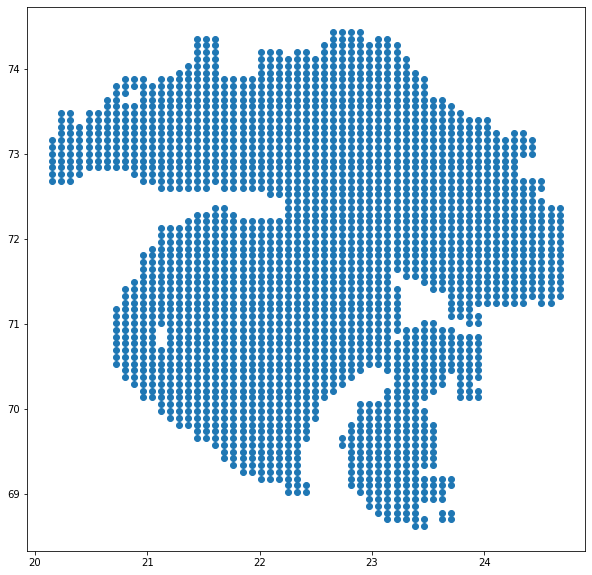

In [4]:
plt.figure(figsize=(10,10))
plt.scatter(biomass_hist_df['Latitude'], biomass_hist_df['Longitude'])

In [5]:
dist_mat_df = dist_mat_df.drop(columns=['Unnamed: 0'])
dist_mat_df

,0,1,2,3,4,5,6,7,8,9,...,2408,2409,2410,2411,2412,2413,2414,2415,2416,2417
0,0.0000,11.3769,20.4557,38.1227,45.3810,54.9915,78.6108,118.6750,102.6639,113.4309,...,683.8771,687.6310,697.3246,669.3962,667.6788,665.5775,662.0291,665.9655,673.2073,681.4235
1,11.3769,0.0000,9.0788,28.9141,36.1724,45.7829,69.4022,78.2329,93.4553,111.1832,...,681.6295,685.3833,695.0769,667.1485,665.4311,663.3298,659.7815,663.7178,670.9596,679.1758
2,20.4557,9.0788,0.0000,22.3791,29.6374,39.2478,62.8671,71.6979,86.9203,111.7859,...,682.2323,685.9861,695.6796,667.7513,666.0339,663.9326,660.3843,664.3206,671.5623,679.7786
3,38.1227,28.9141,22.3791,0.0000,11.8343,23.5413,41.8396,50.6703,65.8927,82.5852,...,681.4226,685.1765,694.8701,666.9417,665.2243,663.1230,659.5746,663.5110,670.7528,678.9690
4,45.3810,36.1724,29.6374,11.8343,0.0000,11.7070,24.3986,33.2293,53.9901,65.1442,...,663.9816,667.7355,677.4291,649.5007,647.7833,645.6820,642.1336,646.0700,653.3118,661.5280
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2413,671.2005,668.9528,669.5556,669.9084,652.1102,640.4032,627.7116,622.9663,638.9532,617.7221,...,109.0007,112.7545,122.4481,12.3091,9.1558,0.0000,14.5629,22.3860,36.6284,44.8446
2414,663.4455,661.1978,661.8006,662.1534,644.3551,632.6481,619.9566,615.2112,631.1981,609.9671,...,101.2456,104.9995,114.6931,26.4955,23.3422,14.1864,0.0000,14.5984,28.8407,37.0570
2415,663.7748,661.5271,662.1298,662.4826,644.6844,632.9774,620.2859,615.5405,631.5274,610.2964,...,84.1469,87.9008,97.5943,34.3098,31.1565,22.0007,12.8105,0.0000,14.2423,22.4586
2416,671.0165,668.7688,669.3715,669.7244,651.9261,640.2191,627.5276,622.7822,638.7691,617.5381,...,91.3886,95.1425,104.8361,48.5521,45.3988,36.2430,27.0528,14.2423,0.0000,12.4741


In [ ]:
biomass_2010 = biomass_hist_df[['Latitude', 'Longitude', '2010']].copy()
biomass_2010

In [ ]:
total_biomass_2010 = biomass_2010['2010'].sum()
threshold = total_biomass_2010 * (0.8)
biomass_2010 = biomass_2010.sort_values(by='2010', ascending=False)
biomass_2010

In [ ]:
biomass_2010['CumSum'] = biomass_2010['2010'].cumsum()
biomass_2010

In [ ]:
indices_to_keep = biomass_2010[biomass_2010['CumSum'] < threshold]
final_df_2010 = indices_to_keep.dropna()

In [ ]:
total_biomass_2010

In [ ]:
threshold

In [ ]:
final_df_2010

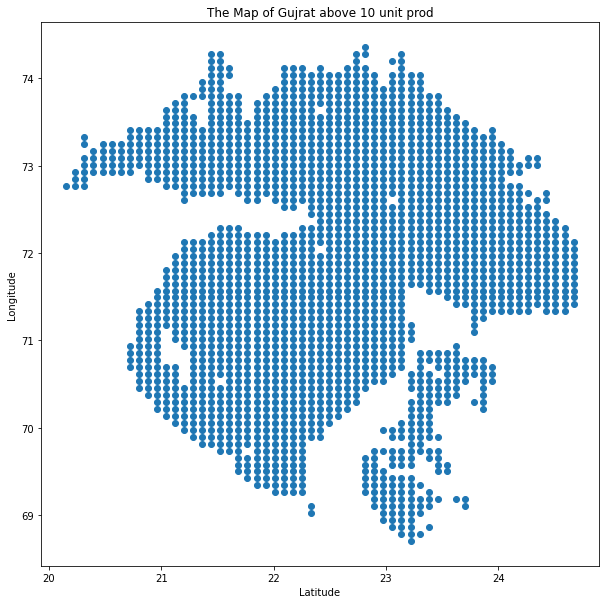

In [14]:
plt.figure(figsize=(10,10))
plt.scatter(df_2019['Latitude'], df_2019['Longitude'])#, s=final_df_2010['2010'])
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('The Map of Gujrat above 10 unit prod')
plt.show()

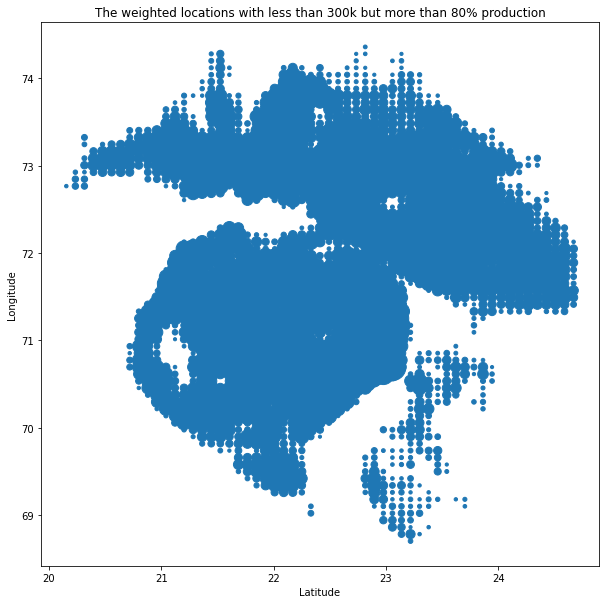

In [14]:
plt.figure(figsize=(10,10))
plt.scatter(df_2019['Latitude'], df_2019['Longitude'], s=df_2019['2019'])
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.title('The weighted locations with less than 300k but more than 80% production')
plt.show()

### Developing the clustering algorithm
<b>Steps :</b> <br>
    1) Randomly pick up n points <br>
    2) Assign all the points to the nearest centroid based on distance matrix <br>
    3) Update the centroid - Avg of the pts in each cluster grp (based on longitude and latitude) - find the most nearest pt from longitude, latitude list based on Euclidean distance. Get the index of that point and it is the new centroid <br>
    4) Repeat step 2-3 until centroids do not change <br>
    5) Make sure that each cluster is within the limit set

In [17]:
color_map = {
    0  : 'black',
    1  : 'blue',
    2  : 'green',
    3  : 'cyan',
    4  : 'magenta',
    5  : 'plum',
    6  : 'purple',
    7  : 'salmon',
    8  : 'tan',
    9  : 'teal',
    10 : 'violet',
    11 : 'wheat',
    12 : 'yellowgreen',
    13 : 'pink',
    14 : 'orchid',
    15 : 'olive',
    16 : 'maroon',
    17 : 'lime',
    18 : 'lightblue',
    19 : 'lavender',
    20 : 'khaki',
    21 : 'goldenrod',
    22 : 'fuchsia',
    23 : 'coral',
    24 : 'chocolate',
    25 : 'azure',
    26 : 'aquamarine',
    27 : 'lightgreen',
    28 : 'grey',
    29 : 'orange'
    
}

#### Determining the depot locations

In [18]:
# Assign all the points to the nearest centroid based on distance matrix
# The maximum priority should be given to heighest weight -> distance calculation = actual distance / weight
# each cluster can have a upper limit of weight
def assigning_cluster_id(upper_limit, dist_mat_df, final_df, initial_centers, year='2019', process_flag = 'depot'):
    index_number_initial = final_df.index.tolist()
    if process_flag == 'depot':
        other_centers = [x for x in index_number_initial if x not in initial_centers]
        index_number = initial_centers + other_centers
    else :
        index_number = index_number_initial
    cluster_dist_dict = dict()
    cluster_ids = []
    total_dist = 0
    for pt_idx in index_number:
        dist = [dist_mat_df.at[pt_idx, str(center)] for center in initial_centers]
        #print(f'The minimum distance is {min(dist)}')
        sorted_dist = sorted(dist)
        min_max_index = list(map(lambda x : dist.index(x), sorted_dist))
#         breakpoint()
        cluster_flag = 0
        if final_df.at[pt_idx,year] > 100 :
            max_opportunity = 5
        elif process_flag == 'refinery':
            max_opportunity = 3
        else:
            max_opportunity = 3
        for min_idx in min_max_index[:max_opportunity]:
            if min_idx not in cluster_dist_dict.keys():
                cluster_dist_dict[min_idx] = final_df.at[pt_idx,year]
                cluster_flag = 1
                break
            elif cluster_dist_dict[min_idx] + final_df.at[pt_idx,year] <= upper_limit:
                cluster_dist_dict[min_idx] += final_df.at[pt_idx,year]
                cluster_flag = 1
                break
            else:
                continue
        if cluster_flag == 1:
            cluster_ids.append(min_idx)
        elif cluster_flag == 0:
            cluster_ids.append(np.nan)
        above_threshold = any(value > upper_limit for value in cluster_dist_dict.values())
        if above_threshold:
            print('The clusters are diverging')
            break
        #print(f'The acceptable min distance is :{dist[min_idx]}')
        total_dist += dist[min_idx]
    # update the centroid
    if process_flag == 'depot':
        final_df = final_df.reindex(index=index_number)
    final_df['cluster_id'] = cluster_ids
#     display(final_df_2010)
    return final_df, cluster_dist_dict, total_dist

In [19]:
def calculate_new_cluster_centers(final_df, probable_center_df, max_cluster, year='2019'):
    new_cluster_centers = []
    for prob_idx in probable_center_df.index:
        dist_list = [[real_idx, (distance.euclidean((final_df.at[real_idx,'Latitude'],\
                                                    final_df.at[real_idx,'Longitude']),\
                                                   (probable_center_df.at[prob_idx,'Latitude'],\
                                                    probable_center_df.at[prob_idx,'Longitude'])))/ final_df.at[real_idx, year]]\
                    for real_idx in final_df.index]
        sorted_dist_lst = sorted(dist_list, key = lambda sublist : sublist[1])
        for sublist in sorted_dist_lst:
            if sublist[0] not in new_cluster_centers:
                new_cluster_centers.append(sublist[0])
                break
            else:
                continue
#         min_dist_lst = min(dist_list, key = lambda sublist : sublist[1])
#         sorted_dist_lst = sorted(dist_list, key = lambda sublist : sublist[1])
#         min_dist_lst = sorted_dist_lst[:max_cluster]
#         #breakpoint()
#         prod_min_dist_lst = [[sublist[0], final_df.at[sublist[0], year]] for sublist in min_dist_lst]
#         max_prod_lst = max(prod_min_dist_lst, key = lambda sublist : sublist[1])
#         print(f'min_dist_lst {min_dist_lst}')
#         print(f'prod_min_dist_lst {prod_min_dist_lst}')
#         print(f'max_prod {max_prod_lst[0]}')
#         new_cluster_centers.append(min_dist_lst[0])
    return new_cluster_centers

In [46]:
start_time = time.perf_counter()
# Determining the position of the depots
# developing the whole pipeline
max_iteration = 100
max_clusters = 15
upper_limit = 20000.00

# Randomly pick up n points
index_number = df_2019.index.tolist()
initial_centers = random.sample(index_number, max_clusters)
iter_max_dist_dict = dict()
cluster_center_dict = dict()
iter_weight_dict = dict()
#other_centers = [x for x in index_number if x not in initial_centers]

for iterations in range(max_iteration):
    df_2019, cluster_dist_dict, total_dist = assigning_cluster_id(upper_limit, dist_mat_df, \
                                                                        df_2019, initial_centers)
    df_2019_cleaned = df_2019.dropna(subset=['cluster_id'])
    
    if len(initial_centers) < max_clusters:
        print('The solution is divering')
        break
    iter_max_dist_dict[iterations] = total_dist
    cluster_center_dict[iterations] = initial_centers
    iter_weight_dict[iterations] = df_2019_cleaned['2019'].sum()
#     ##### Ploting the clusters #####
#     colors = df_2019_cleaned['cluster_id'].map(color_map)
#     clear_output(wait=True)
#     plt.figure(figsize=(10,10))
#     plt.scatter(df_2019_cleaned['Latitude'], df_2019_cleaned['Longitude'], c = colors)
#     ### ploting the centers of the clusters ###
#     x_centers = df_2019.loc[initial_centers, 'Latitude']
#     y_centers = df_2019.loc[initial_centers, 'Longitude']
#     plt.scatter(x_centers, y_centers, marker='x', c = 'red')
#     ############################################
#     plt.xlabel('Latitude')
#     plt.ylabel('Longitude')
#     plt.title(f'Biomass cluster for iternation : {iterations}')
#     plt.show()
#     ############################################
    probable_center_df = df_2019_cleaned.groupby('cluster_id')[['Latitude','Longitude']].mean()
#     display(probable_center_df)
    new_cluster_centers = calculate_new_cluster_centers(df_2019_cleaned, probable_center_df, max_clusters)
#     print(f'New cluster centers are : {new_cluster_centers}')
    if set(initial_centers) == set(new_cluster_centers):
        print(f'The initial_centers and new centers are same and iteration is {iterations}')
        break
    else:
        initial_centers = new_cluster_centers
print(f'The kernel ended on the iteration {iterations}')
end_time = time.perf_counter()
total_time = end_time - start_time
print(f'The time taken for determining depot location is {total_time}')

The kernel ended on the iteration 99
The time taken for determining depot location is 55.36790783299966


In [31]:
df_2019_cleaned['2019'].sum()

296659.0965477911

In [40]:
#random.sample(index_number, 15)
initial_centers

[990,
 491,
 1470,
 2099,
 1392,
 500,
 1740,
 1126,
 983,
 1606,
 1169,
 2035,
 175,
 1753,
 2026]

In [32]:
cluster_dist_dict

{0: 19999.859950768572,
 1: 19999.469616523766,
 2: 19999.98585106434,
 3: 19999.97899975276,
 4: 19998.616290214388,
 5: 19996.115198813146,
 6: 19999.615891613284,
 7: 19999.256360606185,
 8: 19999.411661003902,
 9: 19998.913491875817,
 10: 19999.35974671049,
 11: 16672.0086701894,
 12: 19998.846254750166,
 13: 19998.50732281559,
 14: 19999.1512410893}

In [33]:
iter_max_dist_dict

{0: 267604.33579999977,
 1: 201033.16629999975,
 2: 206764.5216999997,
 3: 211739.04989999975,
 4: 220325.0021999996,
 5: 227286.0836999997,
 6: 230453.97279999973,
 7: 230896.92450000046,
 8: 236452.30379999994,
 9: 234682.0427999997,
 10: 236944.51460000005,
 11: 235896.67529999992,
 12: 233737.6399000001,
 13: 231944.60710000005,
 14: 223574.18860000005,
 15: 218953.5629999999,
 16: 215720.16400000046,
 17: 214861.66230000014,
 18: 220383.0865000001,
 19: 222820.94229999997,
 20: 225464.31420000043,
 21: 225218.3966999998,
 22: 228132.1876000001,
 23: 229363.1925000001,
 24: 230613.0397999999,
 25: 230657.15320000012,
 26: 228853.84290000016,
 27: 228949.6592000002}

In [ ]:
min(iter_max_dist_dict, key=iter_max_dist_dict.get)

In [ ]:
min_dist_centers = cluster_center_dict[5]

In [ ]:
df_2019, cluster_dist_dict, total_dist = assigning_cluster_id(upper_limit, dist_mat_df, \
                                                                        df_2019, min_dist_centers)
df_2019_mod = df_2019.dropna(subset=['cluster_id'])

In [ ]:
df_2019_mod['2019'].sum()

In [34]:
# initial_centers = min_dist_centers
depot_df = df_2019.loc[initial_centers, ['Longitude','Latitude']].copy()

In [35]:
quant_value = [cluster_dist_dict[x] for x in sorted(cluster_dist_dict.keys())]
depot_df['2019'] = quant_value
depot_df = depot_df.sort_values(by='2019', ascending=False)

In [41]:
depot_df

,Longitude,Latitude,2019
1753,71.17219,21.76657,19999.991207
1470,71.72956,22.16957,19999.929387
990,71.25181,22.81437,19999.920234
2099,73.16282,21.28296,19999.884111
500,72.92394,23.45918,19999.860979
1169,72.44619,22.57257,19999.584759
2026,70.93331,21.36356,19999.580132
1740,70.13706,21.76657,19999.523489
983,70.69444,22.81437,19999.444939
175,71.80919,24.02338,19999.148564


In [ ]:
initial_centers

In [ ]:
cluster_dist_dict

#### Determining the refinary location

In [51]:
ref_start_time = time.perf_counter()
# Determining the position of the Bio refineries
# developing the whole pipeline
max_iteration = 100
max_clusters = 3
upper_limit = 100000.00

# Randomly pick up n points
index_number = df_2019.index.tolist()
remaining_index = [x for x in index_number if x not in initial_centers]
initial_bioref_centers = random.sample(remaining_index, max_clusters)
# iter_max_dist_dict = dict()
# cluster_center_dict = dict()
#other_centers = [x for x in index_number if x not in initial_centers]
ref_iter_max_dist_dict = dict()
ref_cluster_center_dict = dict()
ref_iter_weight_dict = dict()

for iterations in range(max_iteration):
    depot_df, bioref_dist_dict, total_dist = assigning_cluster_id(upper_limit, dist_mat_df, \
                                                                        depot_df, initial_bioref_centers, process_flag = 'refinery')
#     iter_max_dist_dict[iterations] = total_dist
#     cluster_center_dict[iterations] = initial_centers
    depot_df_clean = depot_df.dropna(subset=['cluster_id'])
    
    ref_iter_max_dist_dict[iterations] = total_dist
    ref_cluster_center_dict[iterations] = initial_bioref_centers
    ref_iter_weight_dict[iterations] = depot_df_clean['2019'].sum()
#     ##### Ploting the clusters #####
#     colors = depot_df['cluster_id'].map(color_map)
#     clear_output(wait=True)
#     plt.figure(figsize=(10,10))
#     plt.scatter(df_2019['Latitude'], df_2019['Longitude'])
#     plt.scatter(depot_df['Latitude'], depot_df['Longitude'], c = colors)
#     ### ploting the centers of the clusters ###
#     x_centers_bioref = df_2019.loc[initial_bioref_centers, 'Latitude']
#     y_centers_bioref = df_2019.loc[initial_bioref_centers, 'Longitude']
#     plt.scatter(x_centers_bioref, y_centers_bioref, marker='*', c = 'red')
#     ############################################
#     plt.xlabel('Latitude')
#     plt.ylabel('Longitude')
#     plt.title(f'Biomass refinary cluster for iternation : {iterations}')
#     plt.show()
#     ############################################
    probable_bioref_center_df = depot_df_clean.groupby('cluster_id')[['Latitude','Longitude']].mean()
#     display(probable_center_df)
    new_cluster_centers_bioref = calculate_new_cluster_centers(df_2019, probable_bioref_center_df, max_clusters)
#     print(f'New cluster centers are : {new_cluster_centers}')
    if set(initial_bioref_centers) == set(new_cluster_centers_bioref):
        print('The initial_centers and new centers are same')
        break
    else:
        initial_bioref_centers = new_cluster_centers_bioref
#     print(f'The present initial clusters are {initial_centers}')
ref_end_time = time.perf_counter()
ref_total_time = ref_end_time - ref_start_time
print(f'The time taken to determine the refinery locaiton is {ref_total_time}')

The initial_centers and new centers are same
The time taken to determine the refinery locaiton is 0.43249658300010196


In [45]:
ref_iter_max_dist_dict

{0: 3338.7205999999996,
 1: 2043.4135999999999,
 2: 1940.756,
 3: 1619.0531999999998,
 4: 1545.8483999999999,
 5: 1500.6887000000002}

In [ ]:
depot_df

In [44]:
bioref_dist_dict

{2: 99993.54084893194, 0: 99996.09539338341, 1: 99992.38359214512}

In [ ]:
initial_bioref_centers

### Arima Model for forecasting biomass

In [7]:
biomass_hist_df

,Latitude,Longitude,2010,2011,2012,2013,2014,2015,2016,2017
0,24.66818,71.33144,8.475744,8.868568,9.202181,6.023070,10.788374,6.647325,7.387925,5.180296
1,24.66818,71.41106,24.029778,28.551348,25.866415,21.634459,34.419411,27.361908,40.431847,42.126945
2,24.66818,71.49069,44.831635,66.111168,56.982258,53.003735,70.917908,42.517117,59.181629,73.203232
3,24.66818,71.57031,59.974419,80.821304,78.956543,63.160561,93.513924,70.203171,74.536720,101.067352
4,24.66818,71.64994,14.653370,19.327524,21.928144,17.899586,19.534035,19.165791,16.531315,26.086885
...,...,...,...,...,...,...,...,...,...,...
2413,20.15456,72.84432,5.199882,4.516778,4.321080,2.658953,5.113997,5.301668,6.419223,5.321604
2414,20.15456,72.92394,0.122287,0.126717,0.101494,0.111509,0.121749,0.122467,0.145785,0.120626
2415,20.15456,73.00357,0.039415,0.040843,0.032713,0.035941,0.039241,0.039473,0.046989,0.038879
2416,20.15456,73.08319,2.719220,1.370163,0.818687,1.205721,1.316443,1.324201,1.576338,1.304297


In [6]:
years = ['2010', '2011', '2012', '2013', '2014', '2015', '2016', '2017']

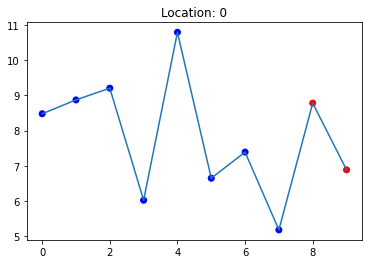

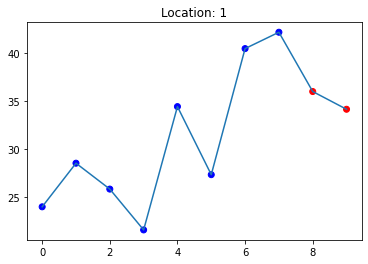

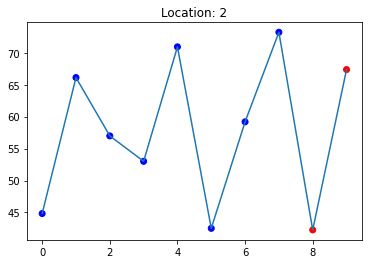

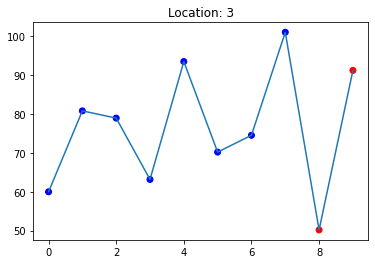

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:965: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


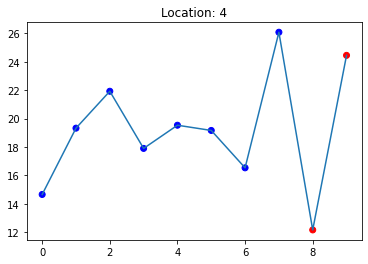

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:977: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


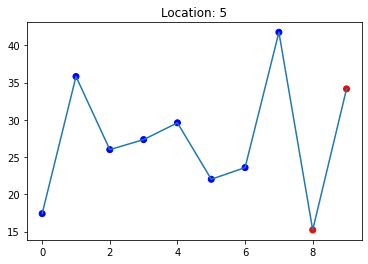

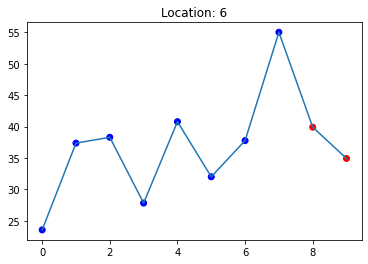

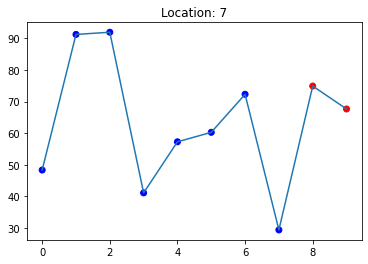

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


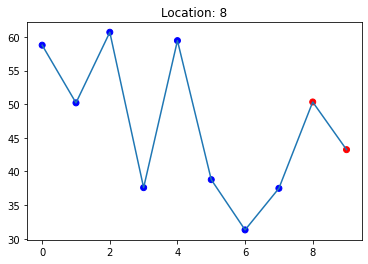

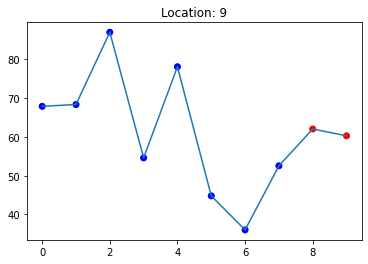

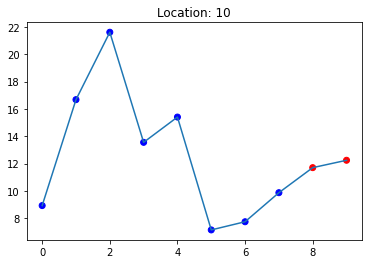

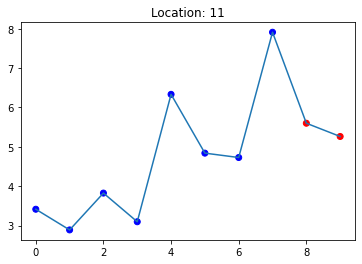

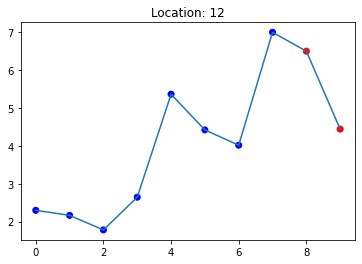

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


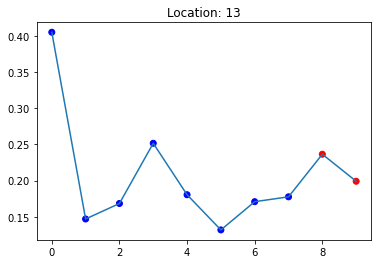

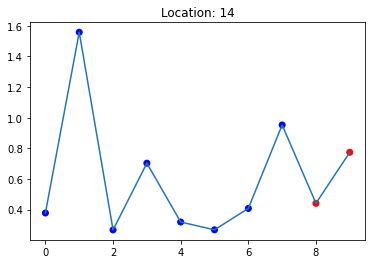

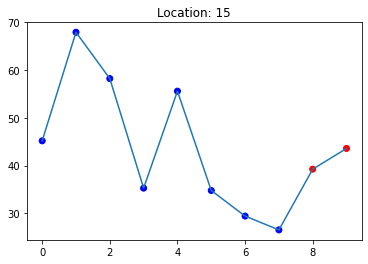

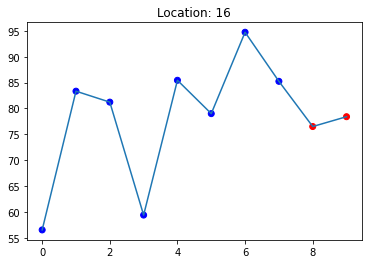

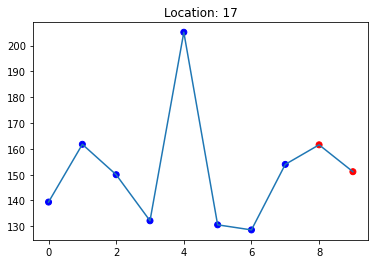

...

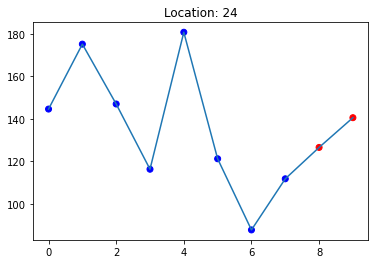

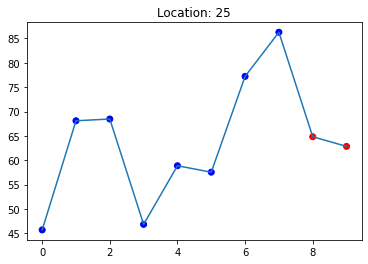

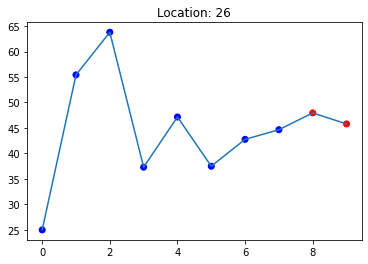

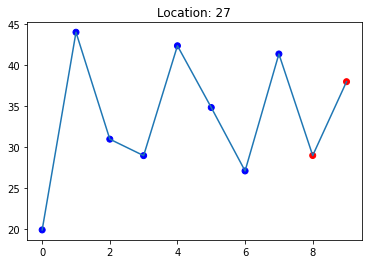

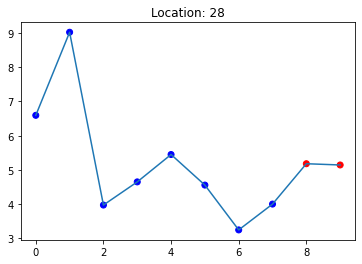

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


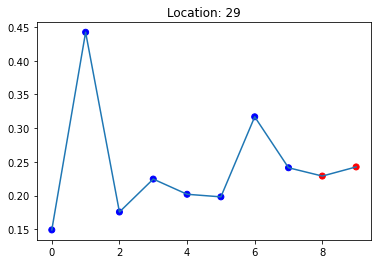

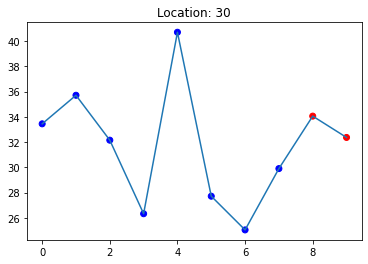

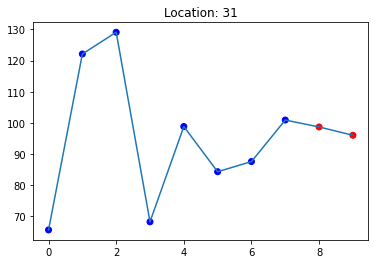

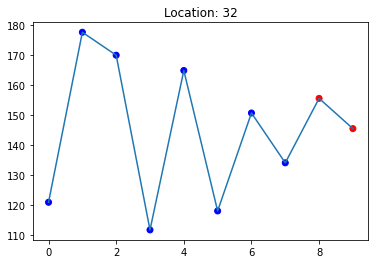

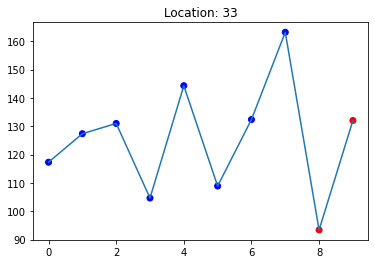

...

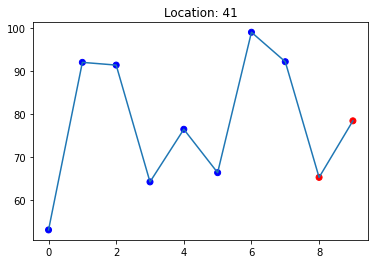

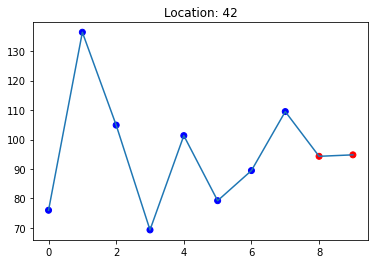

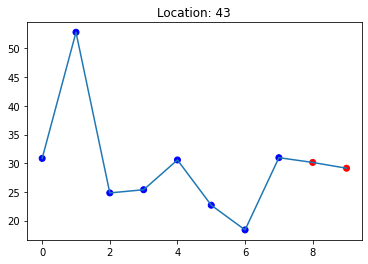

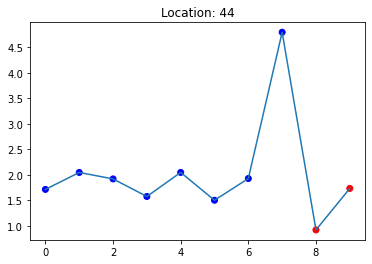

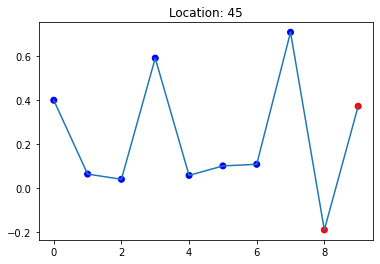

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


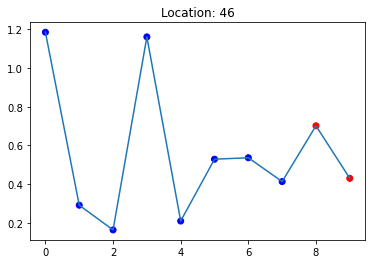

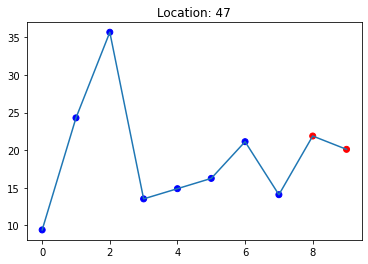

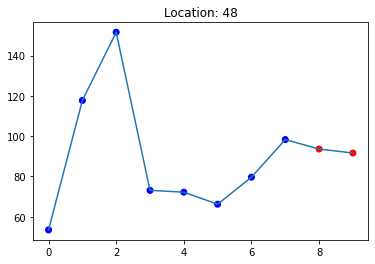

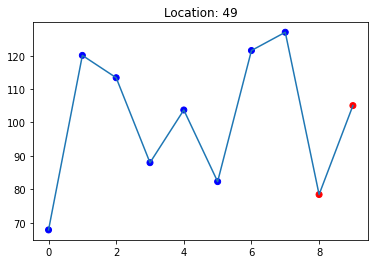

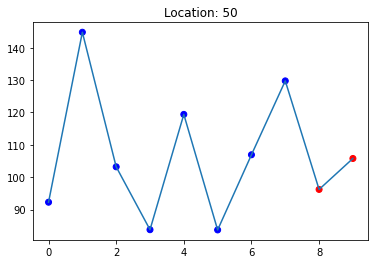

...

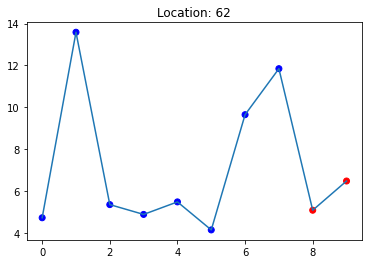

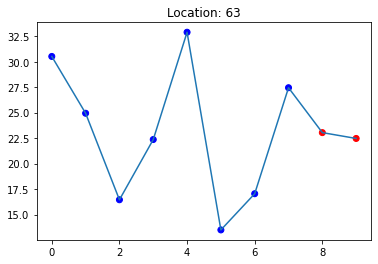

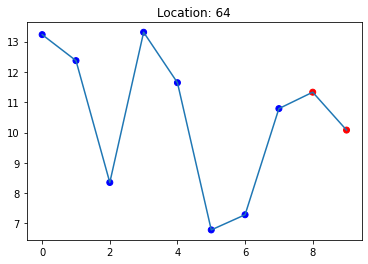

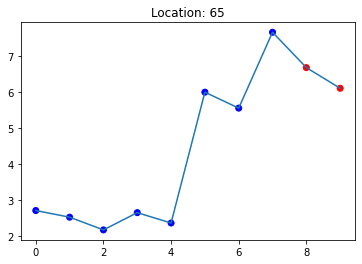

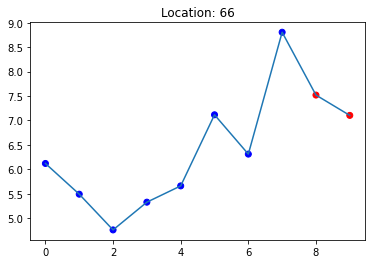

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


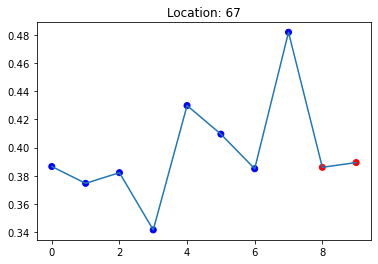

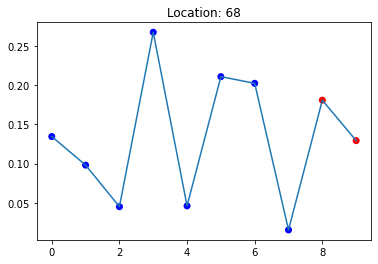

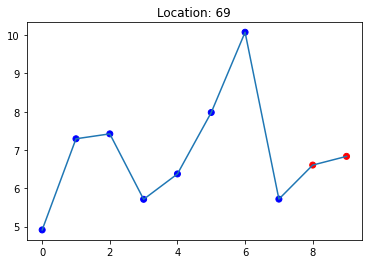

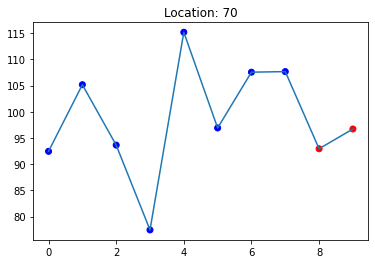

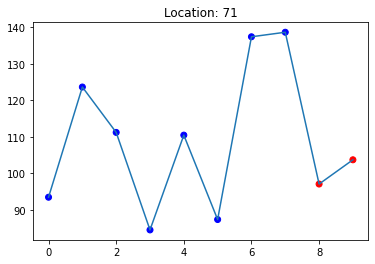

...

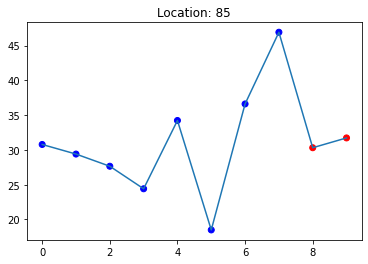

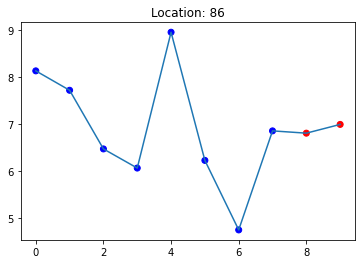

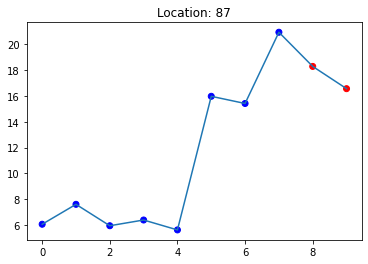

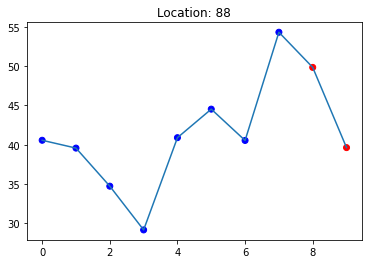

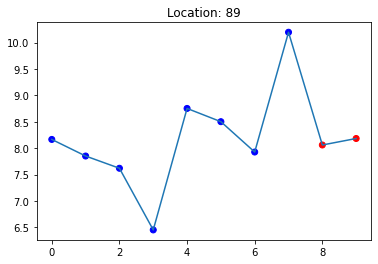

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


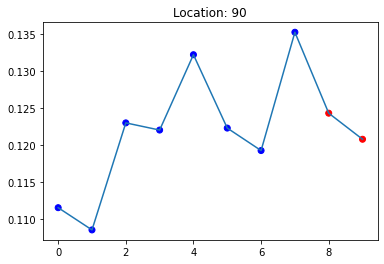

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


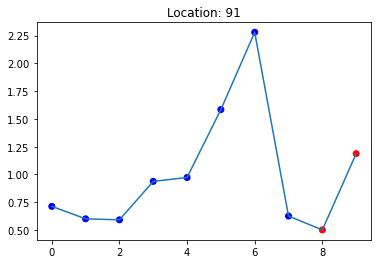

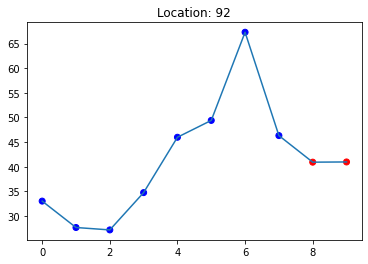

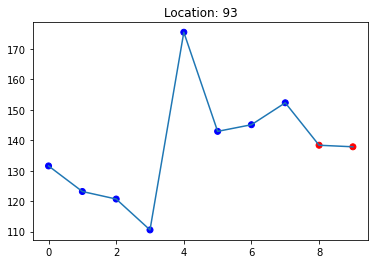

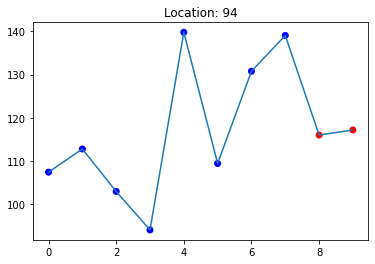

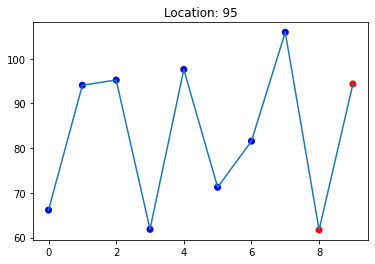

...

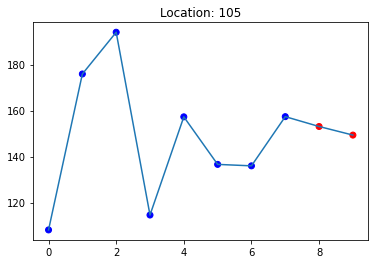

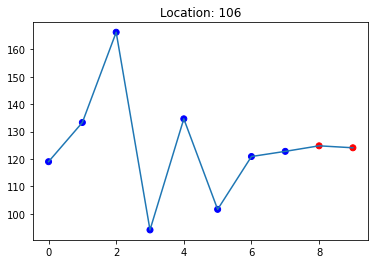

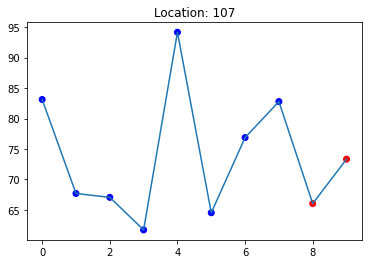

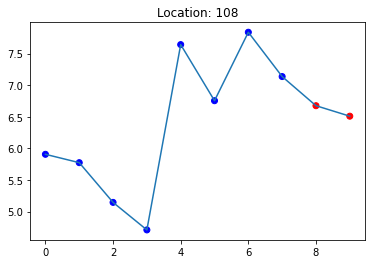

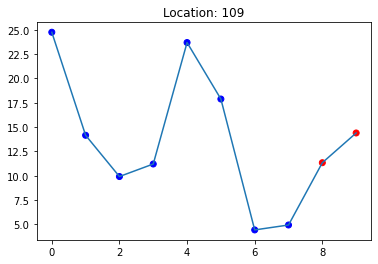

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


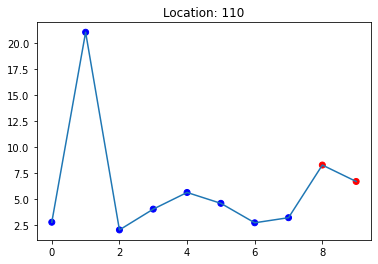

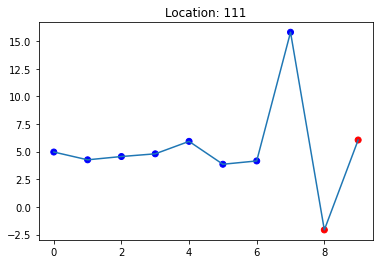

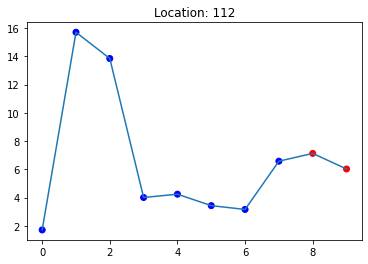

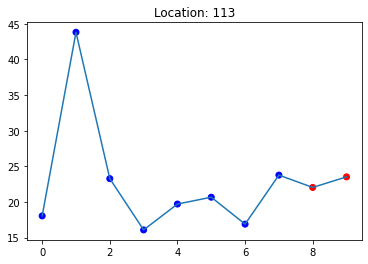

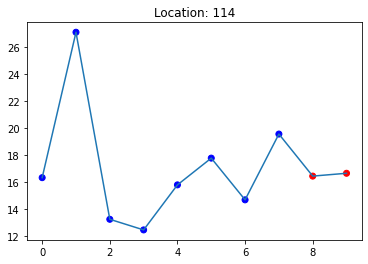

...

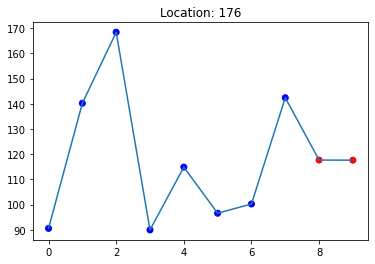

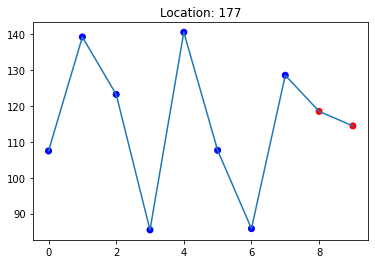

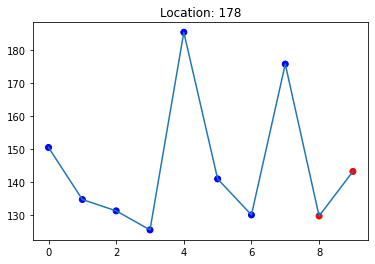

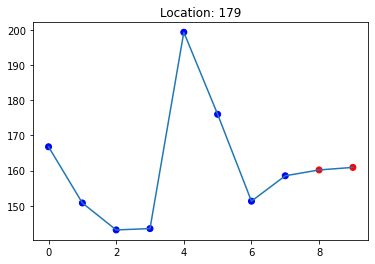

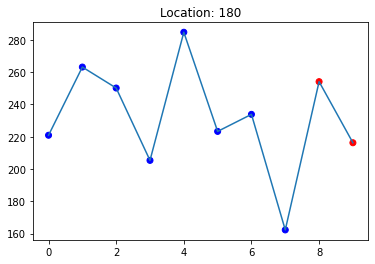

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


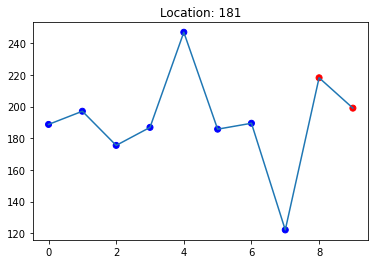

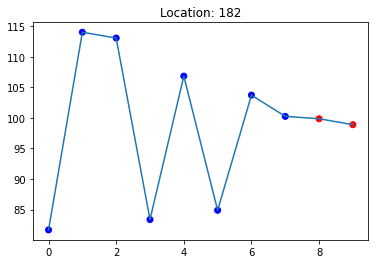

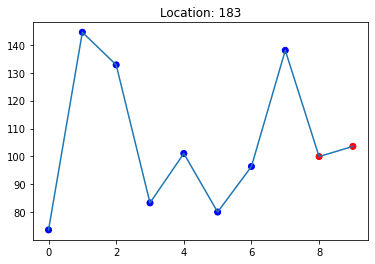

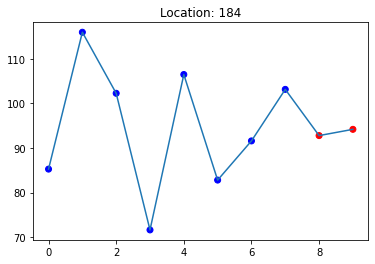

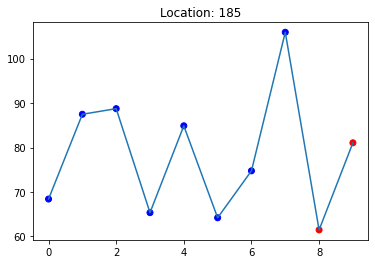

...

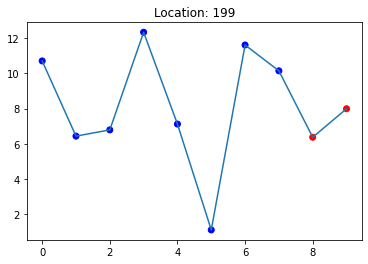

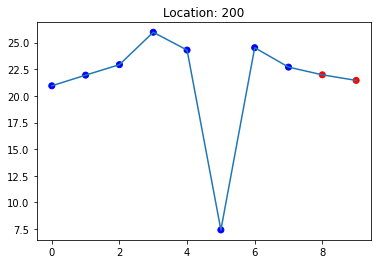

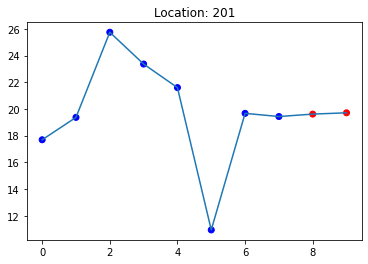

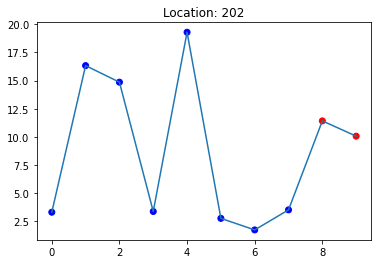

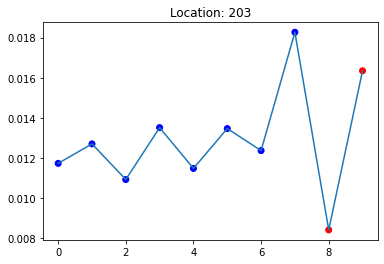

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


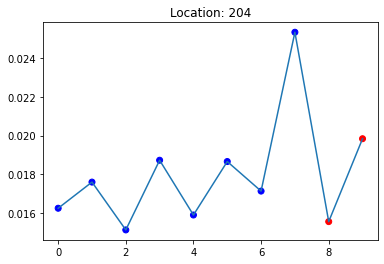

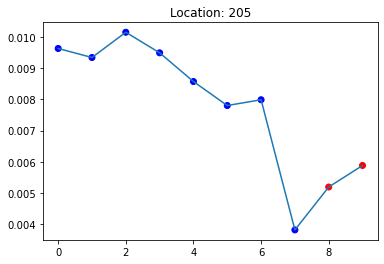

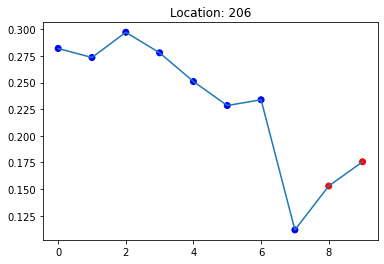

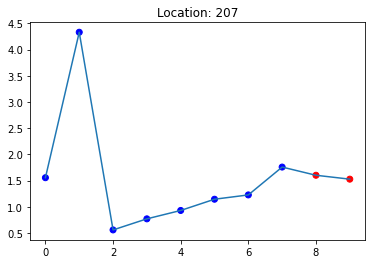

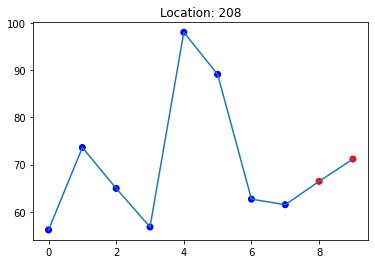

...

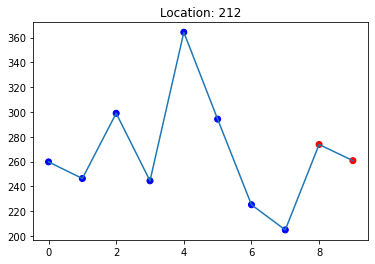

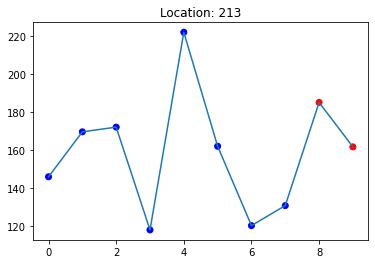

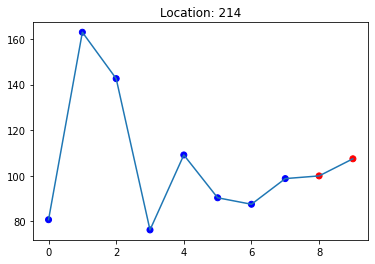

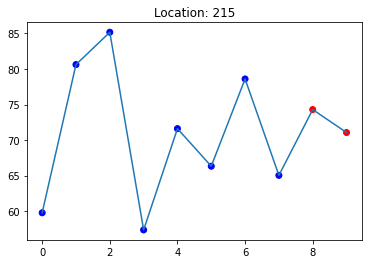

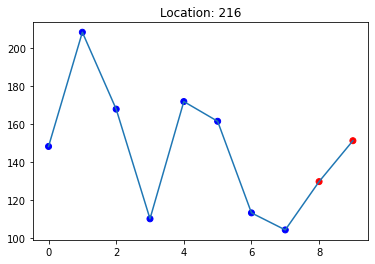

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


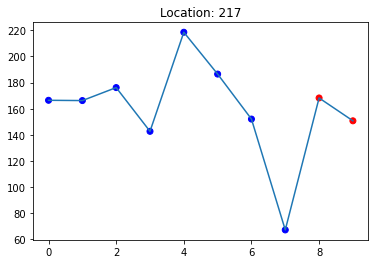

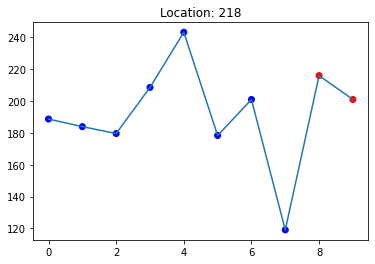

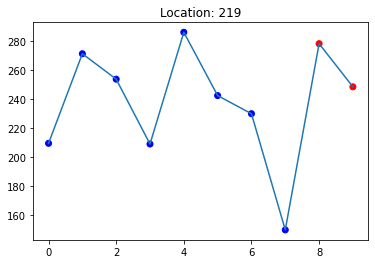

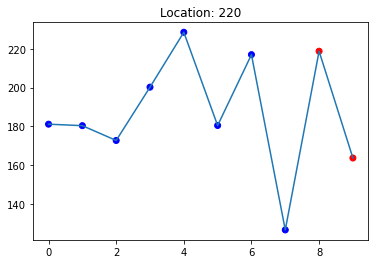

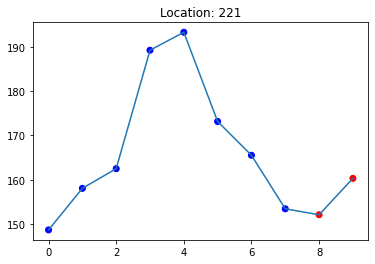

...

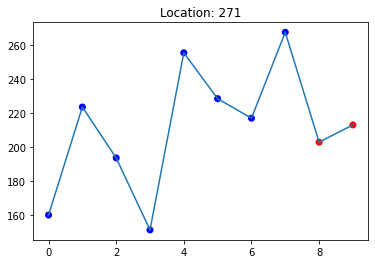

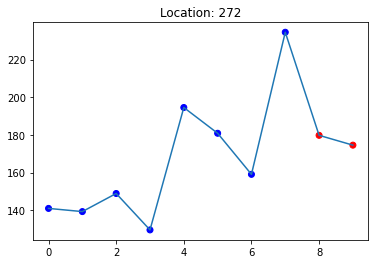

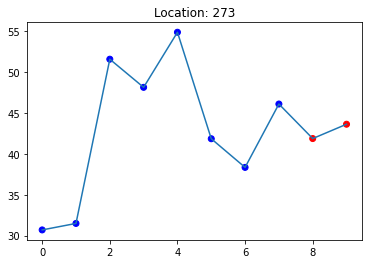

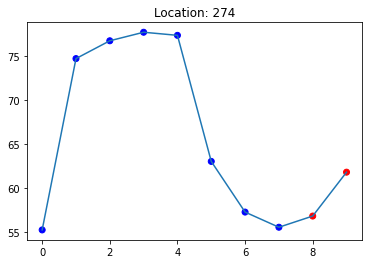

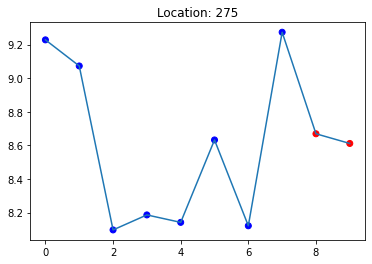

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


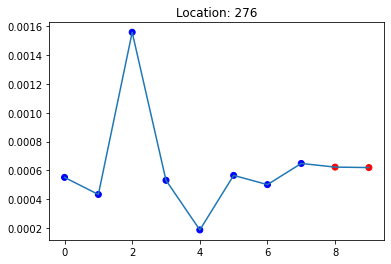

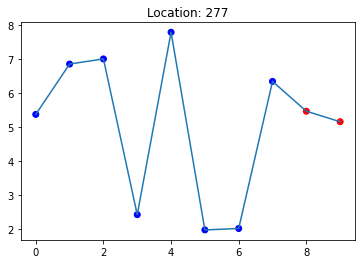

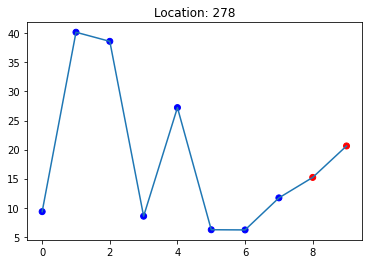

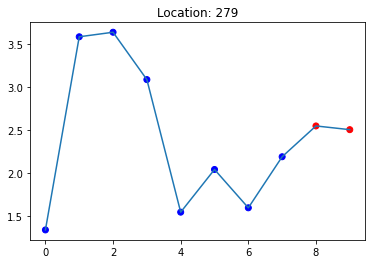

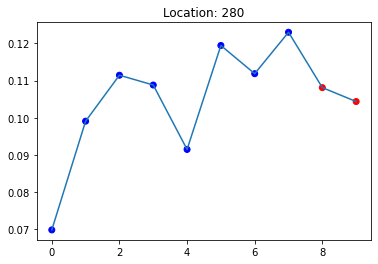

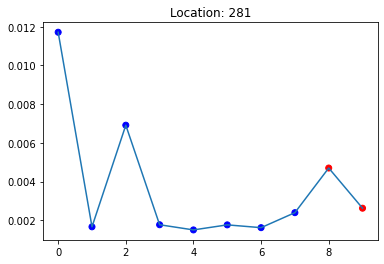

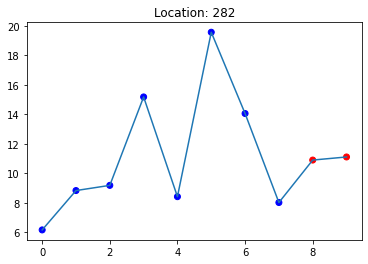

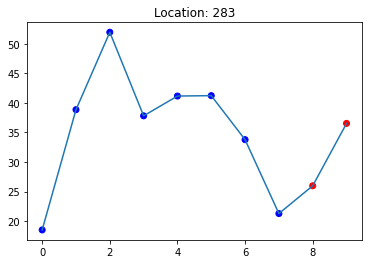

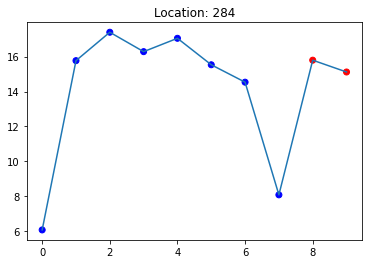

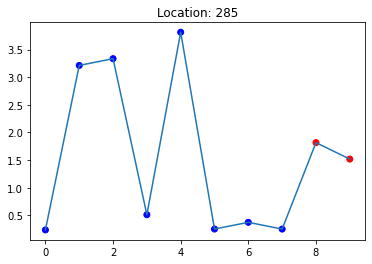

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


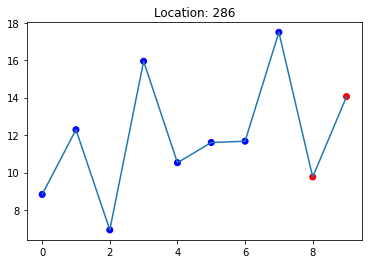

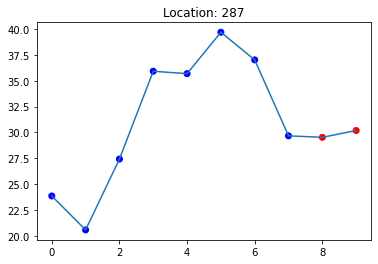

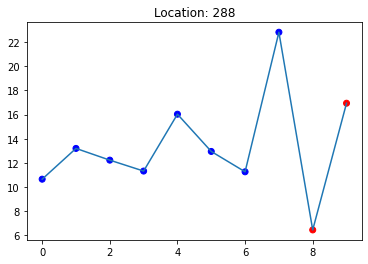

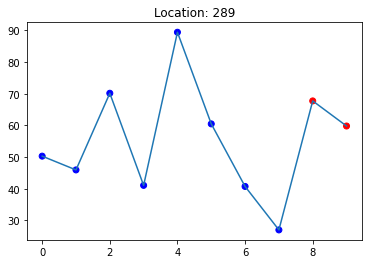

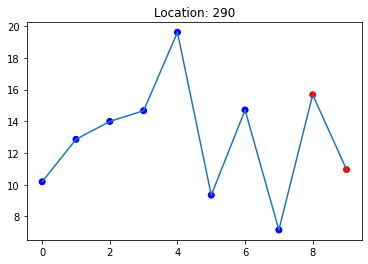

...

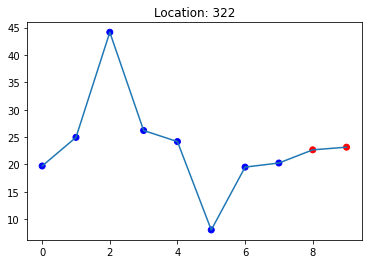

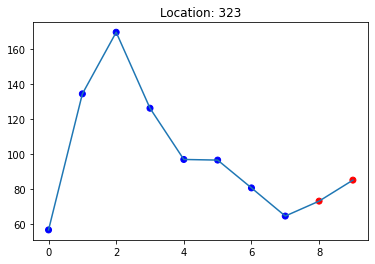

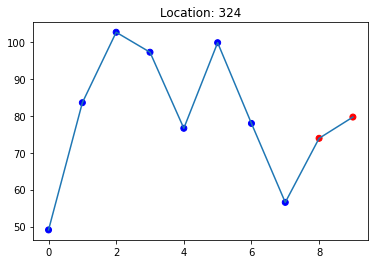

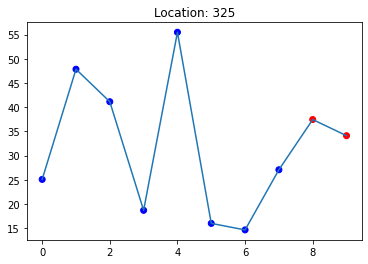

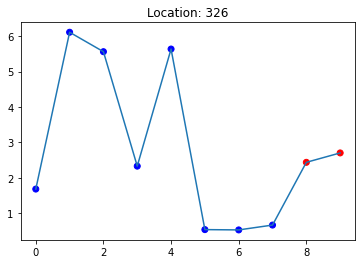

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


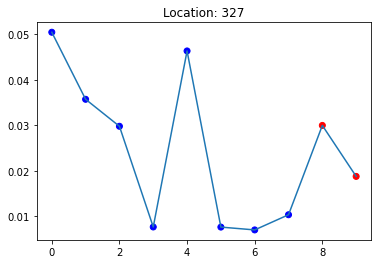

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


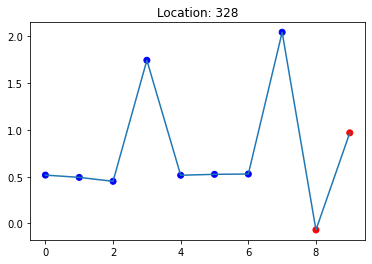

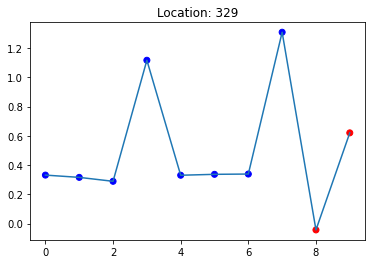

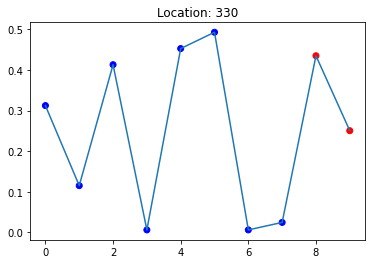

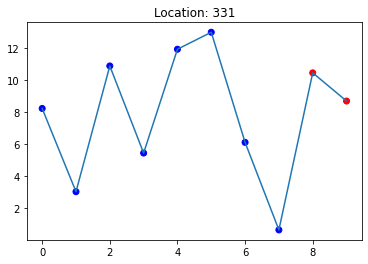

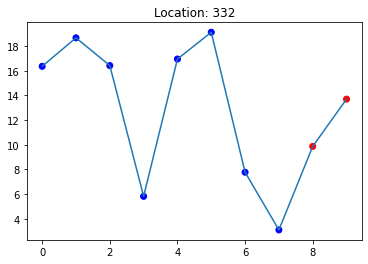

...

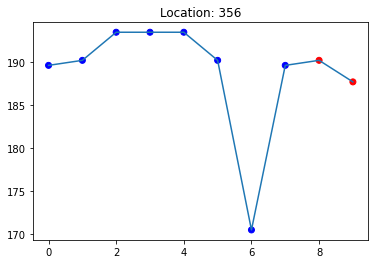

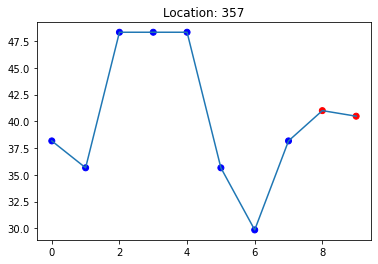

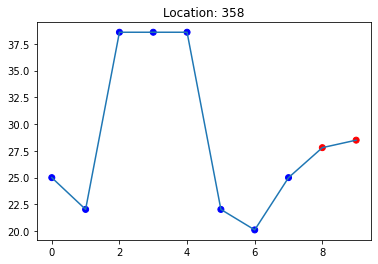

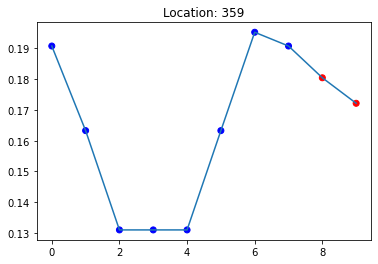

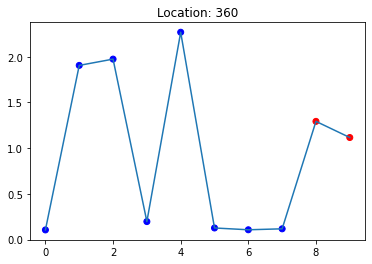

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


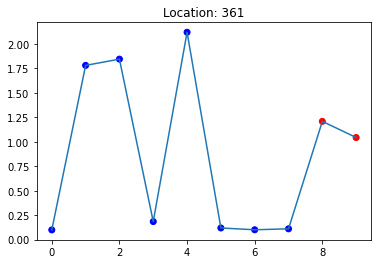

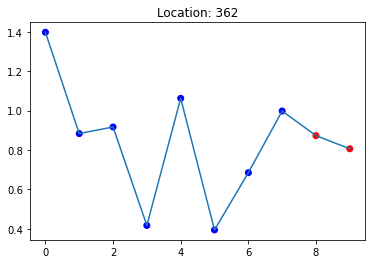

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


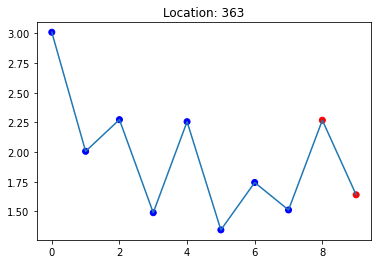

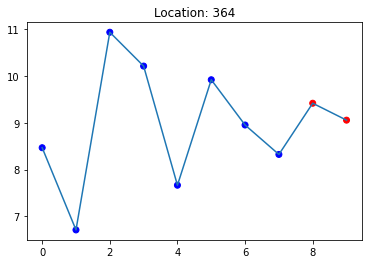

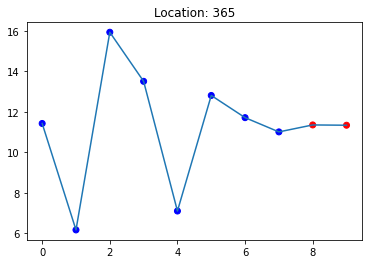

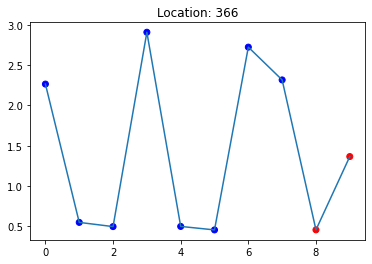

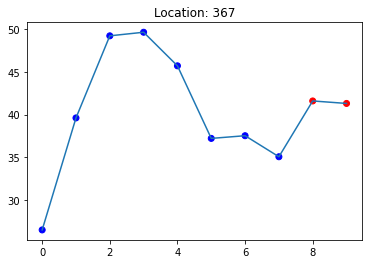

...

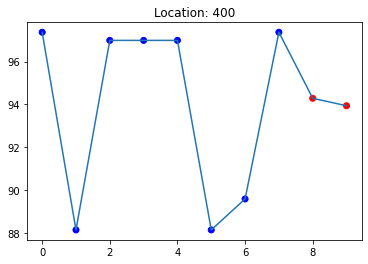

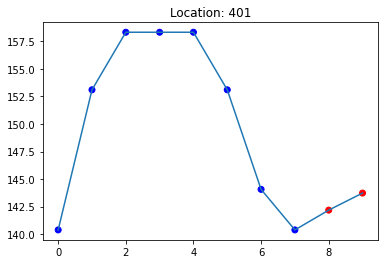

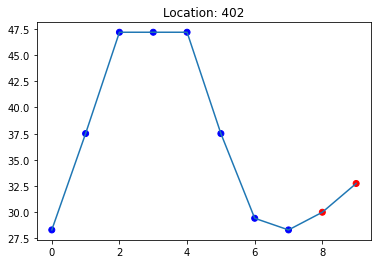

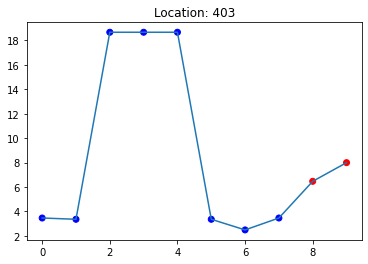

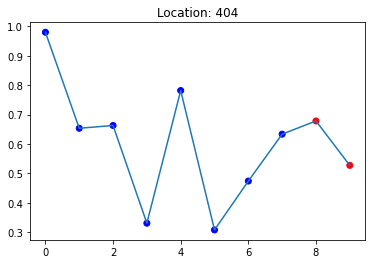

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


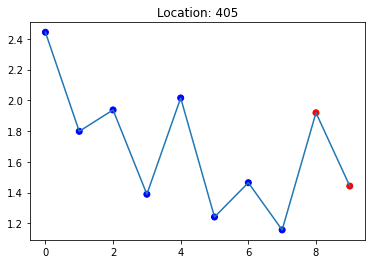

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


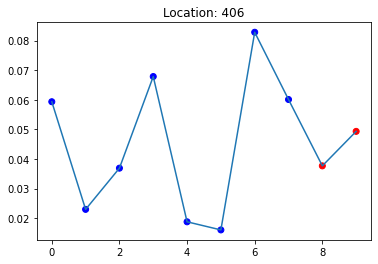

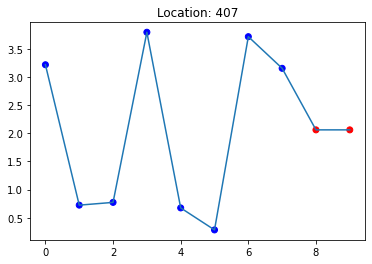

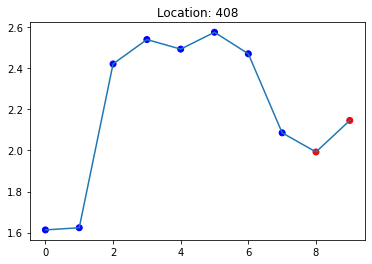

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


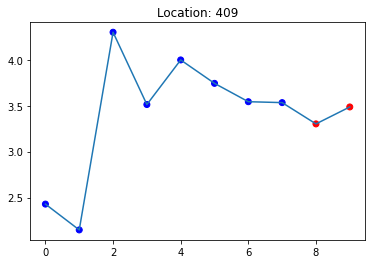

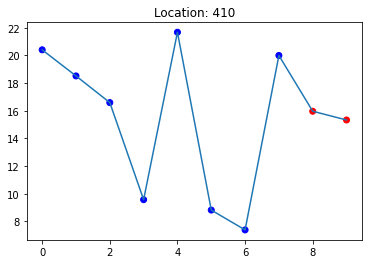

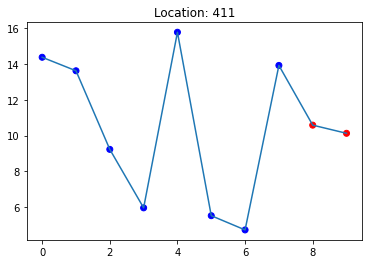

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


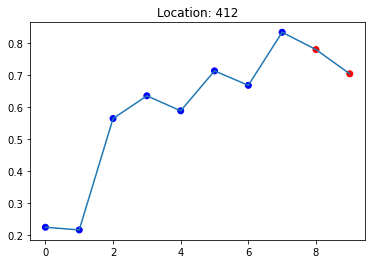

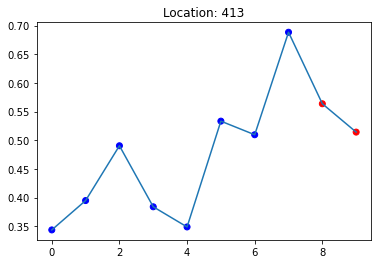

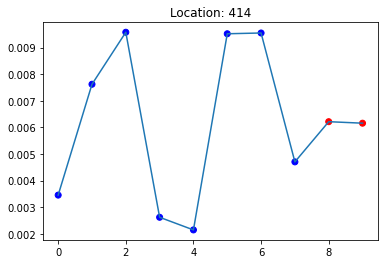

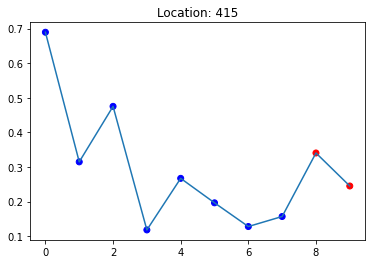

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


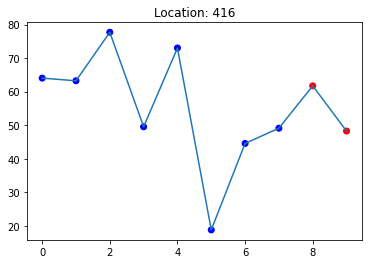

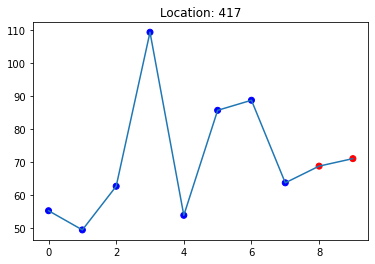

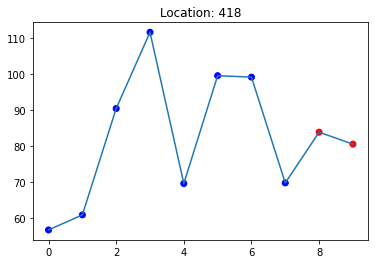

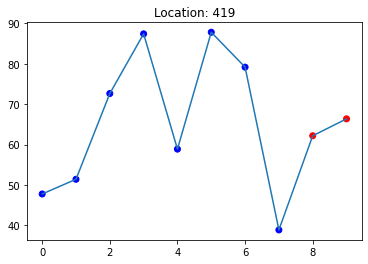

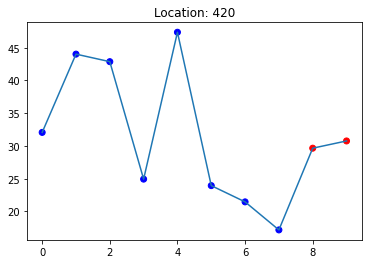

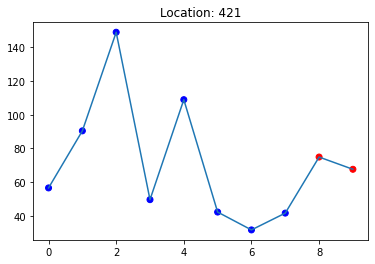

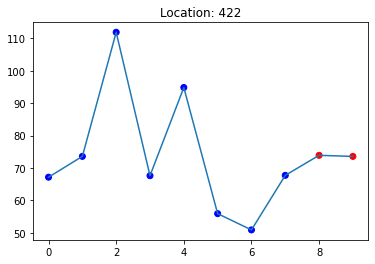

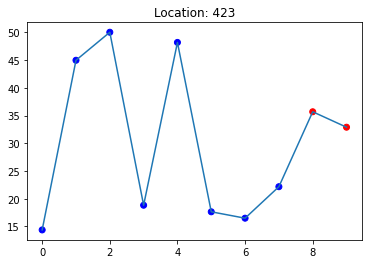

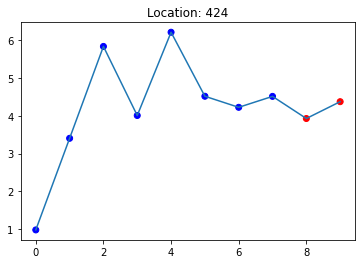

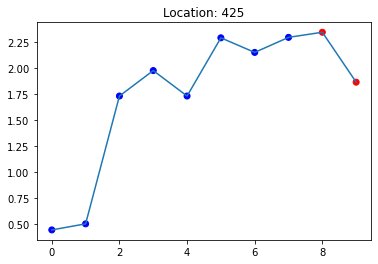

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


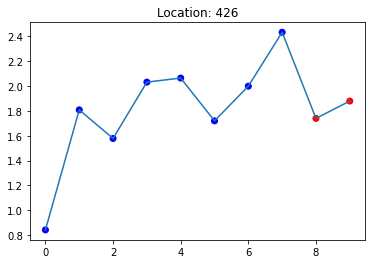

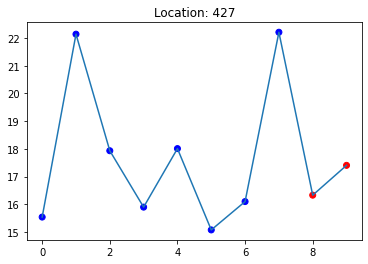

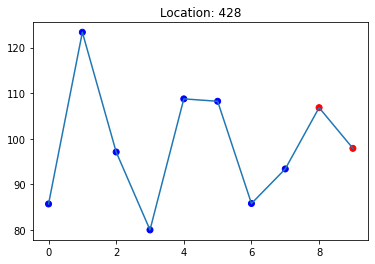

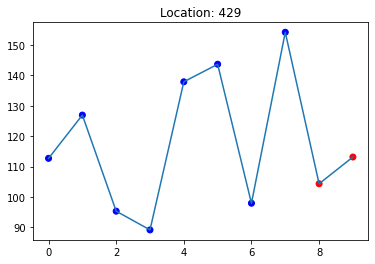

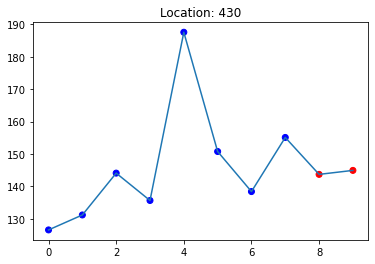

...

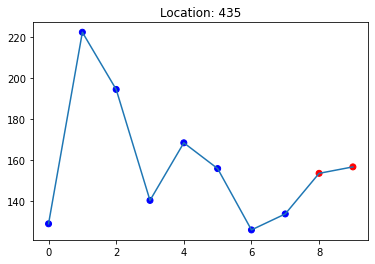

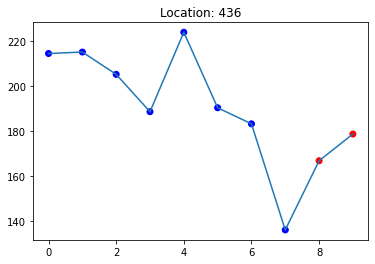

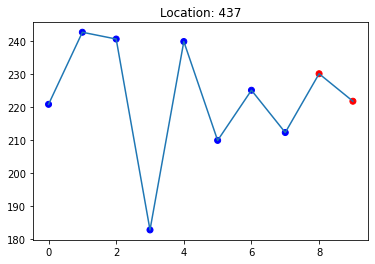

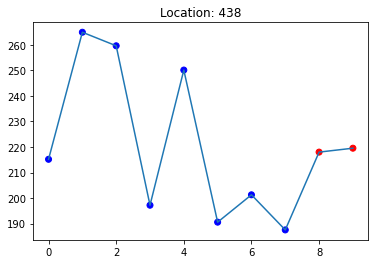

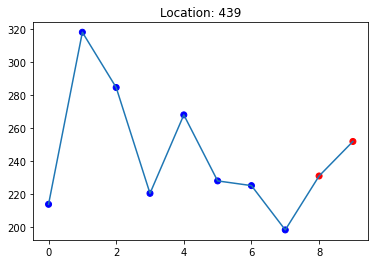

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


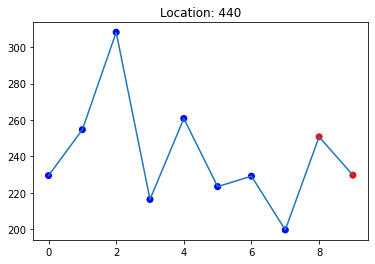

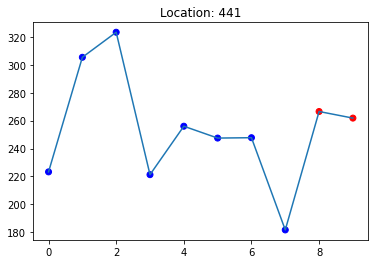

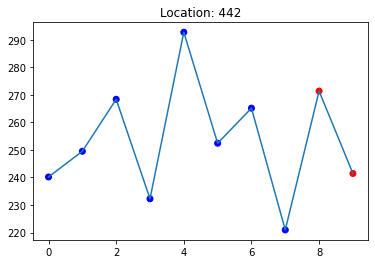

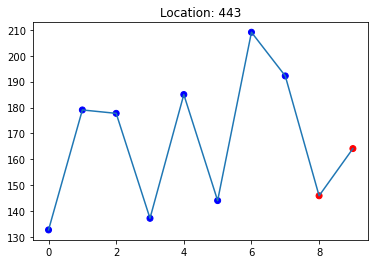

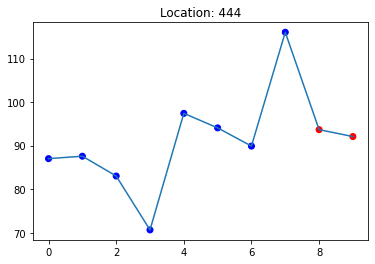

...

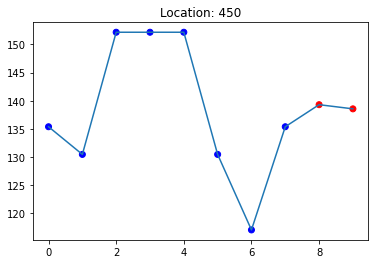

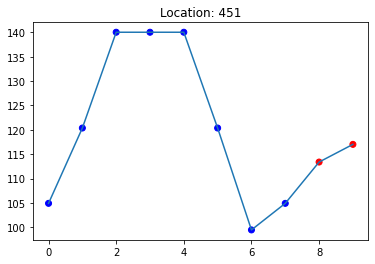

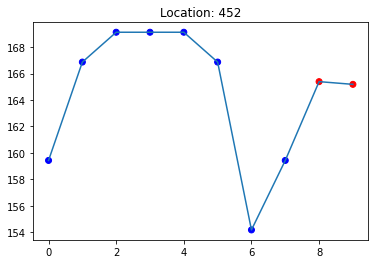

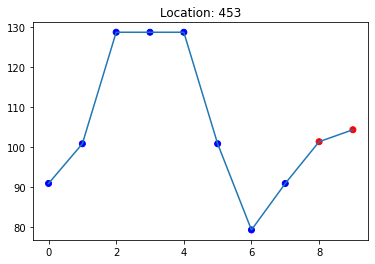

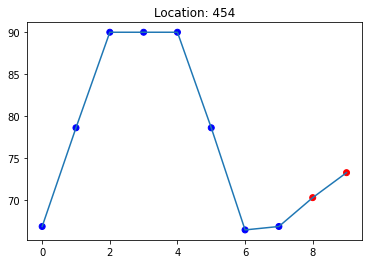

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


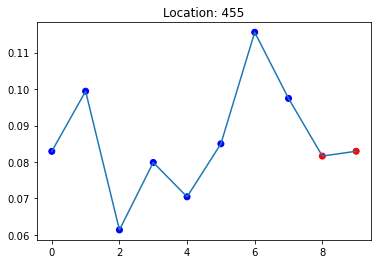

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


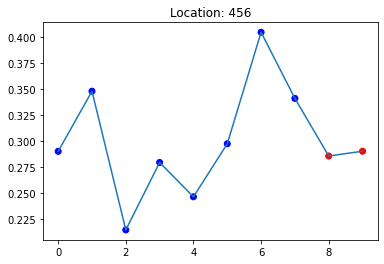

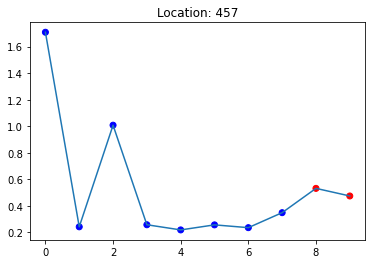

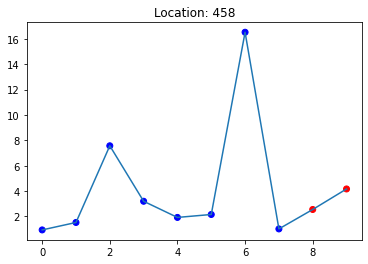

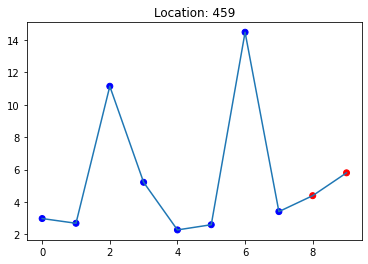

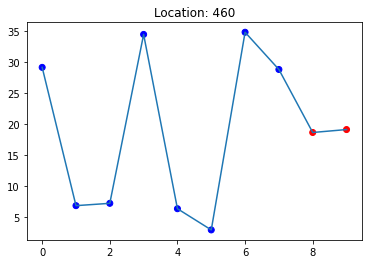

...

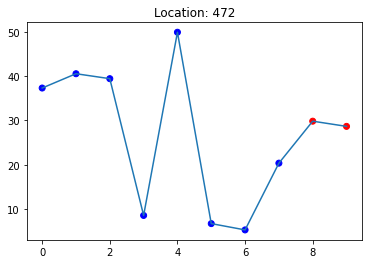

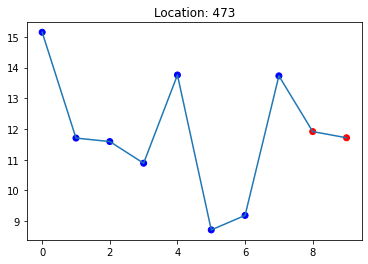

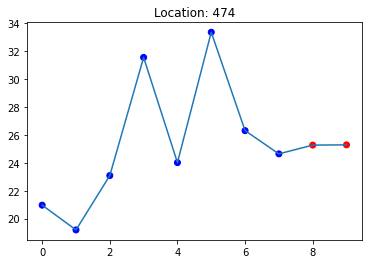

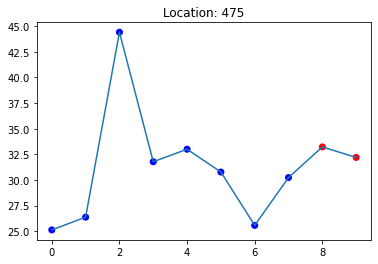

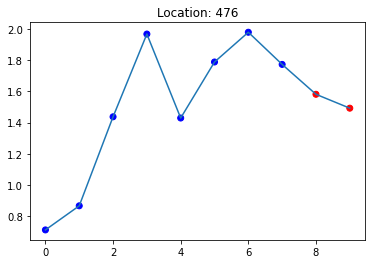

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


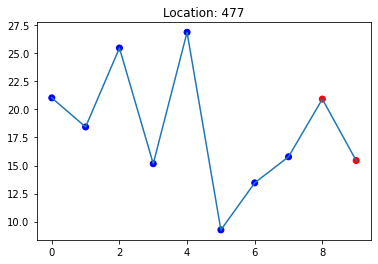

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


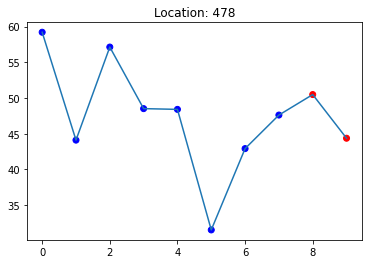

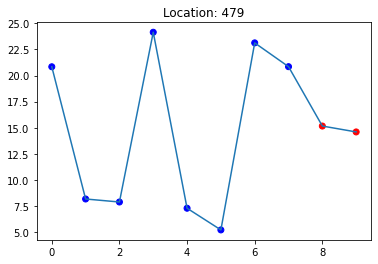

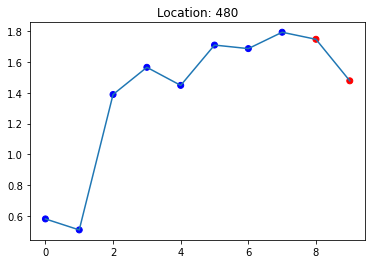

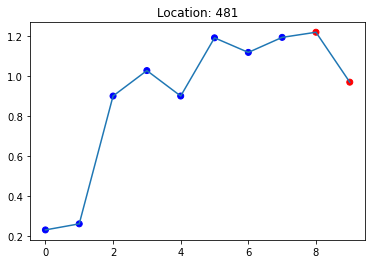

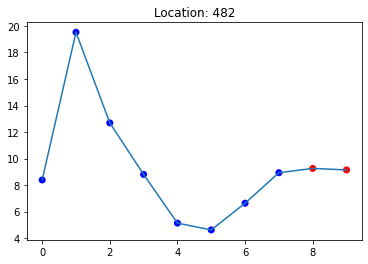

...

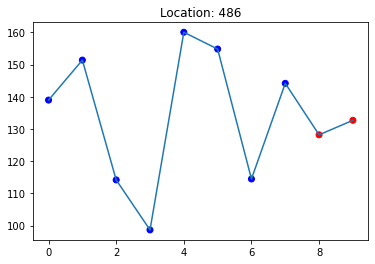

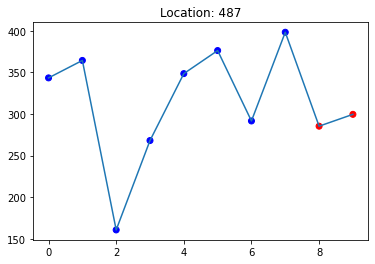

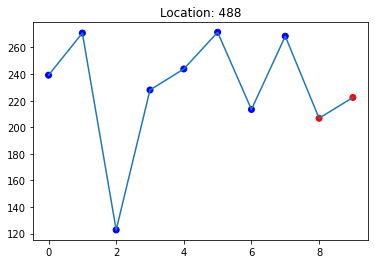

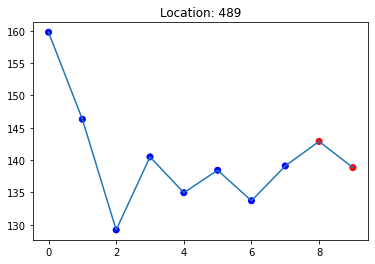

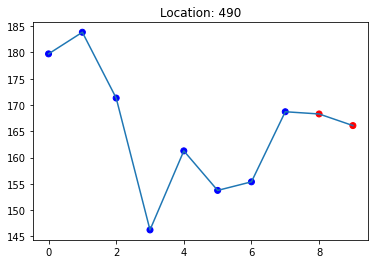

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


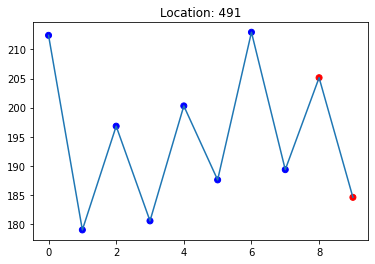

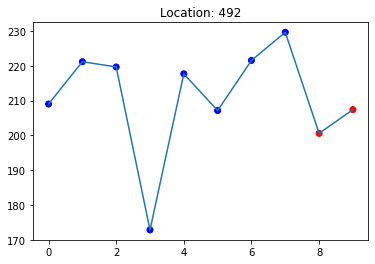

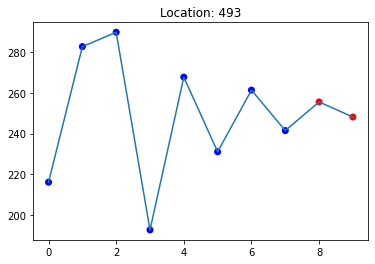

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


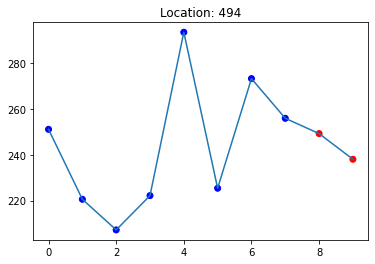

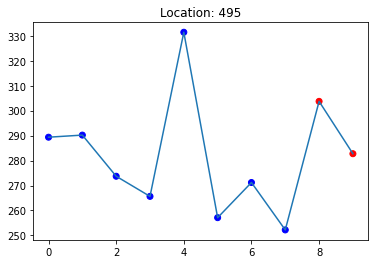

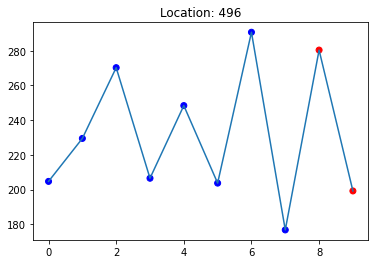

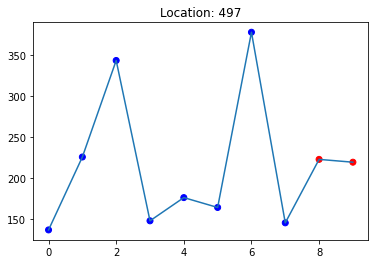

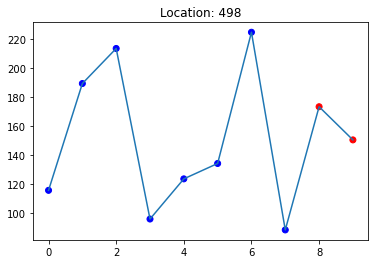

...

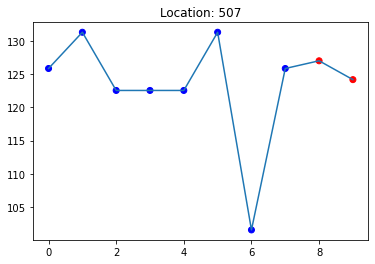

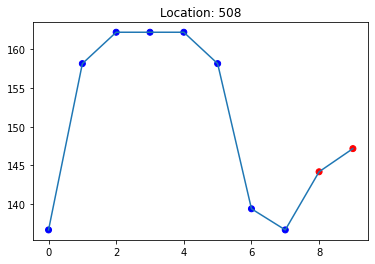

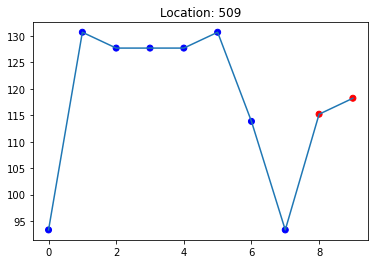

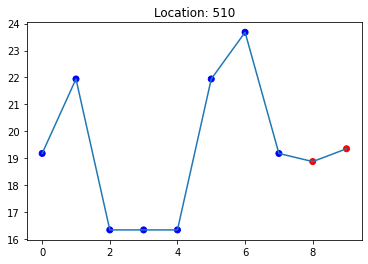

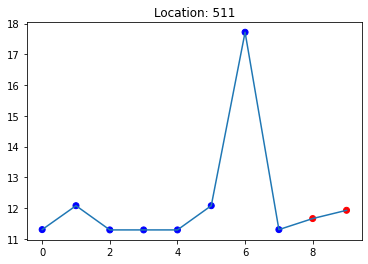

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


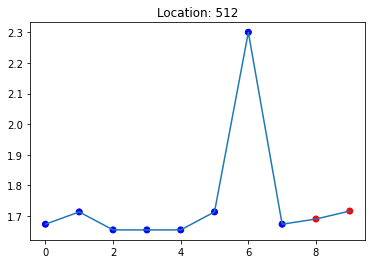

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


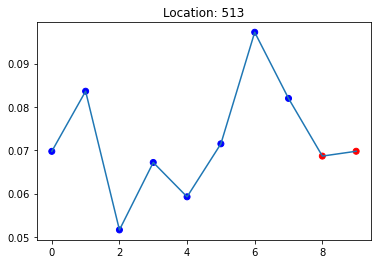

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


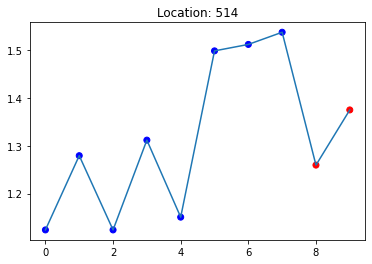

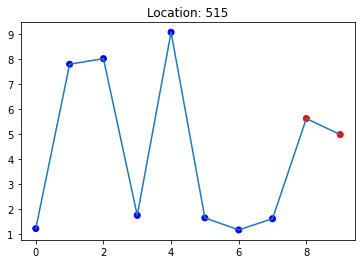

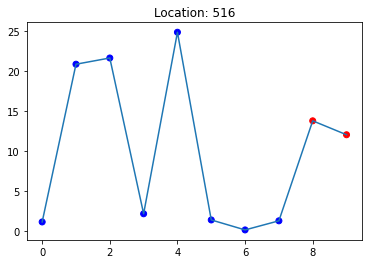

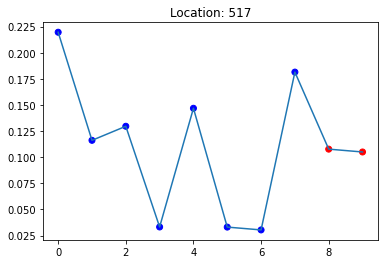

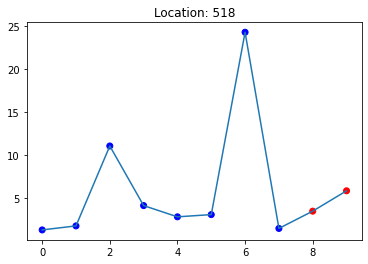

...

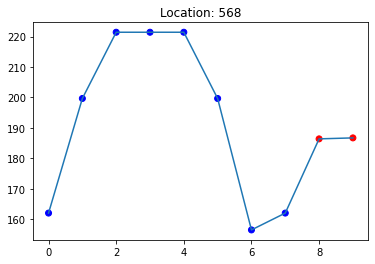

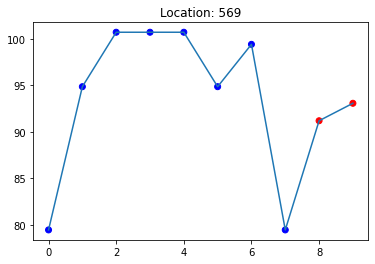

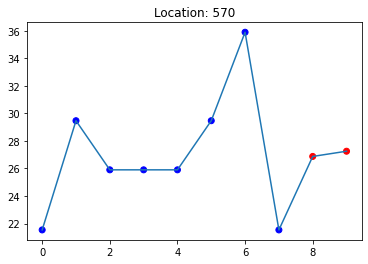

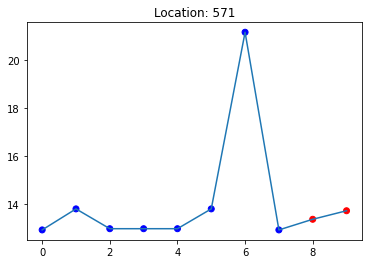

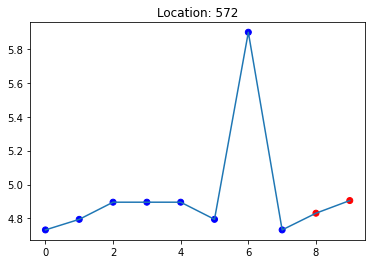

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


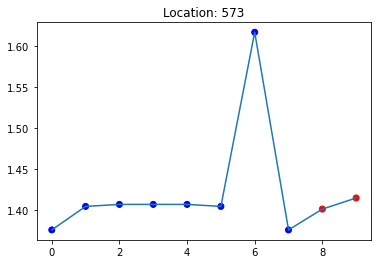

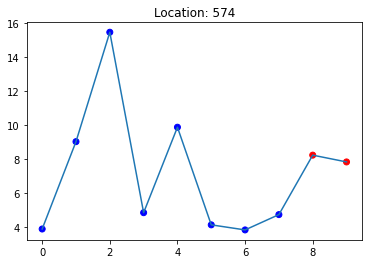

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


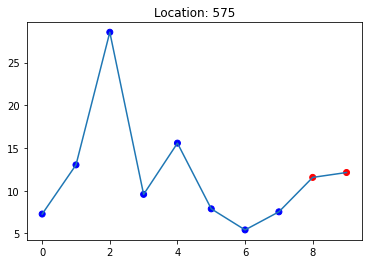

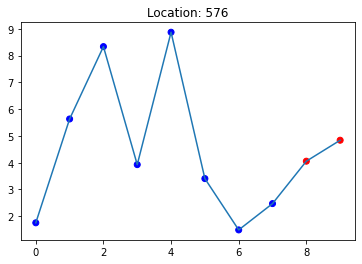

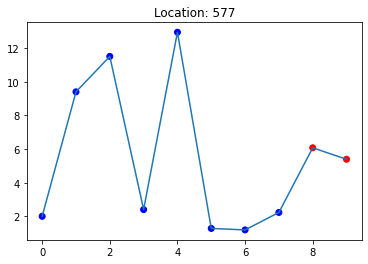

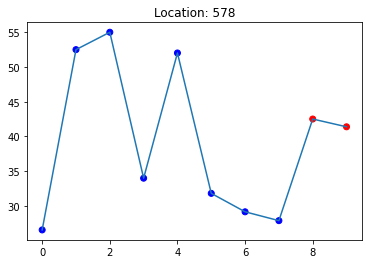

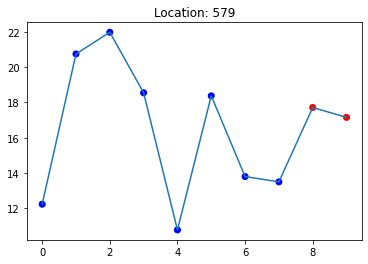

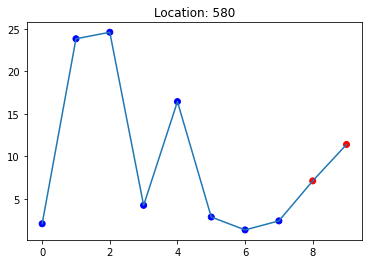

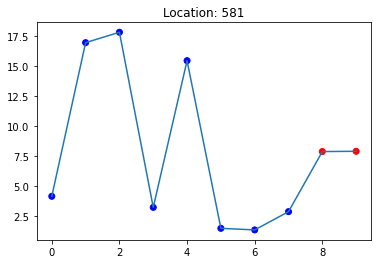

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


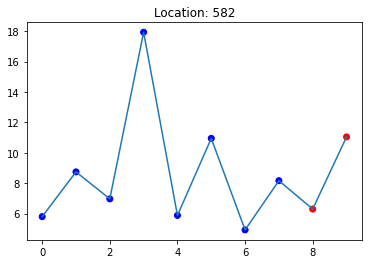

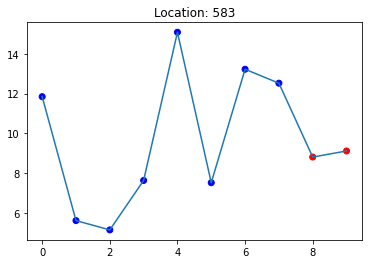

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


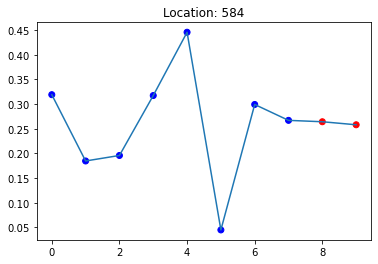

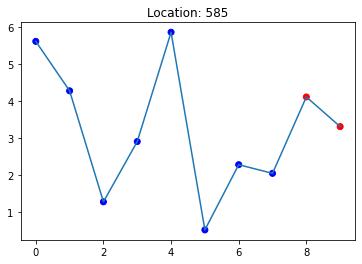

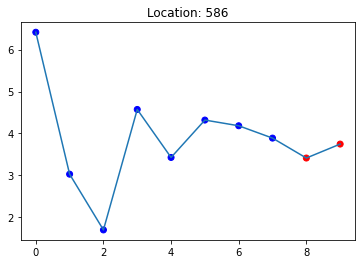

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


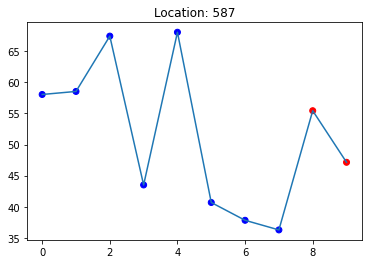

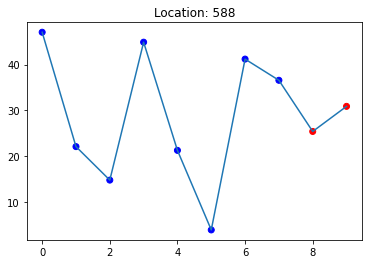

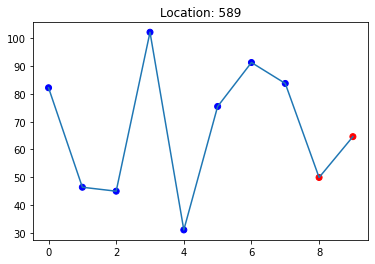

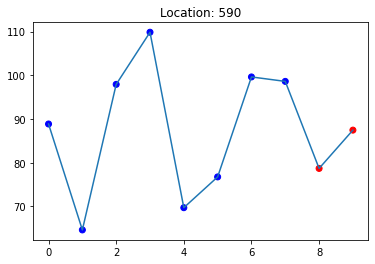

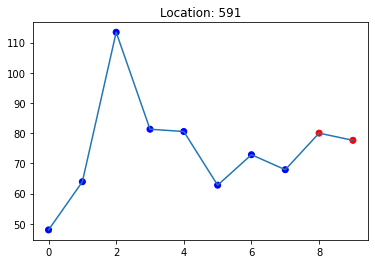

...

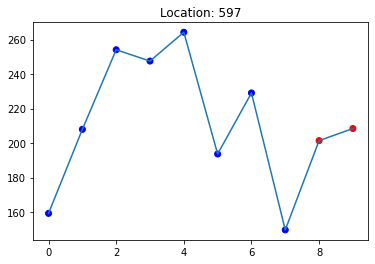

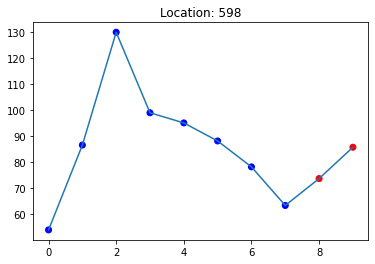

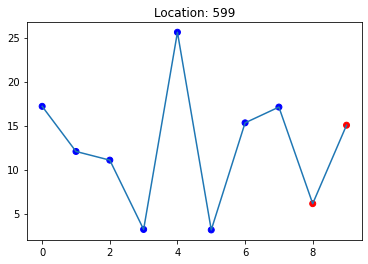

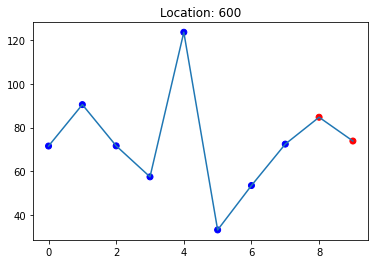

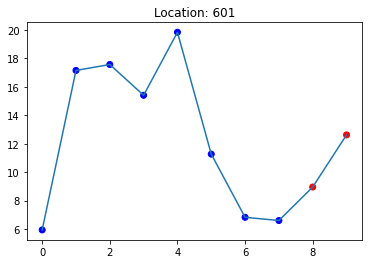

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


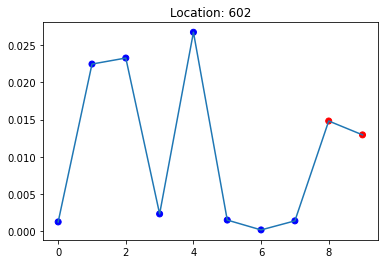

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


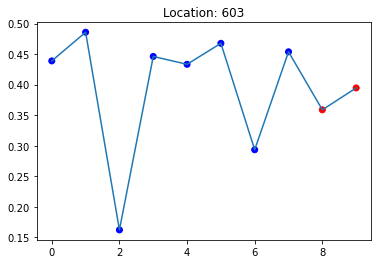

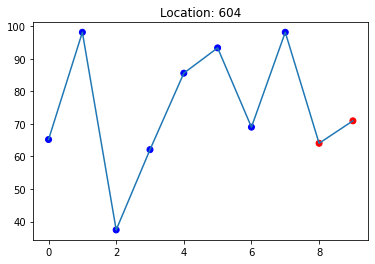

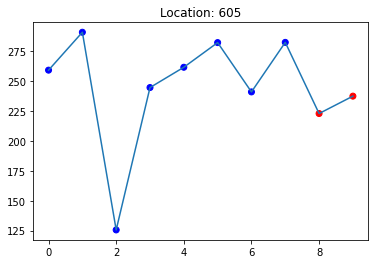

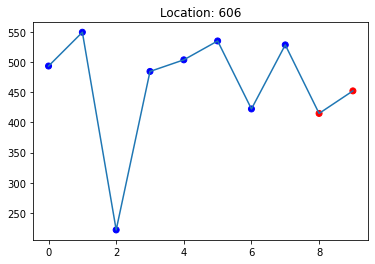

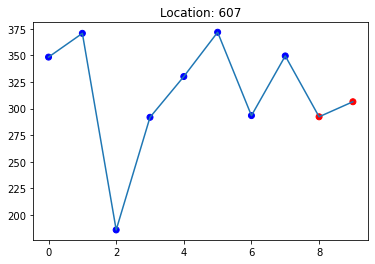

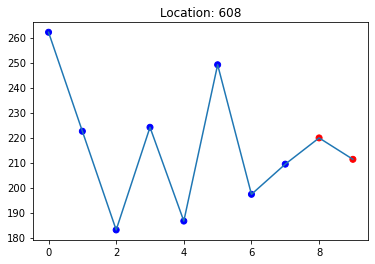

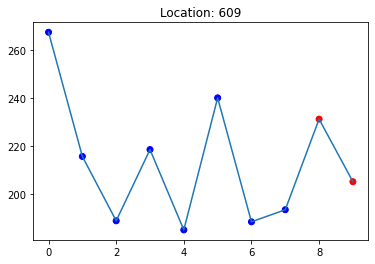

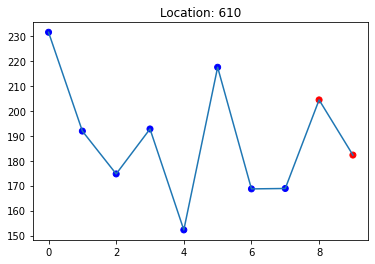

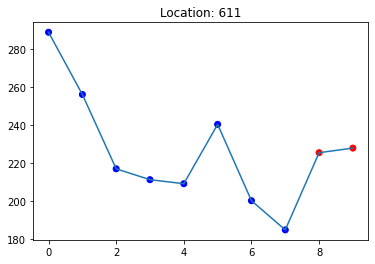

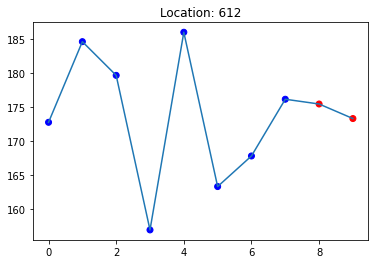

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


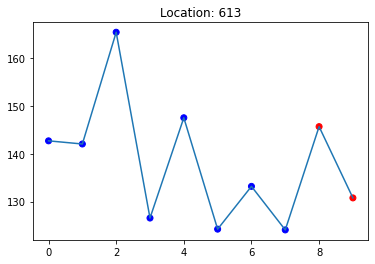

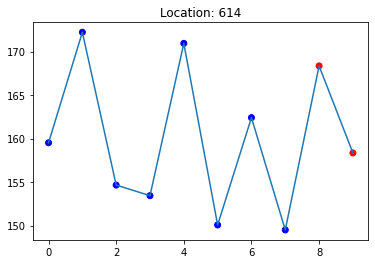

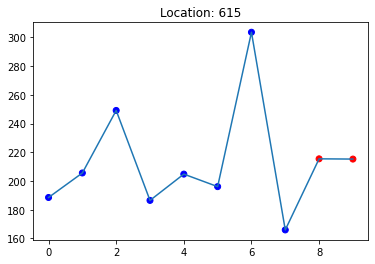

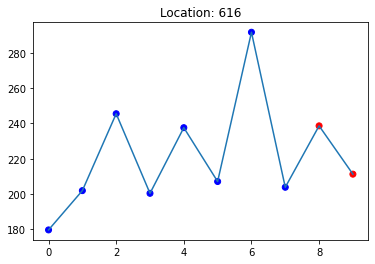

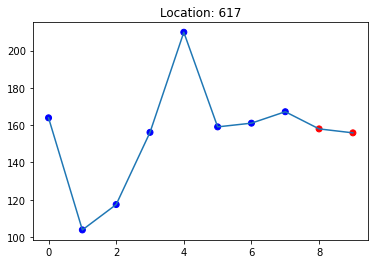

...

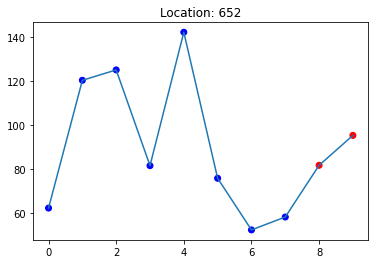

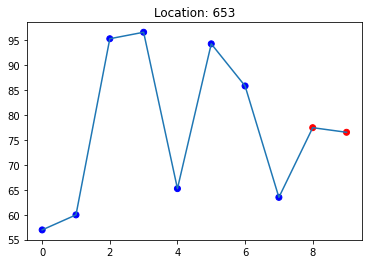

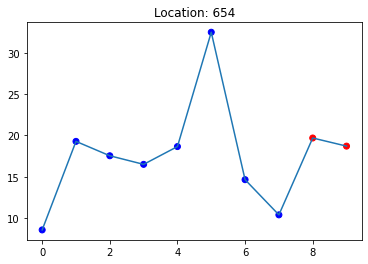

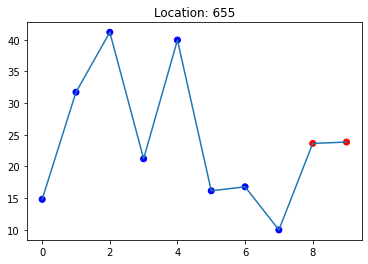

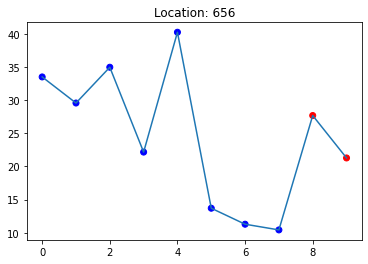

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


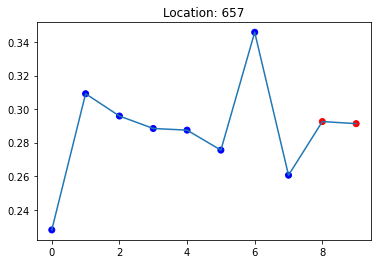

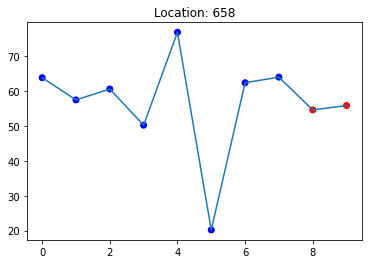

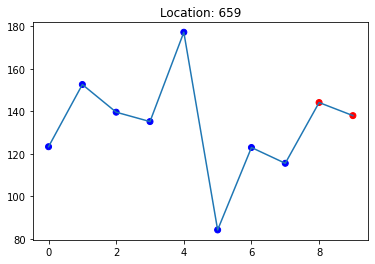

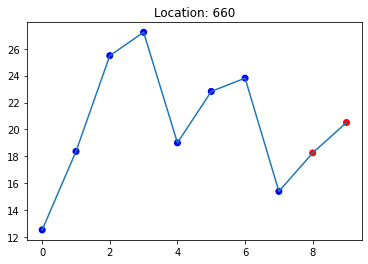

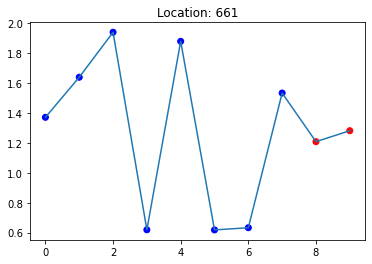

...

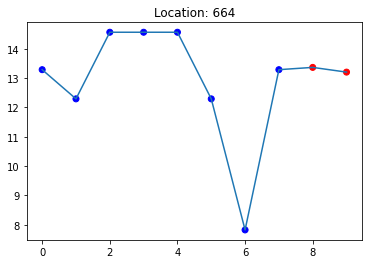

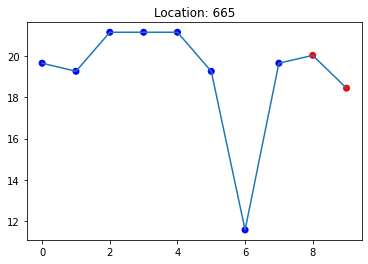

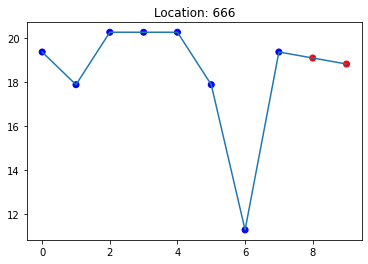

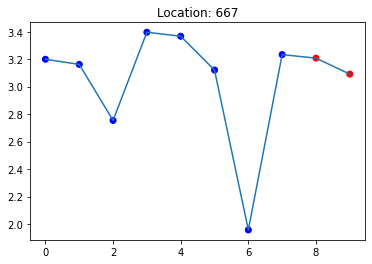

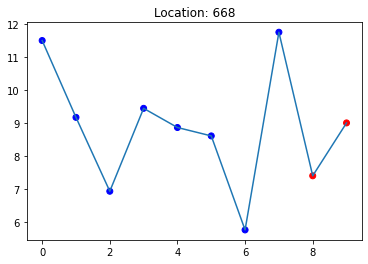

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


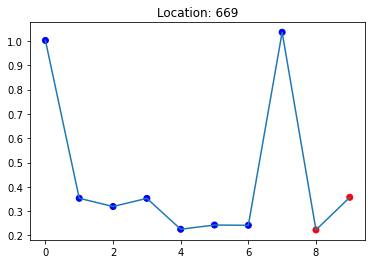

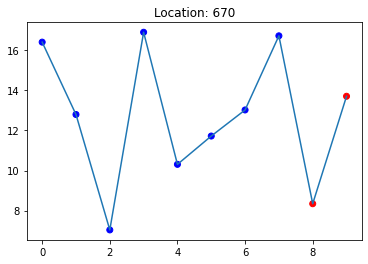

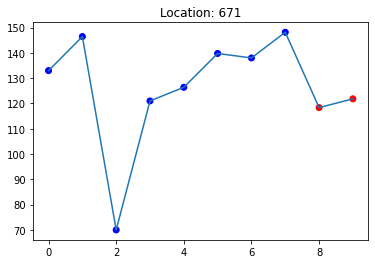

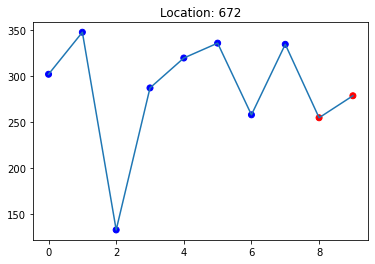

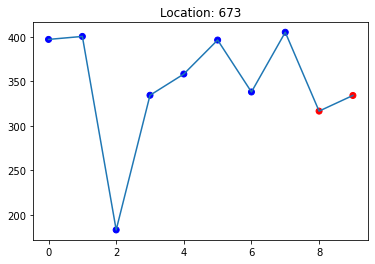

...

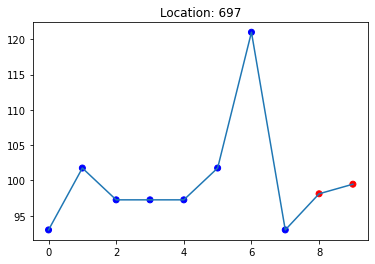

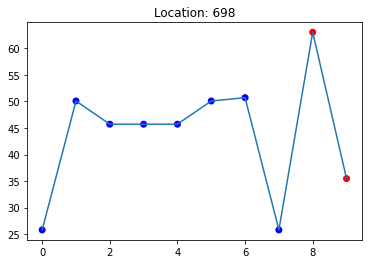

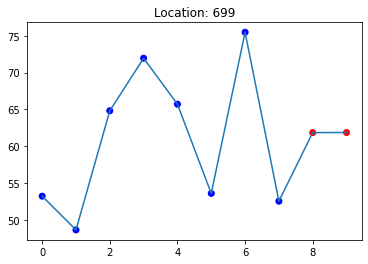

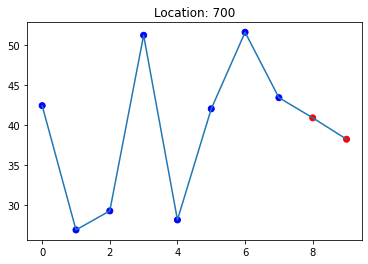

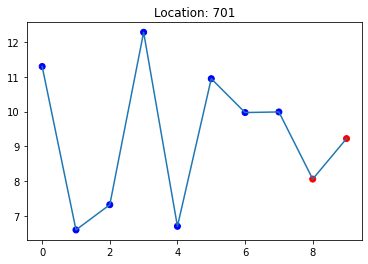

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


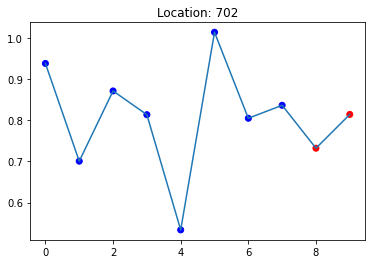

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


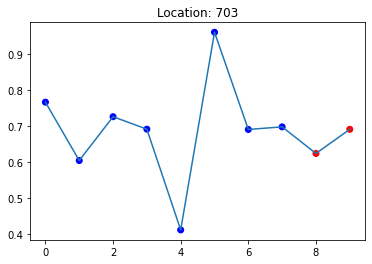

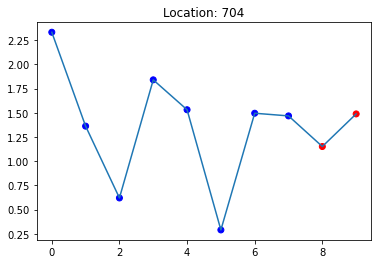

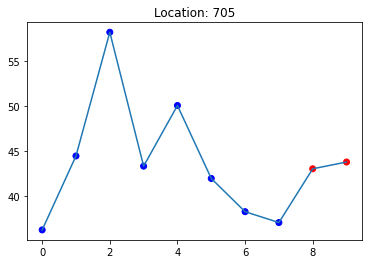

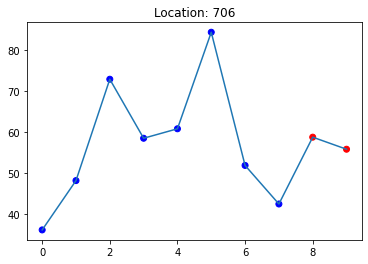

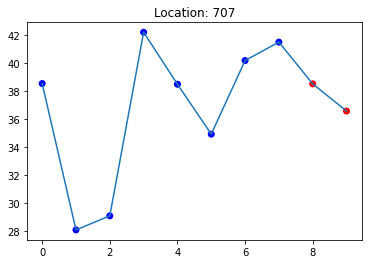

...

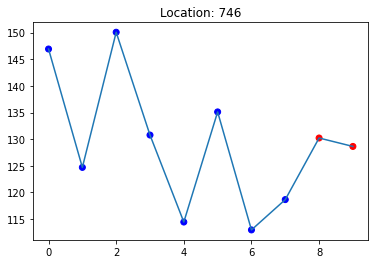

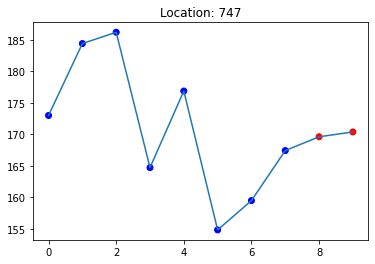

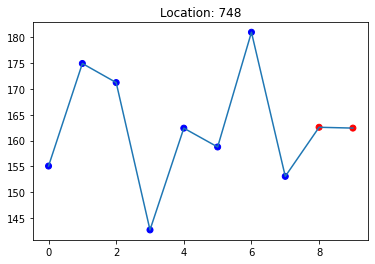

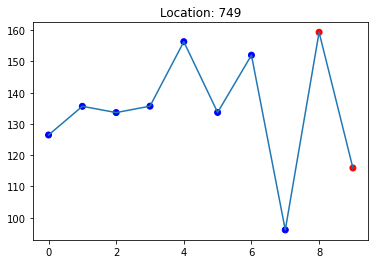

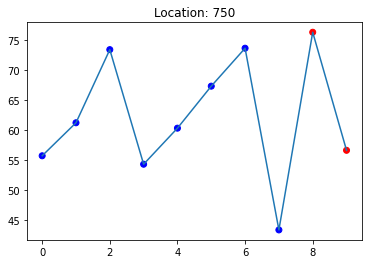

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


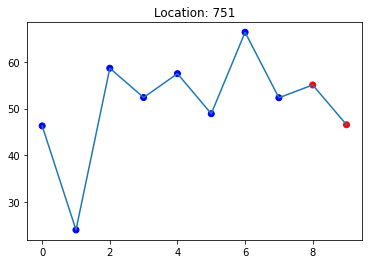

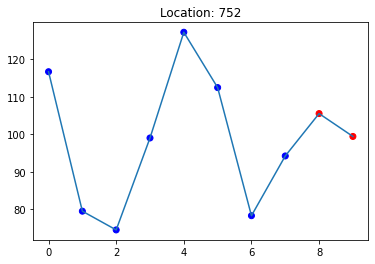

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


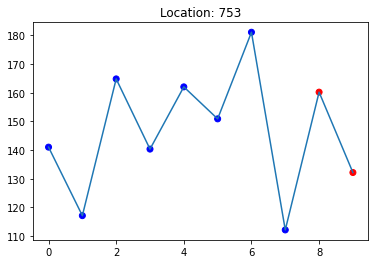

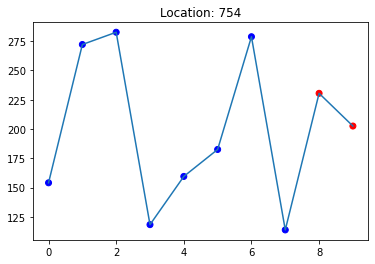

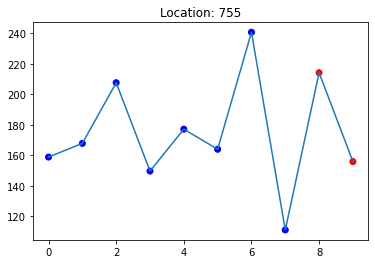

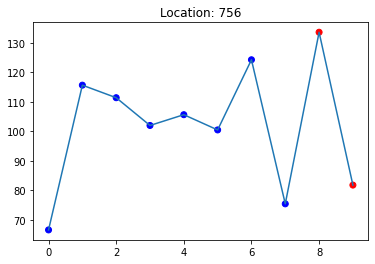

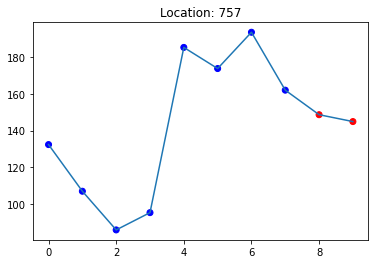

...

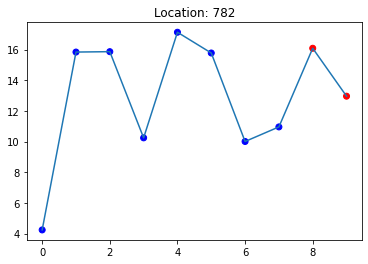

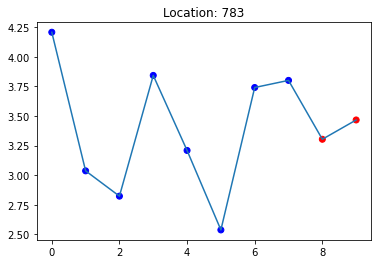

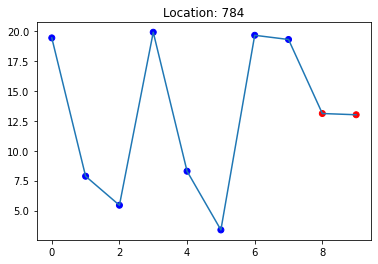

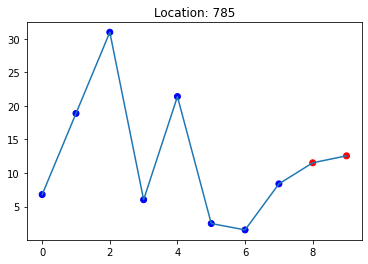

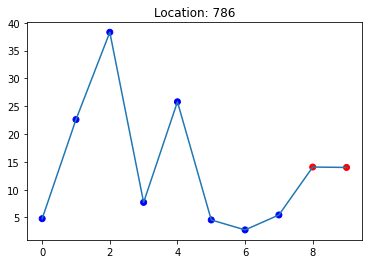

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


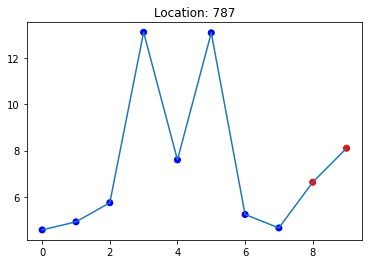

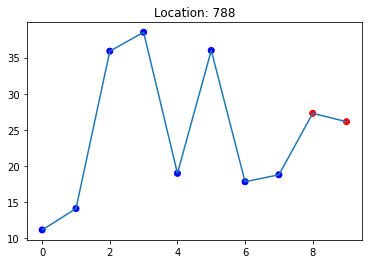

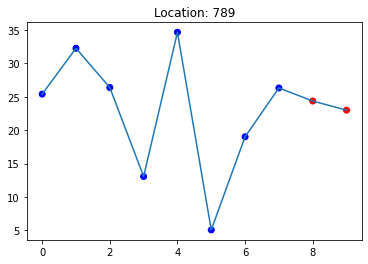

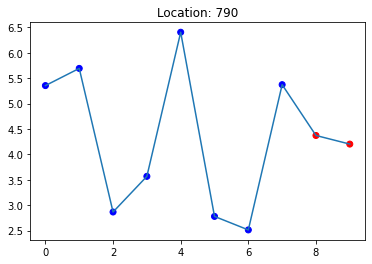

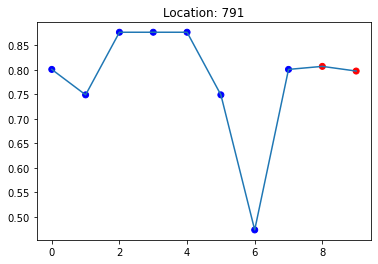

...

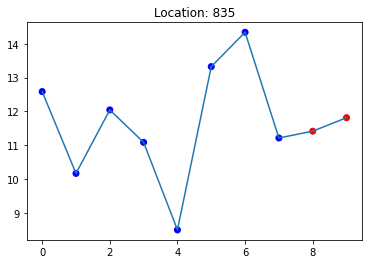

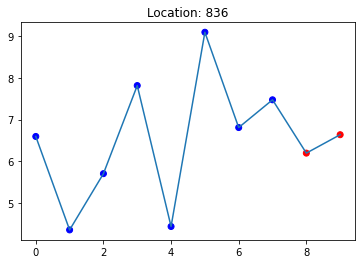

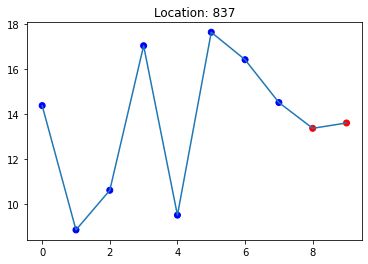

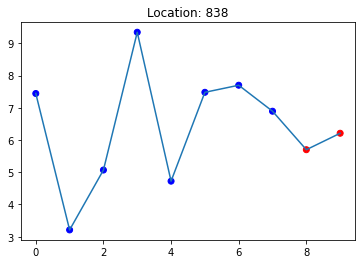

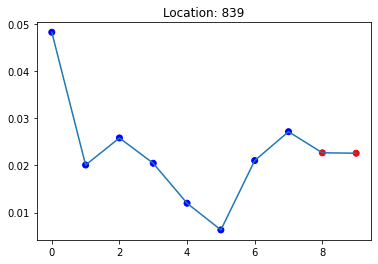

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


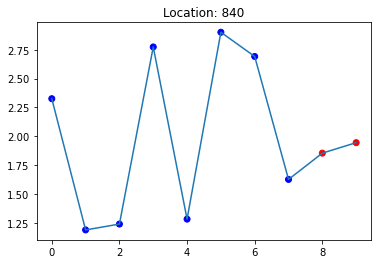

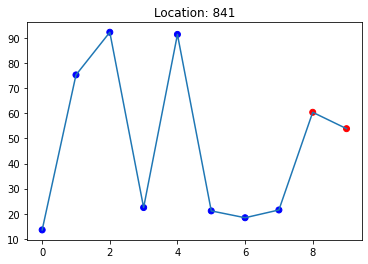

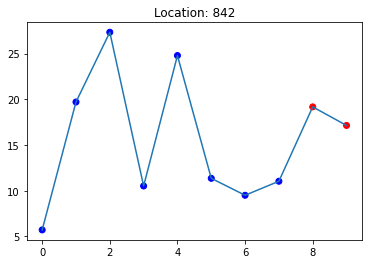

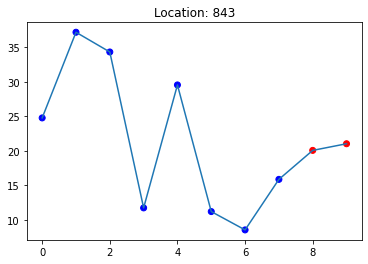

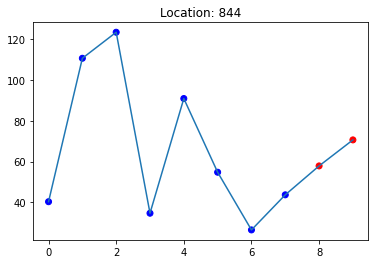

...

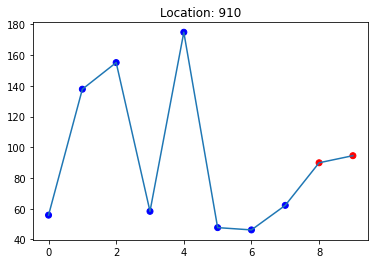

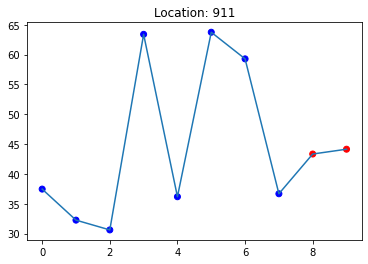

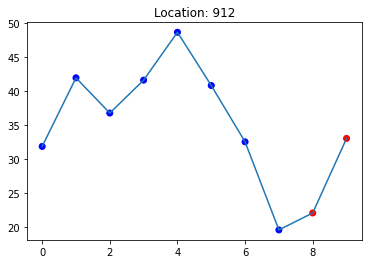

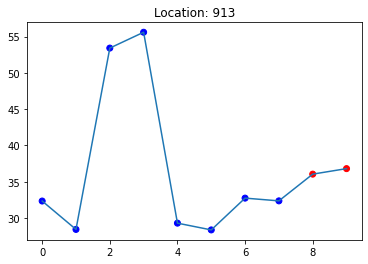

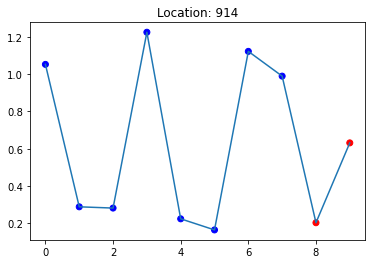

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


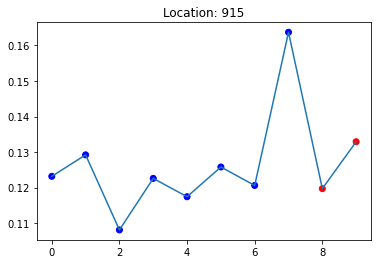

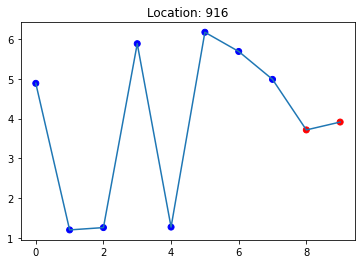

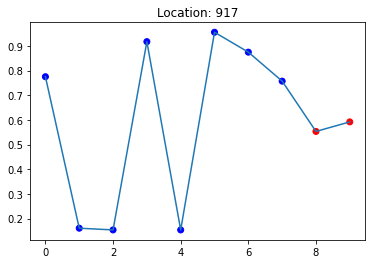

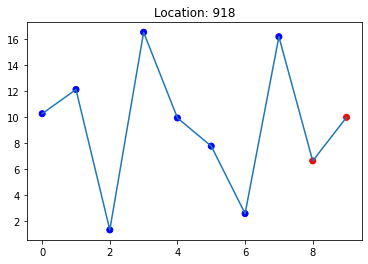

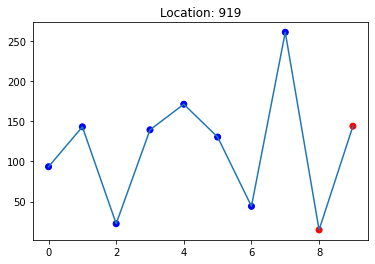

...

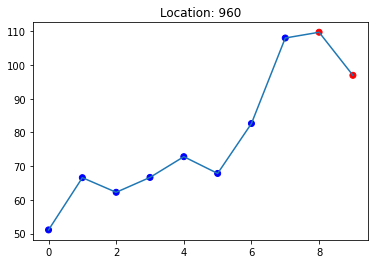

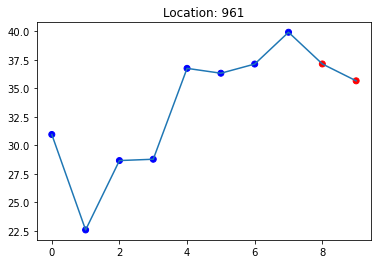

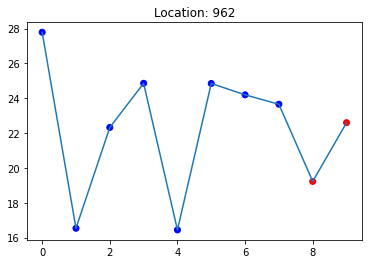

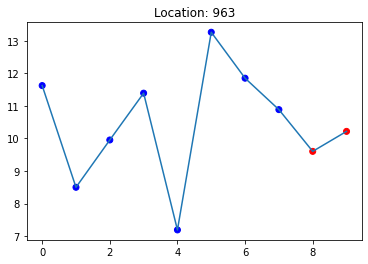

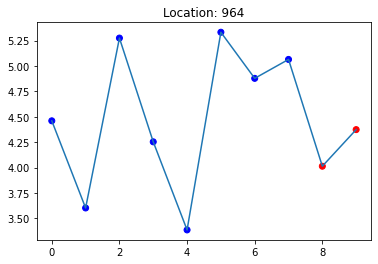

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


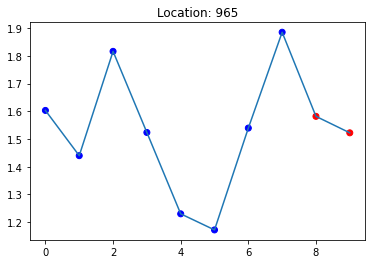

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


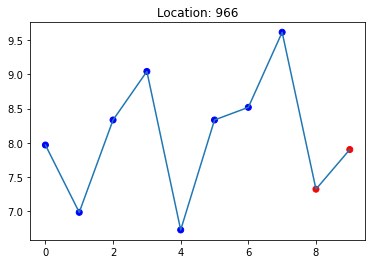

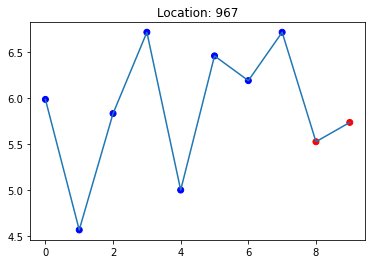

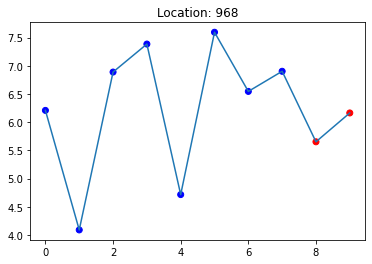

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


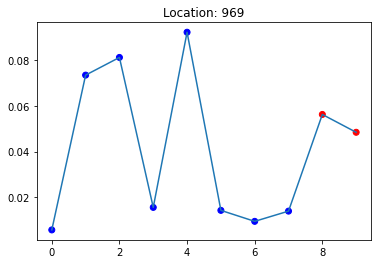

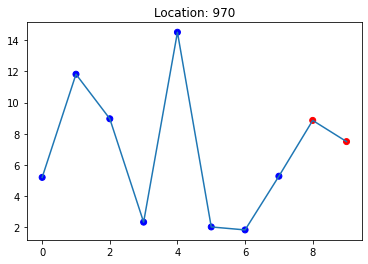

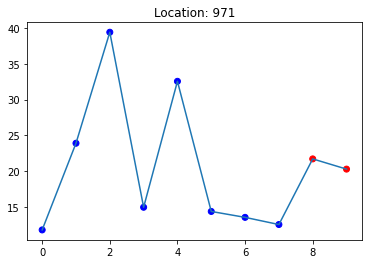

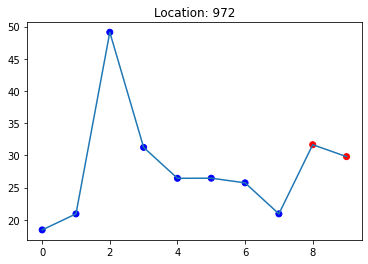

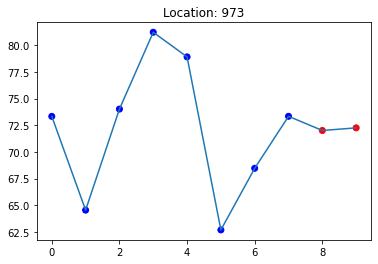

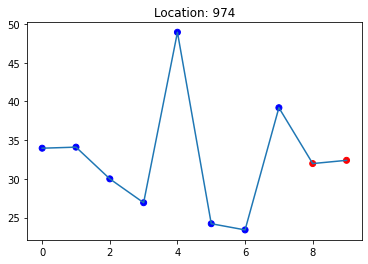

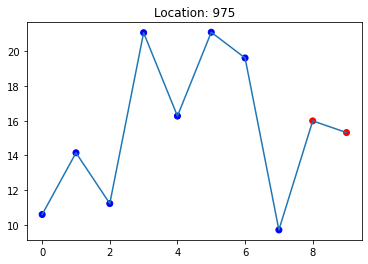

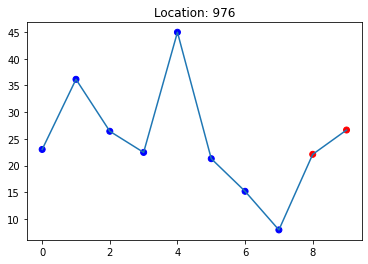

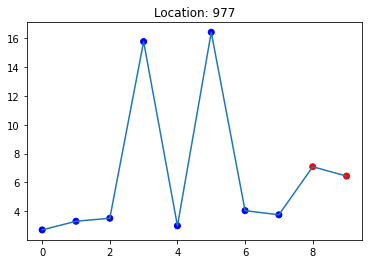

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


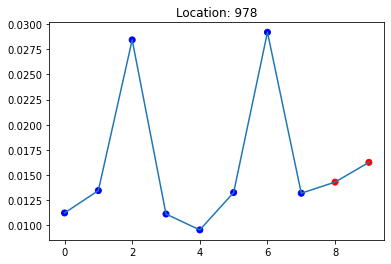

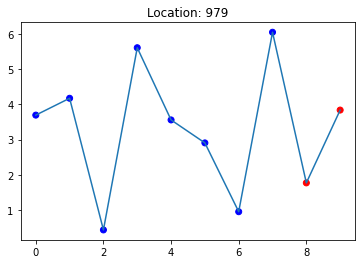

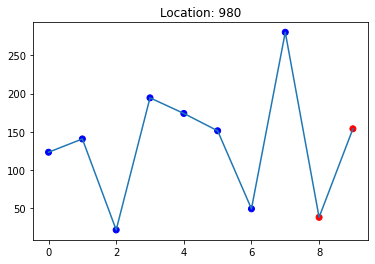

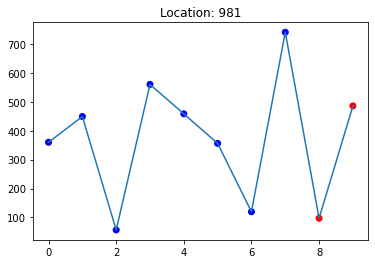

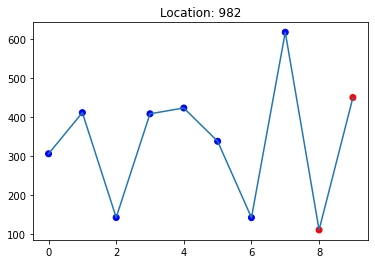

...

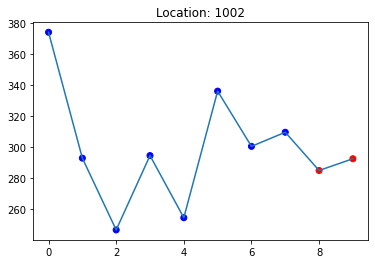

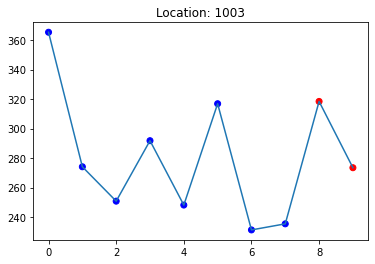

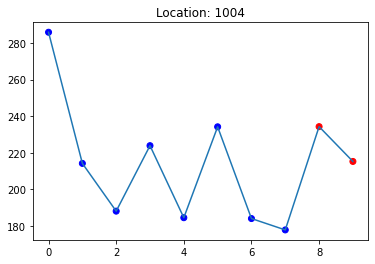

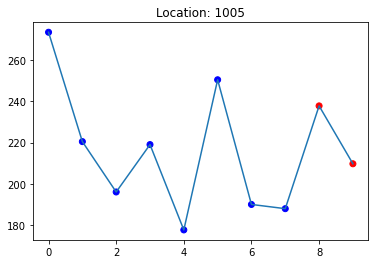

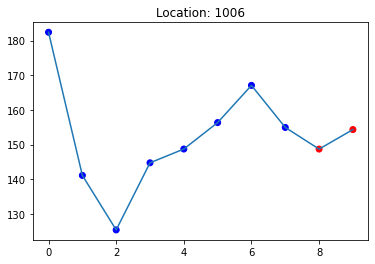

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


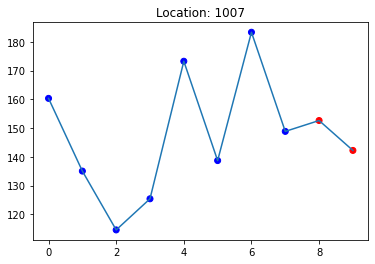

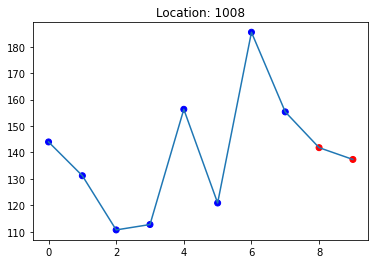

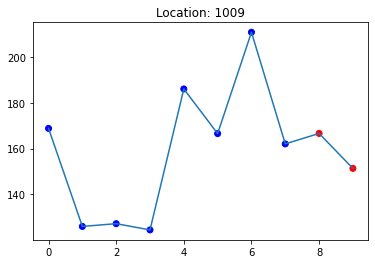

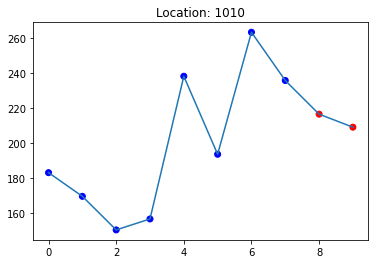

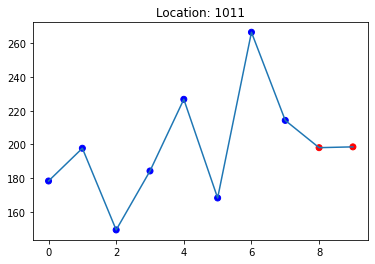

...

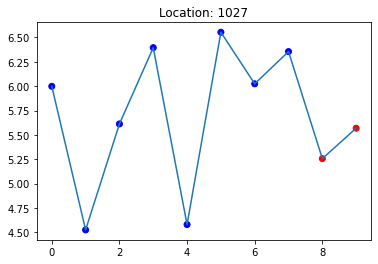

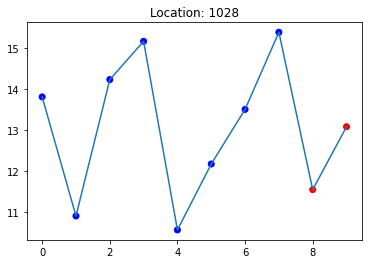

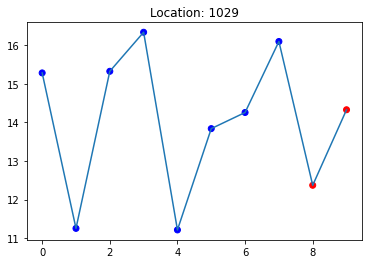

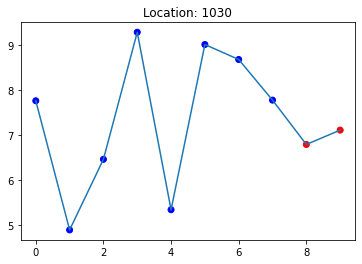

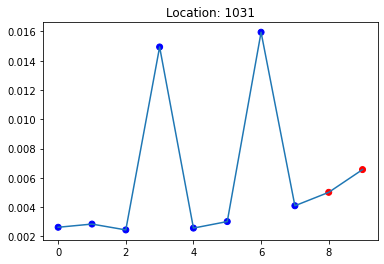

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


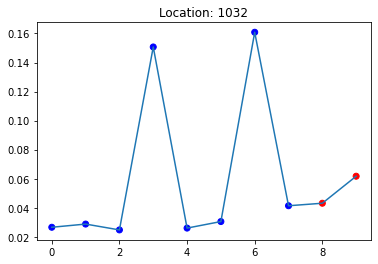

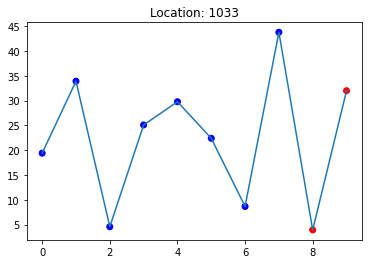

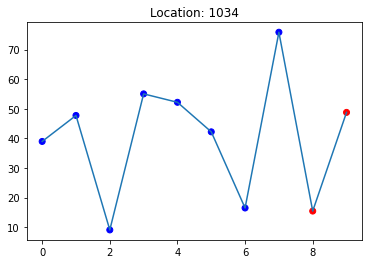

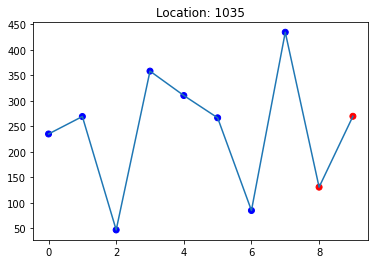

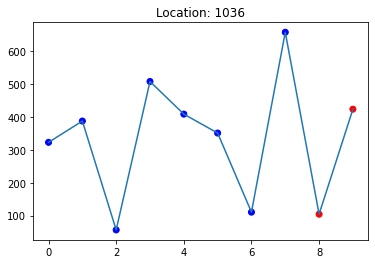

...

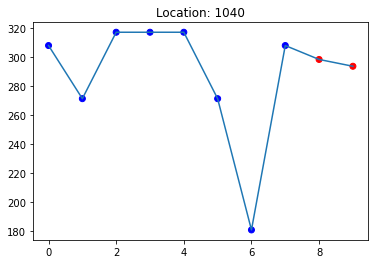

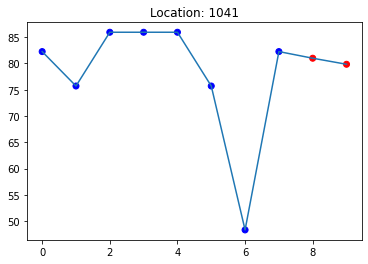

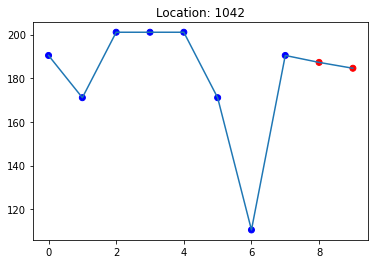

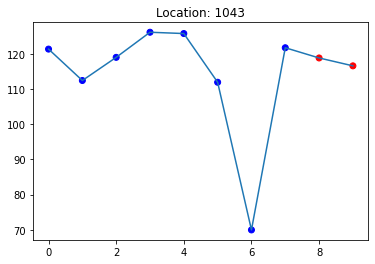

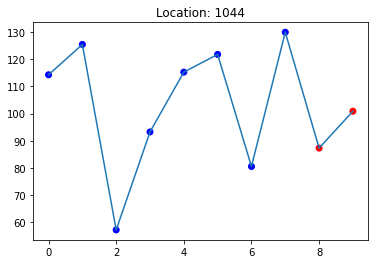

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


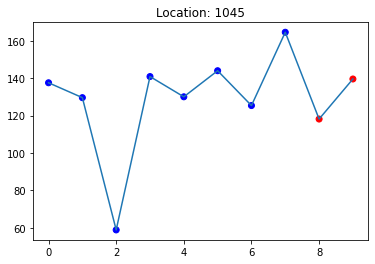

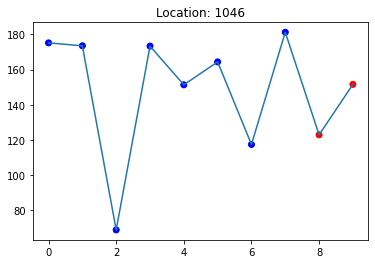

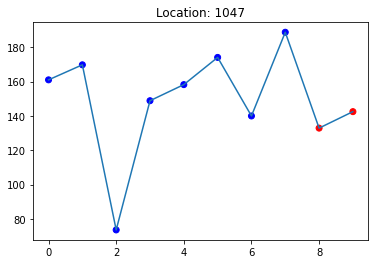

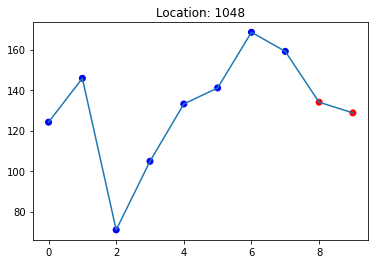

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


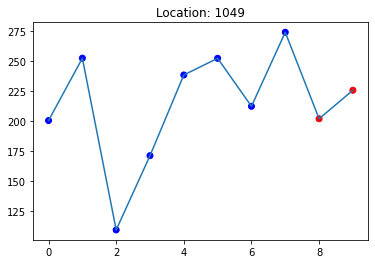

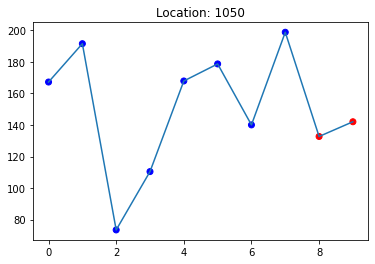

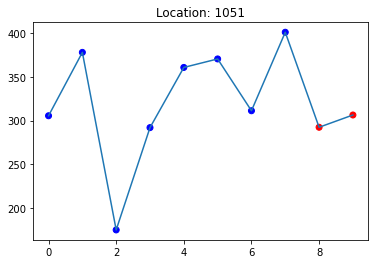

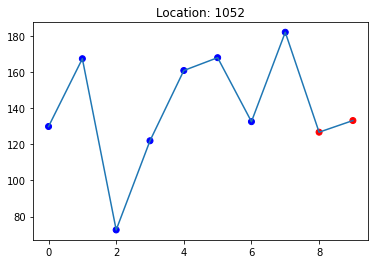

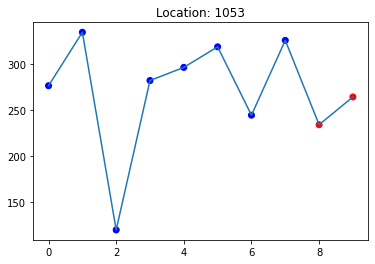

...

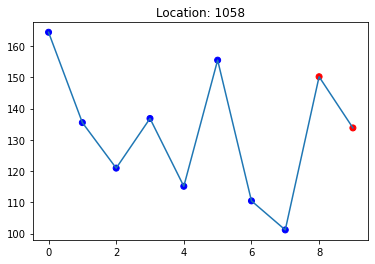

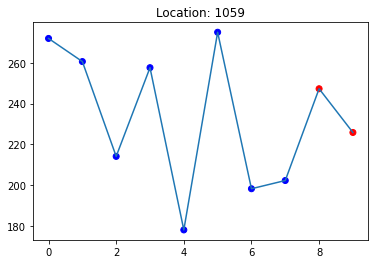

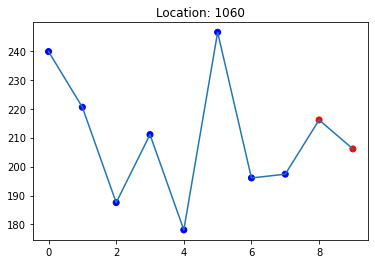

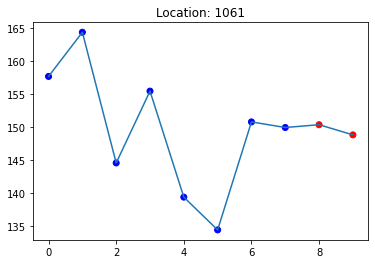

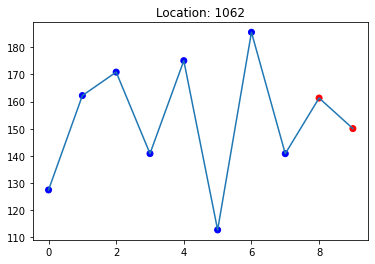

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


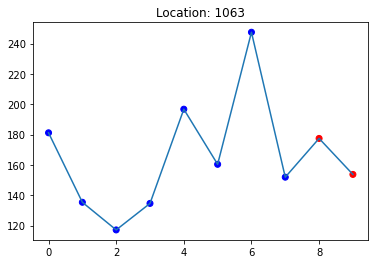

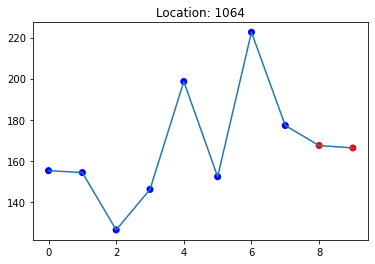

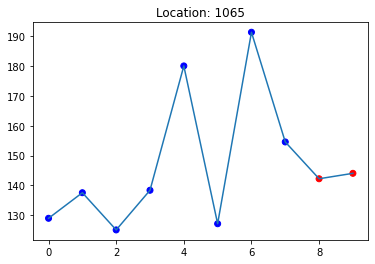

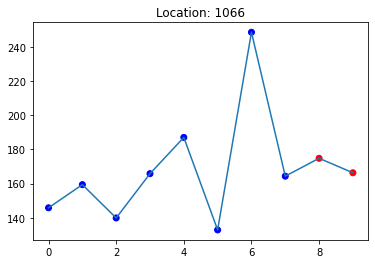

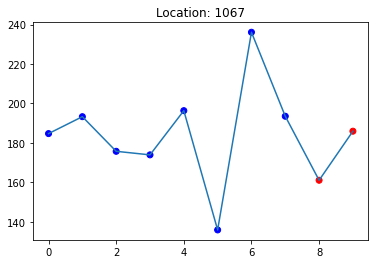

...

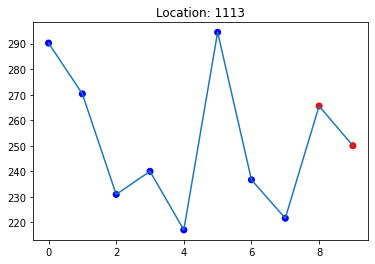

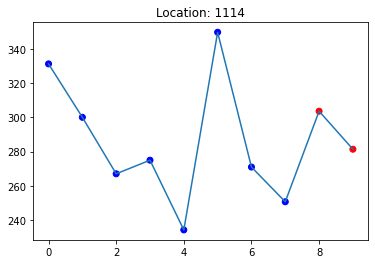

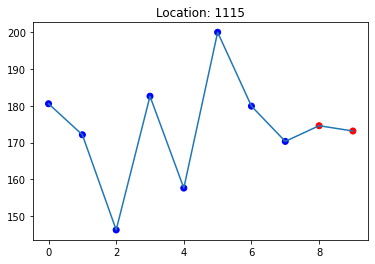

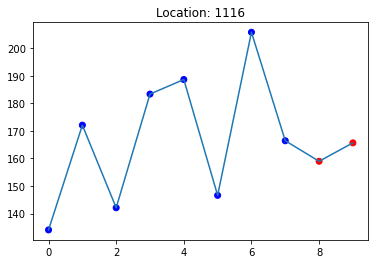

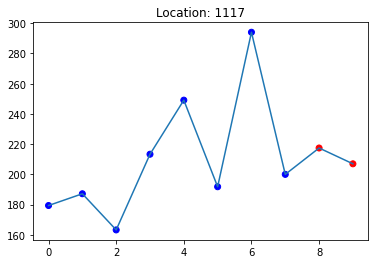

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


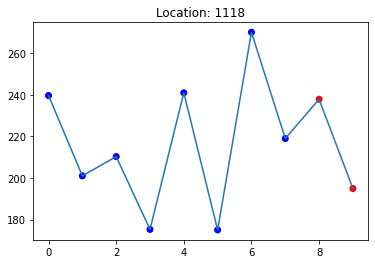

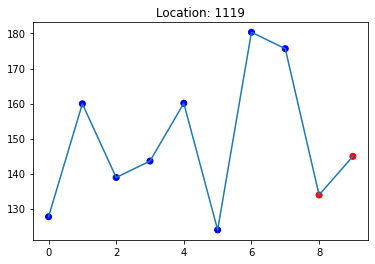

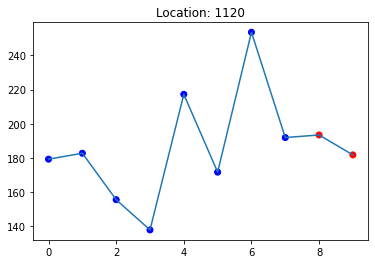

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


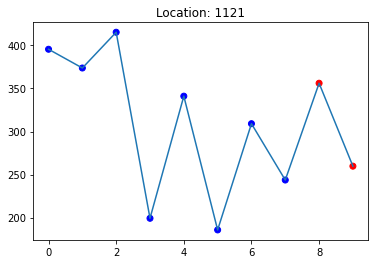

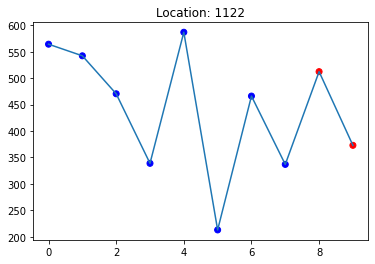

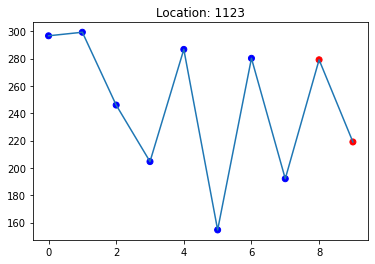

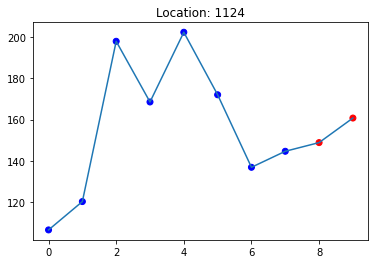

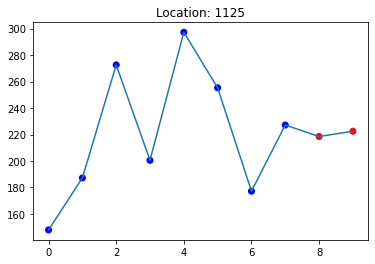

...

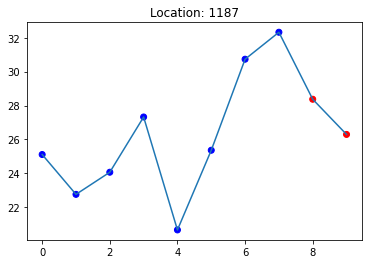

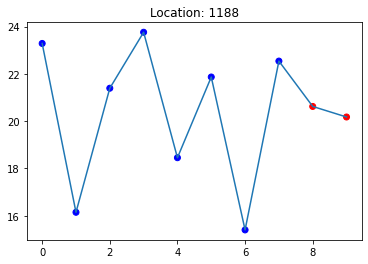

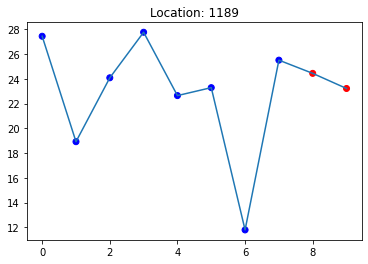

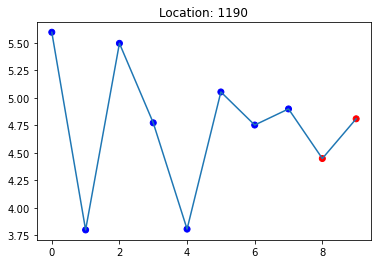

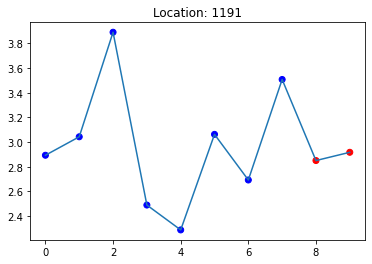

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


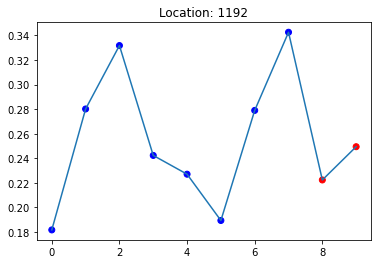

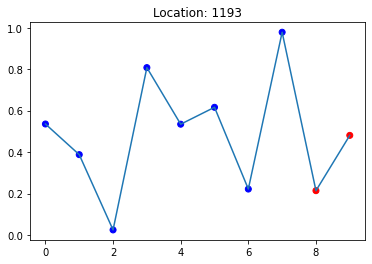

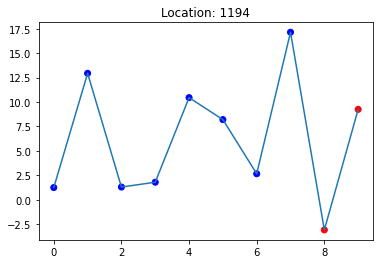

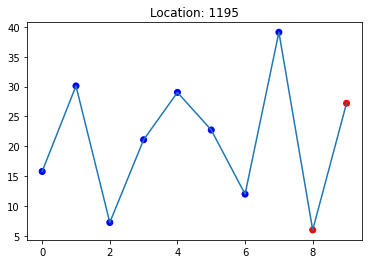

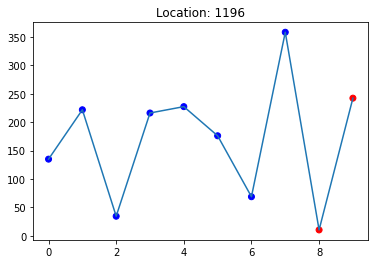

...

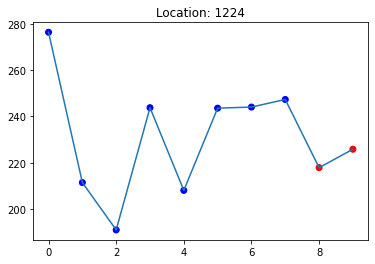

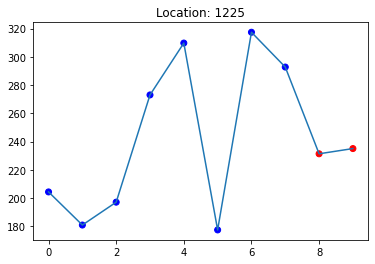

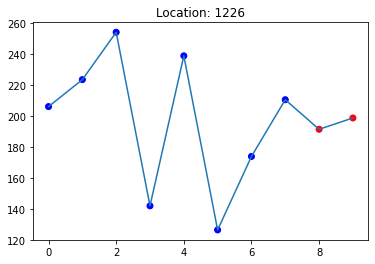

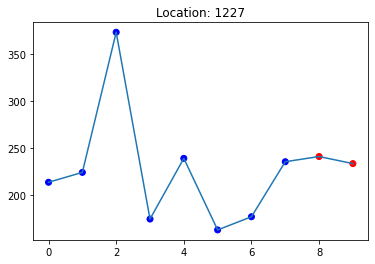

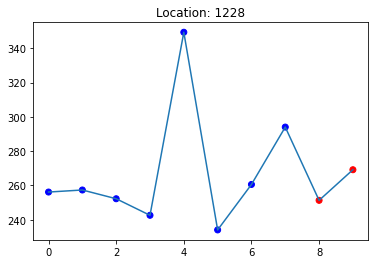

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


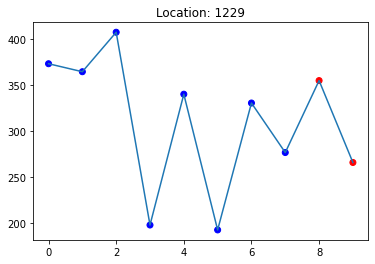

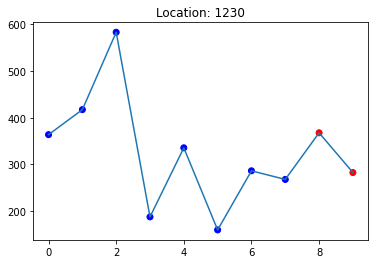

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


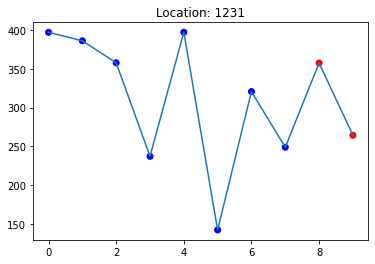

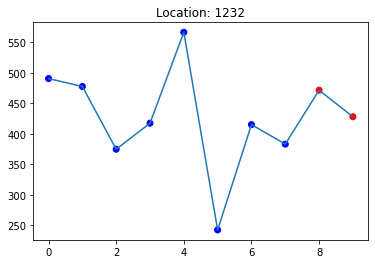

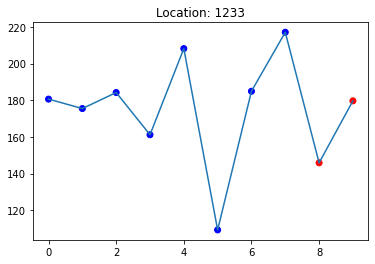

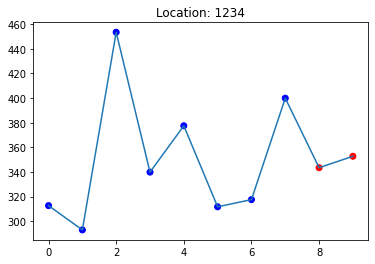

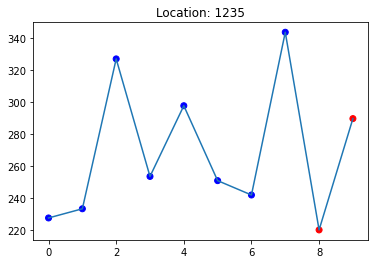

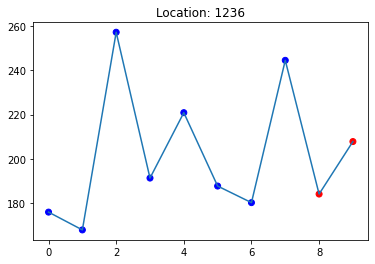

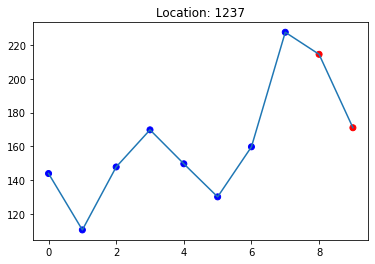

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


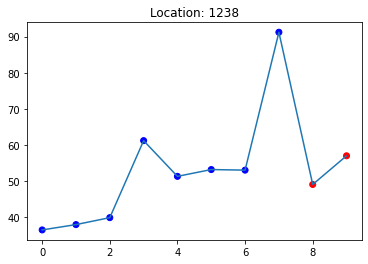

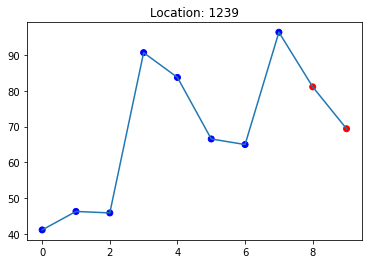

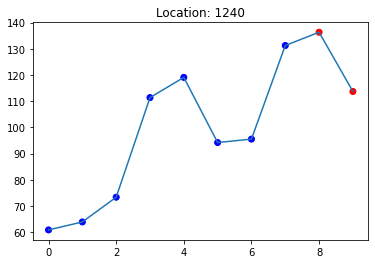

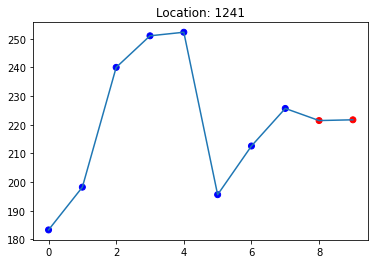

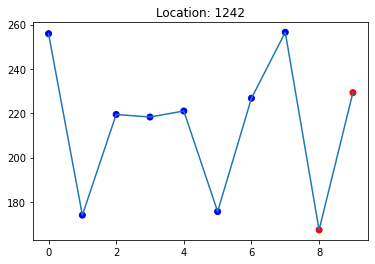

...

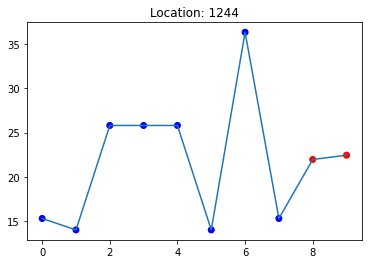

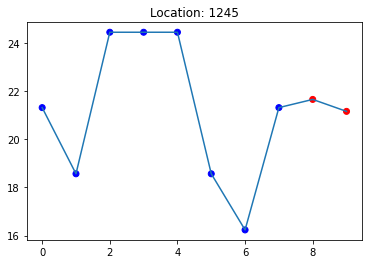

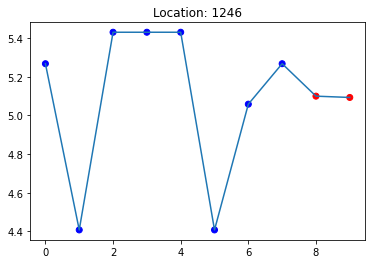

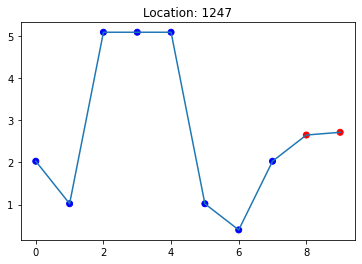

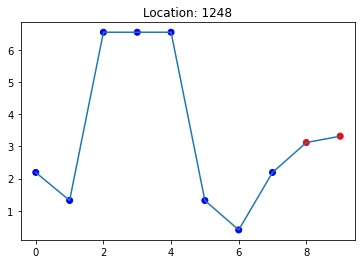

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


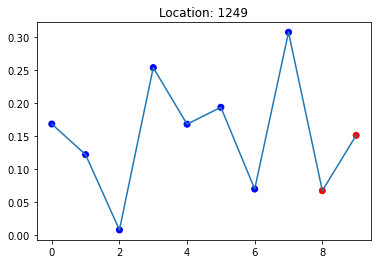

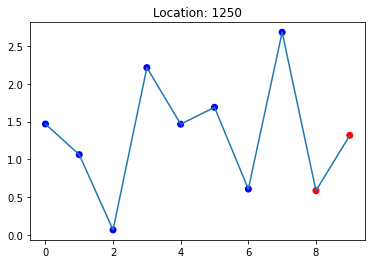

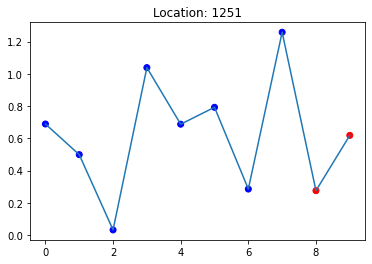

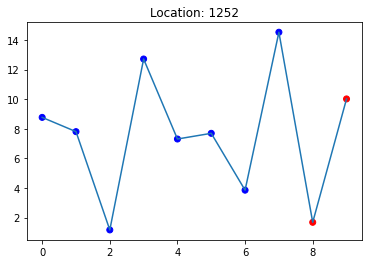

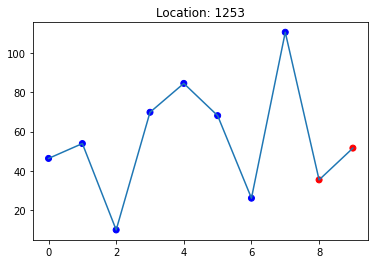

...

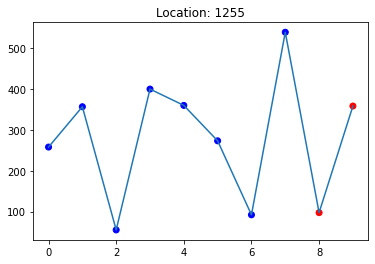

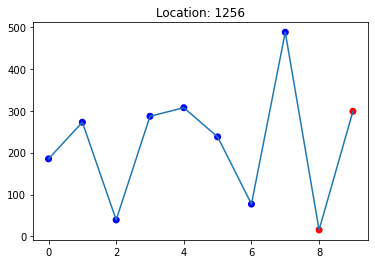

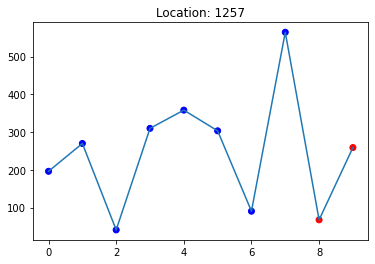

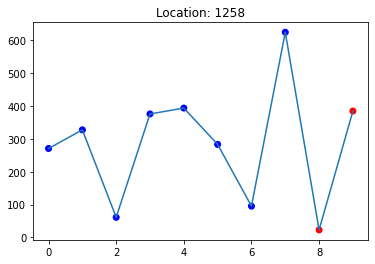

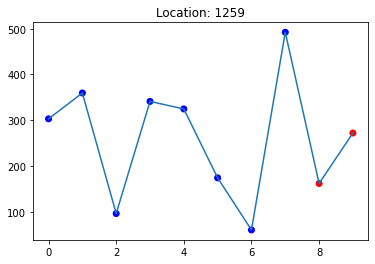

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


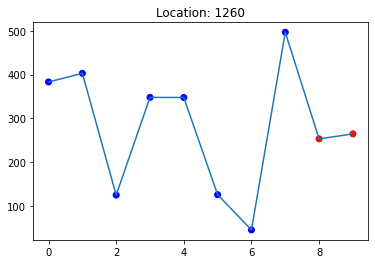

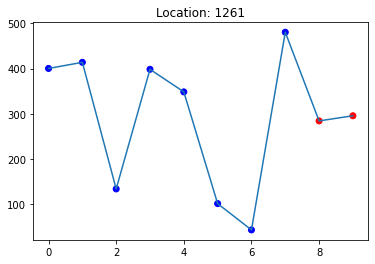

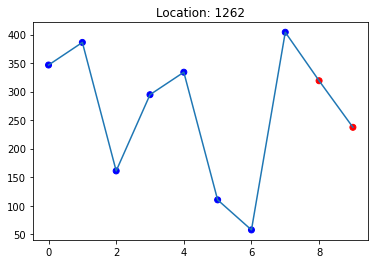

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


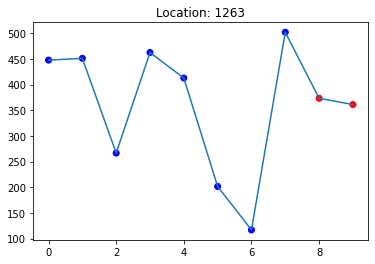

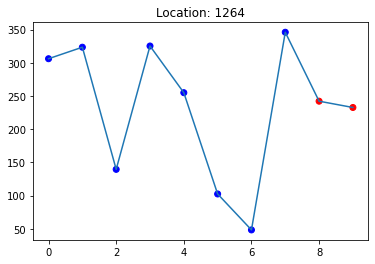

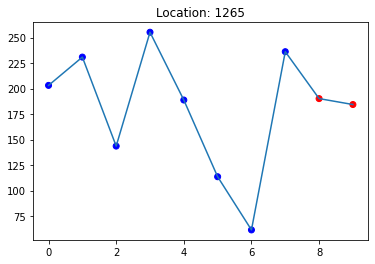

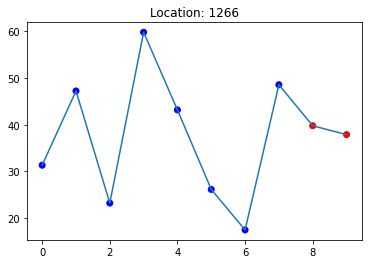

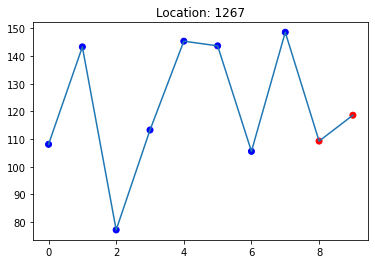

...

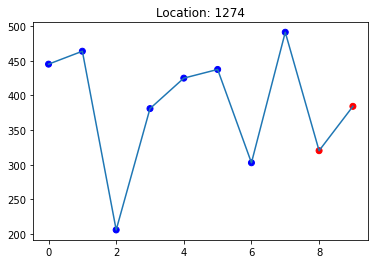

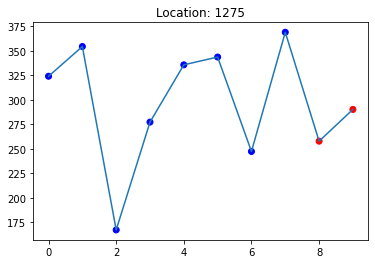

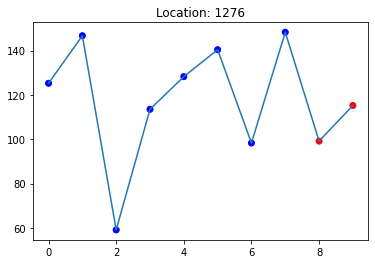

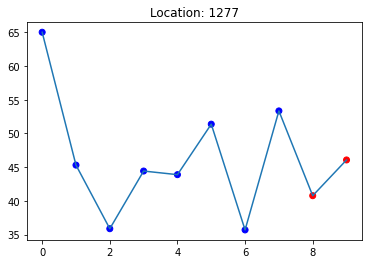

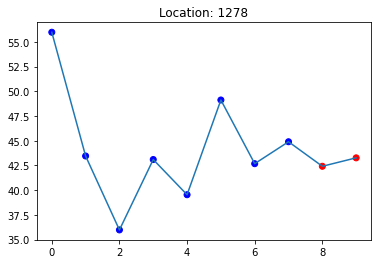

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


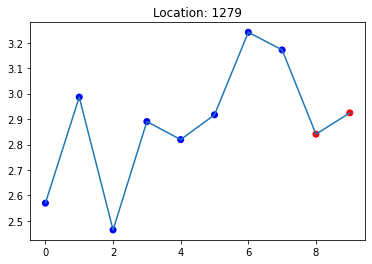

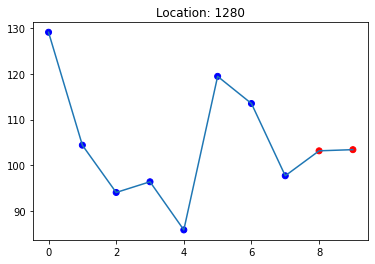

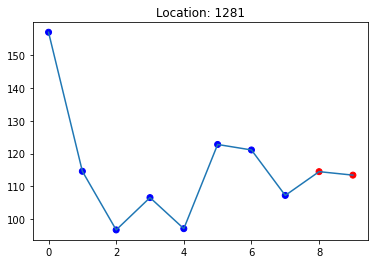

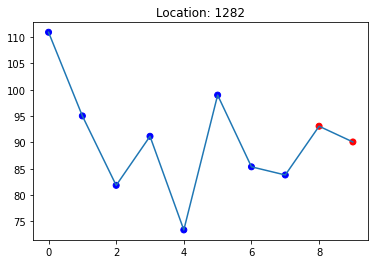

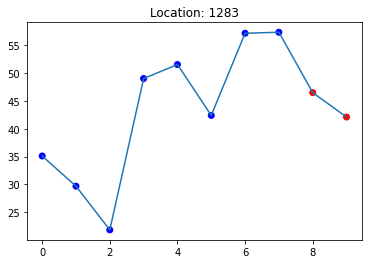

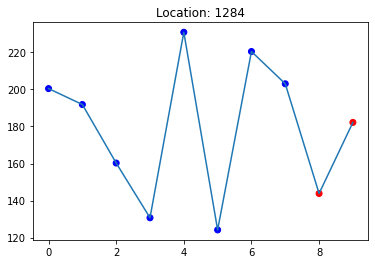

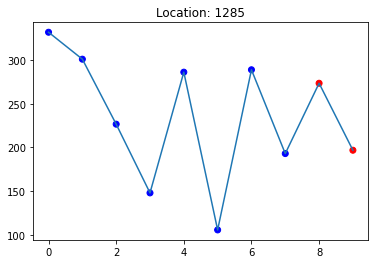

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


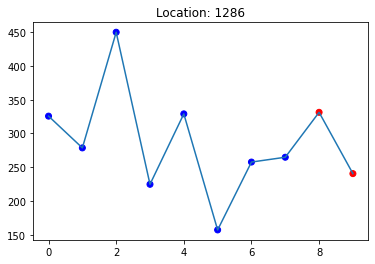

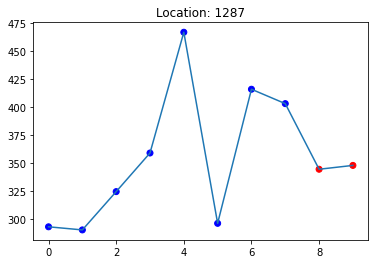

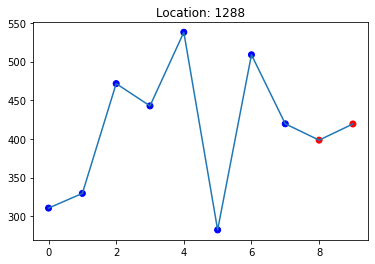

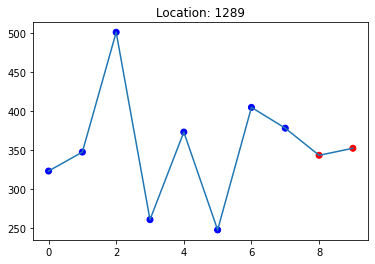

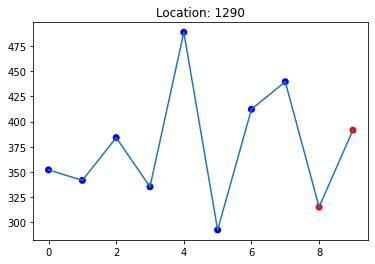

...

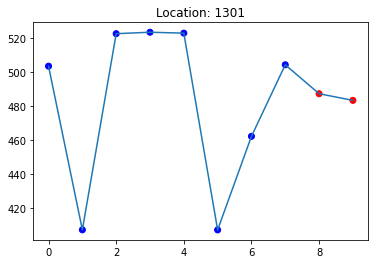

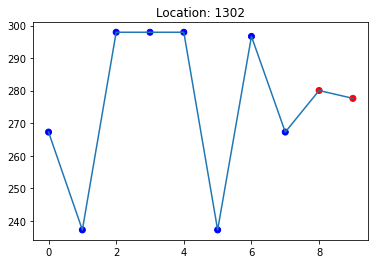

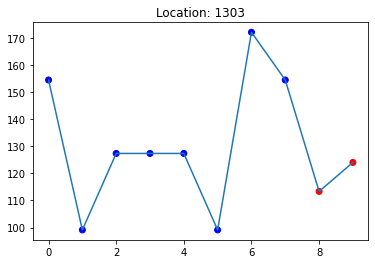

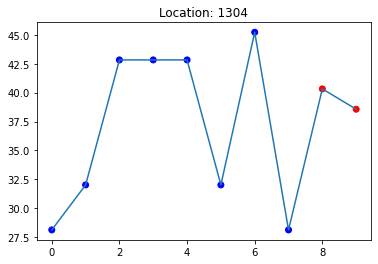

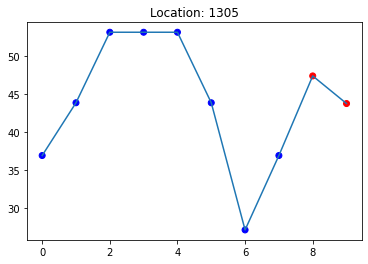

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


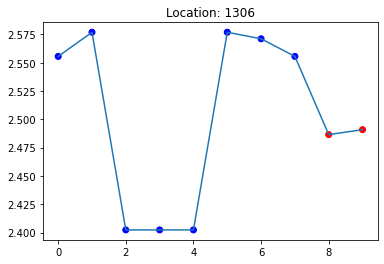

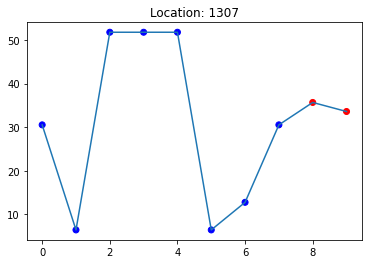

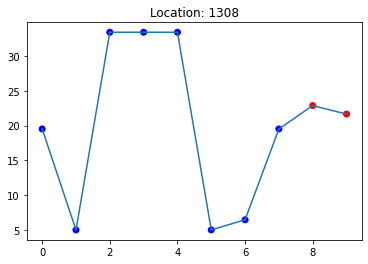

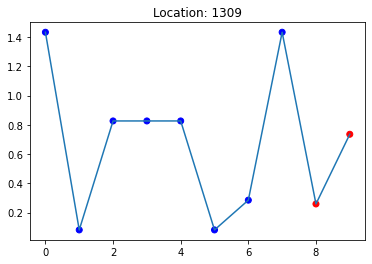

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


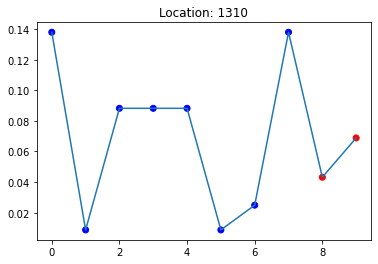

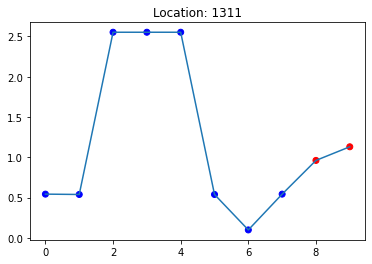

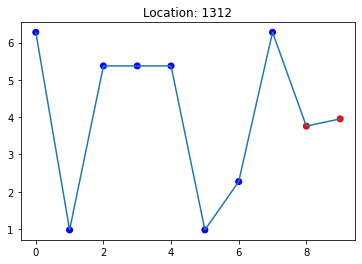

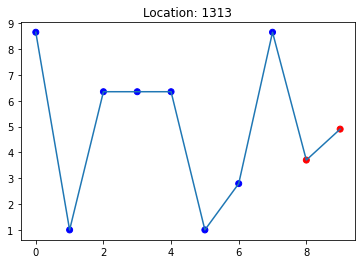

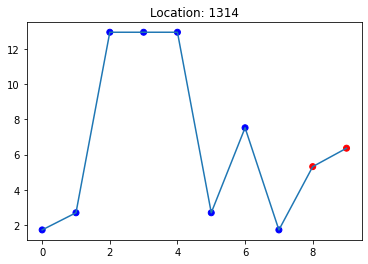

...

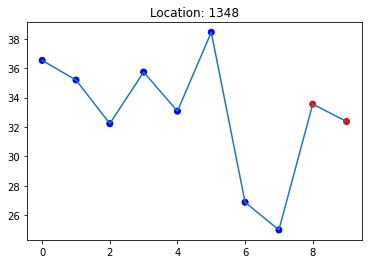

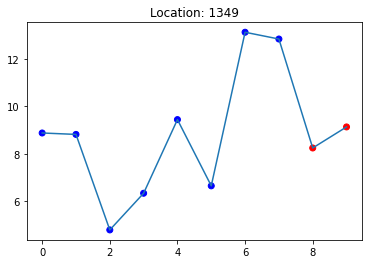

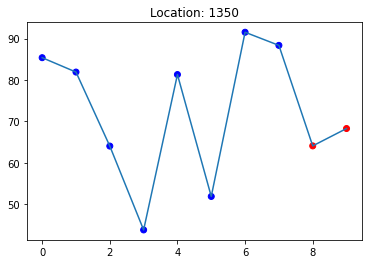

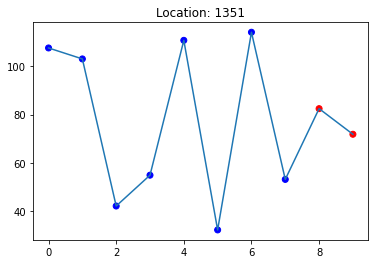

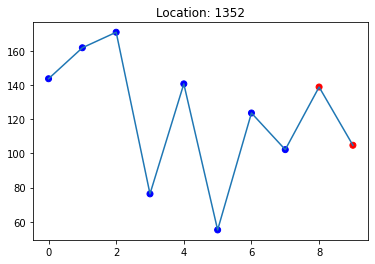

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


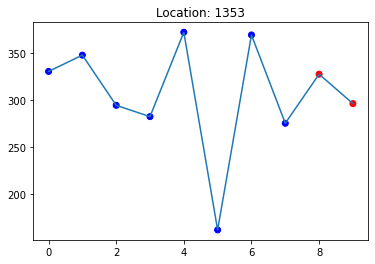

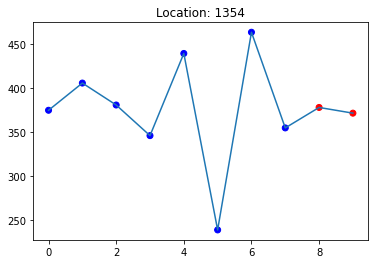

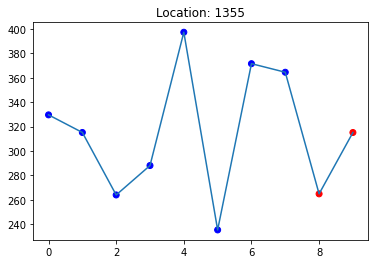

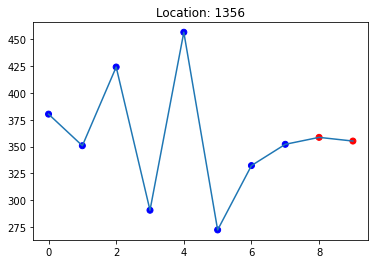

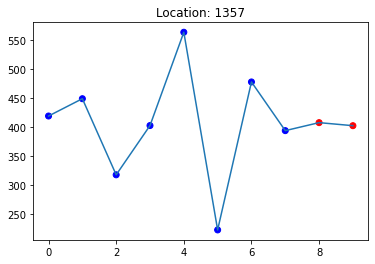

...

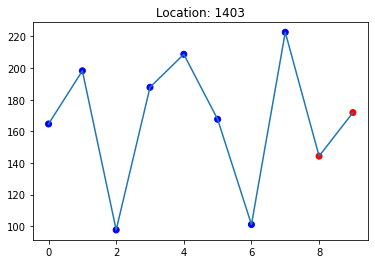

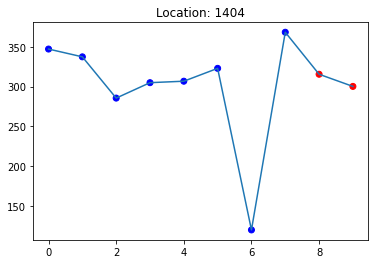

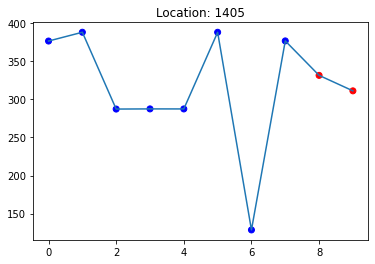

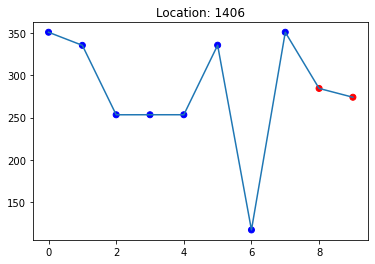

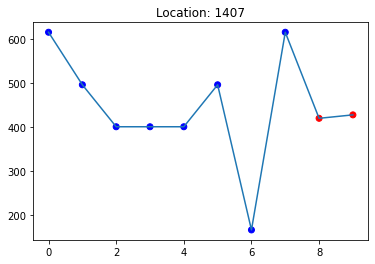

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


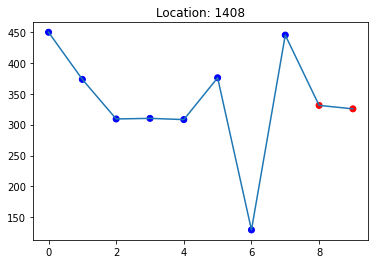

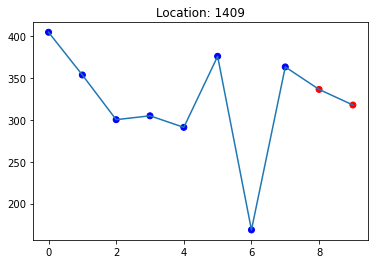

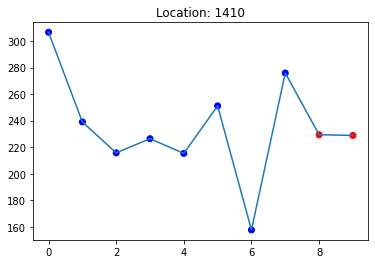

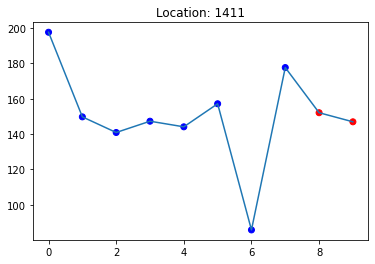

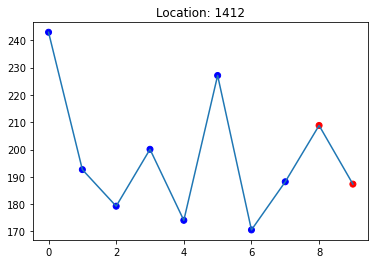

...

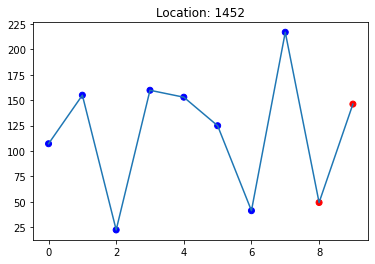

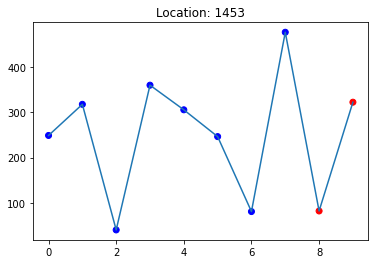

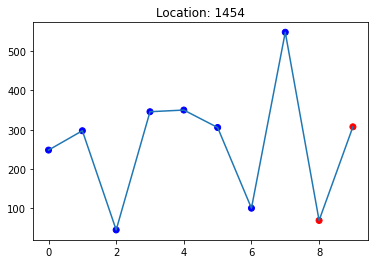

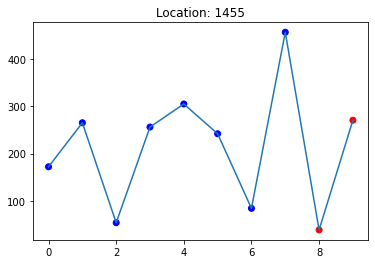

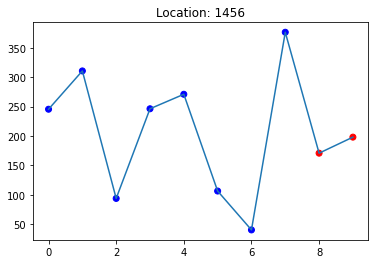

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


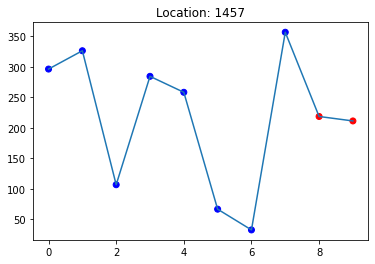

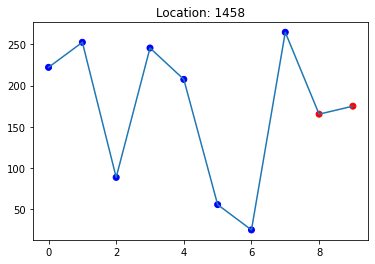

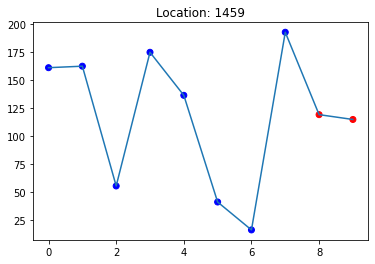

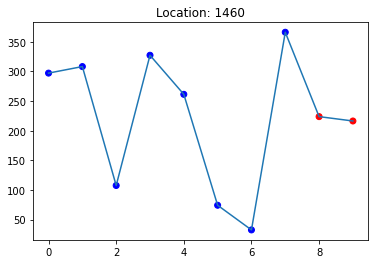

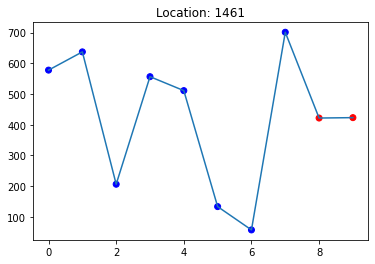

...

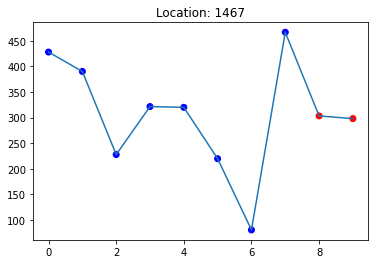

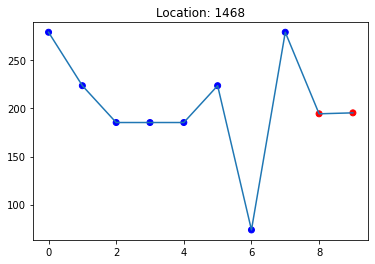

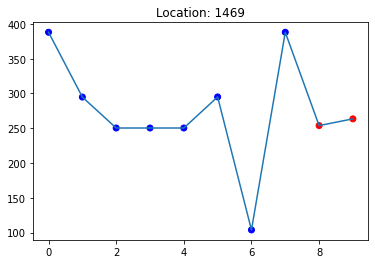

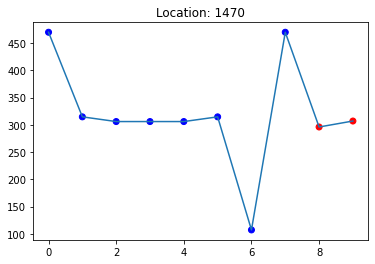

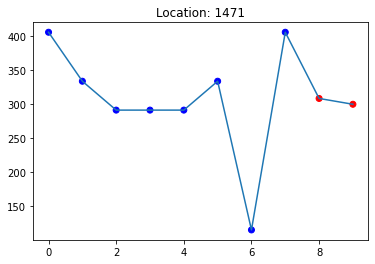

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


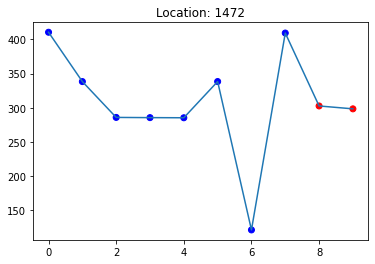

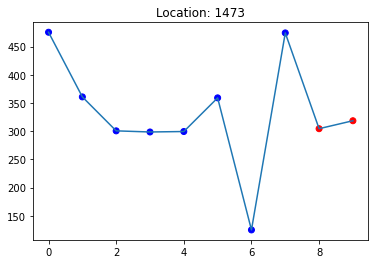

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


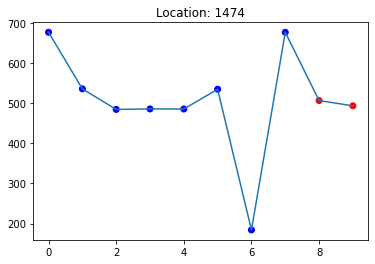

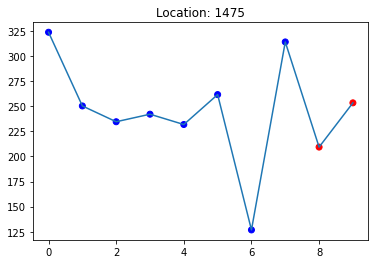

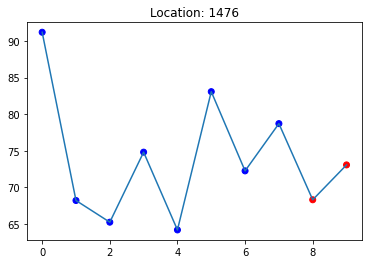

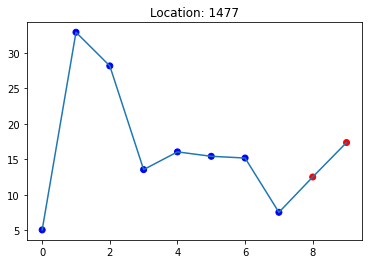

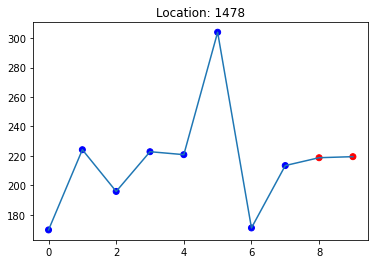

...

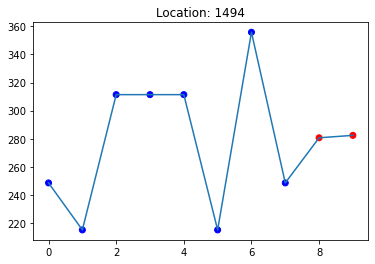

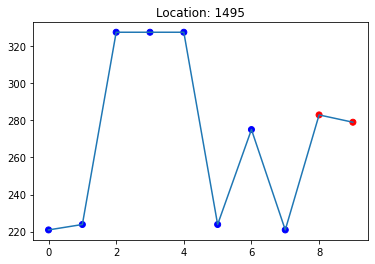

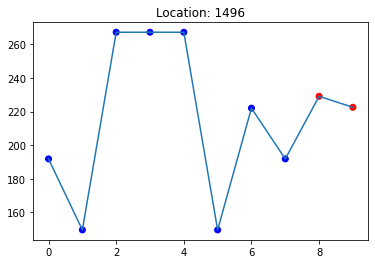

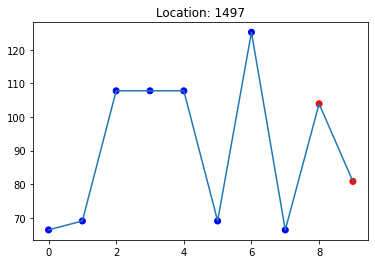

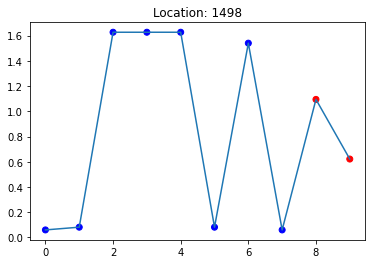

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


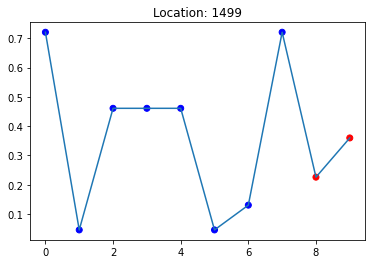

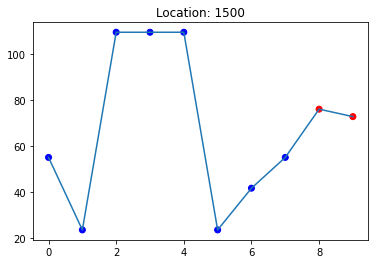

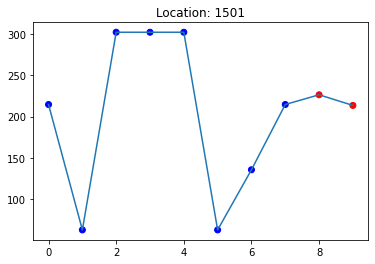

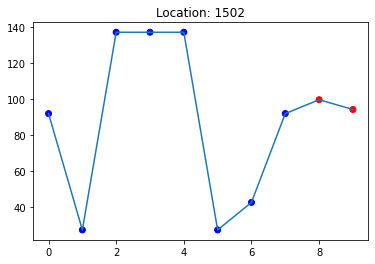

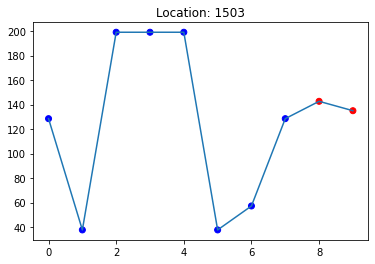

...

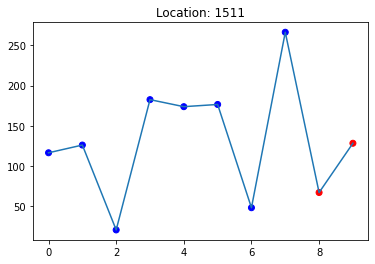

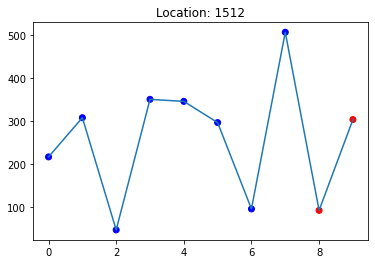

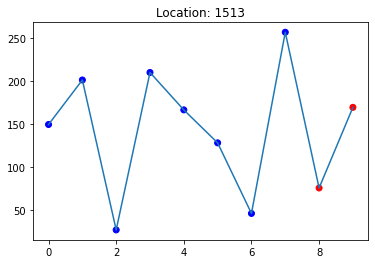

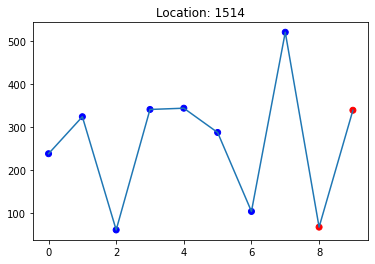

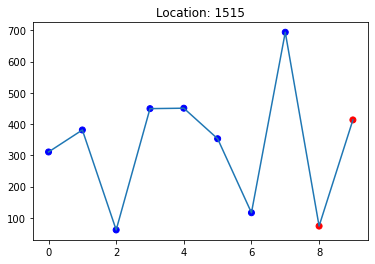

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


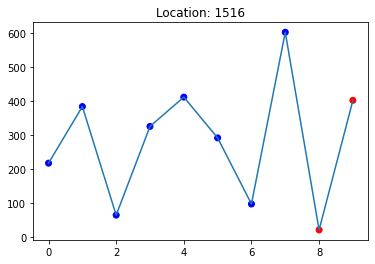

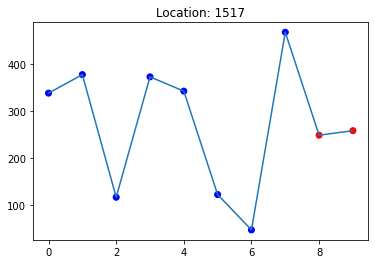

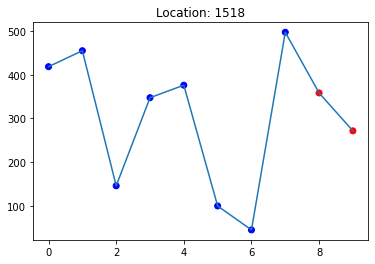

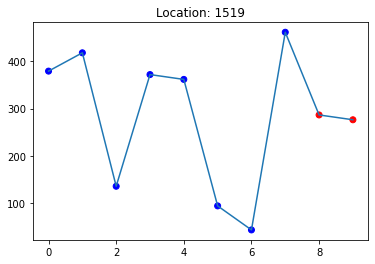

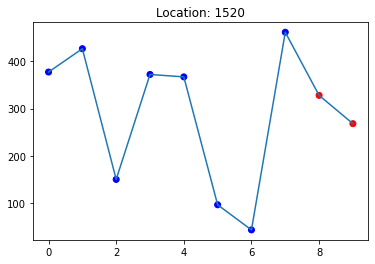

...

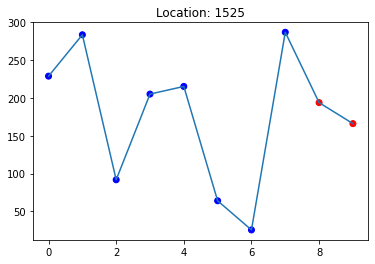

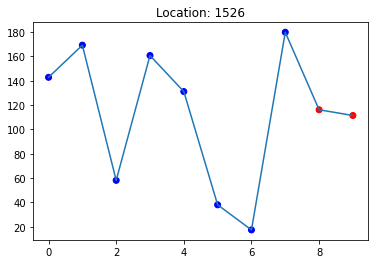

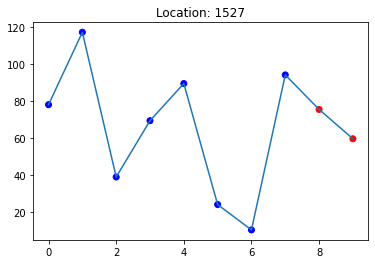

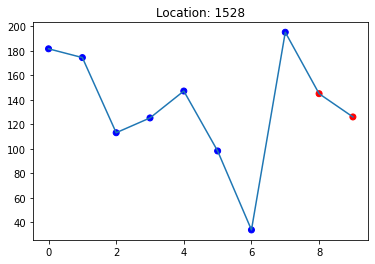

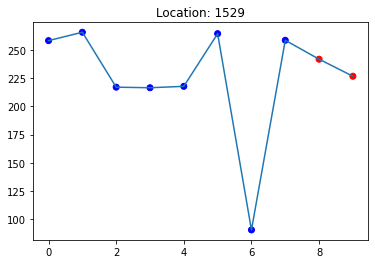

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


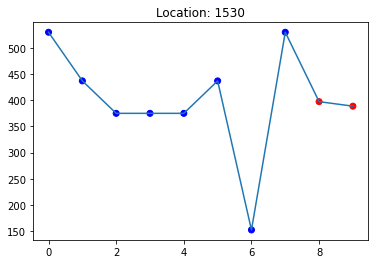

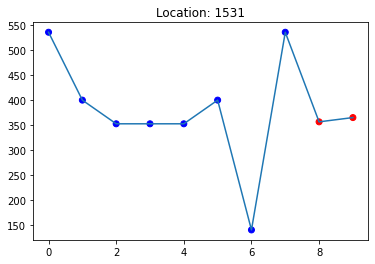

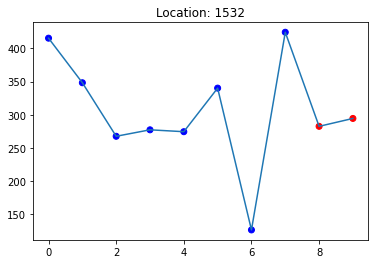

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


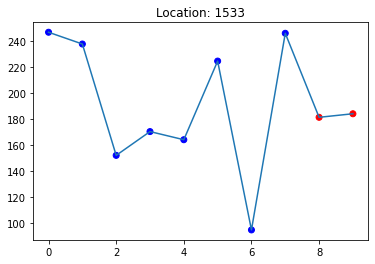

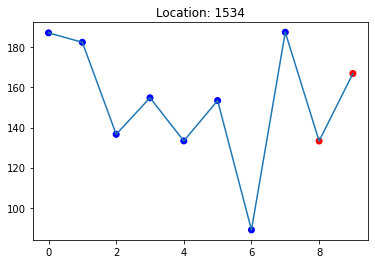

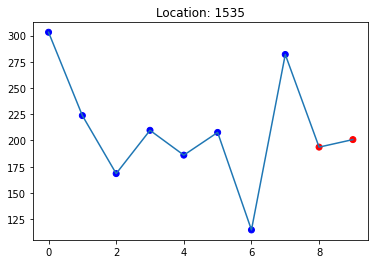

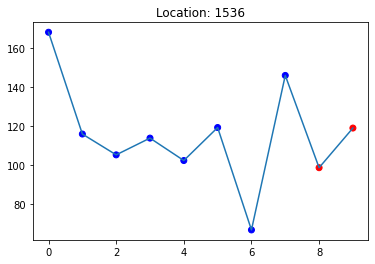

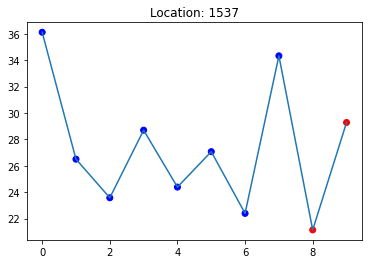

...

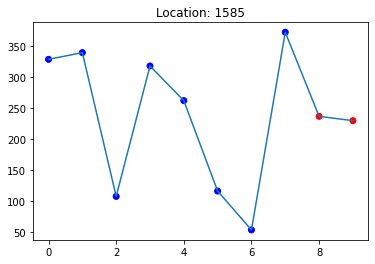

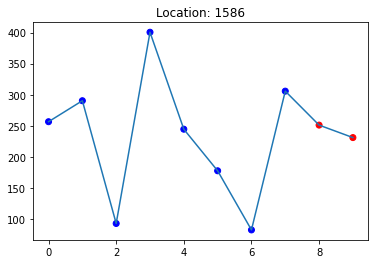

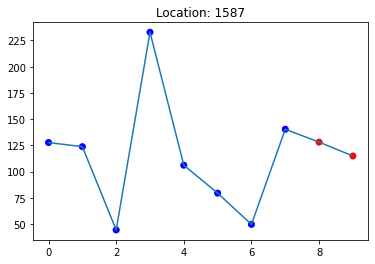

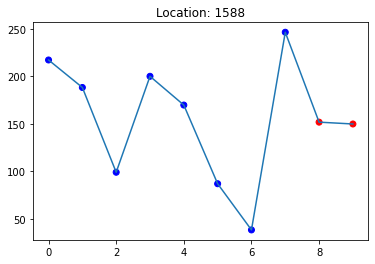

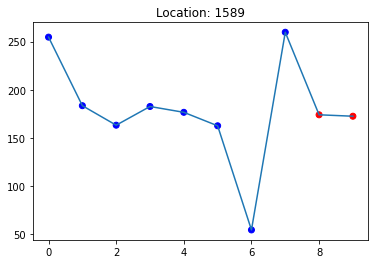

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


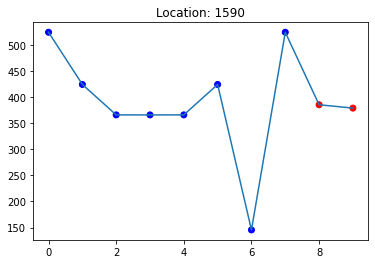

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


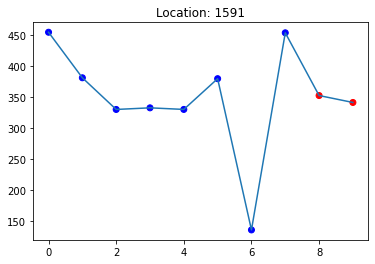

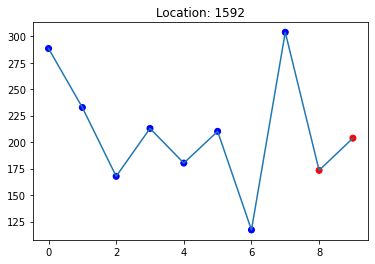

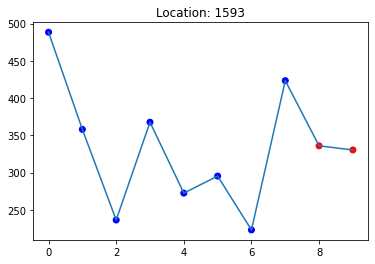

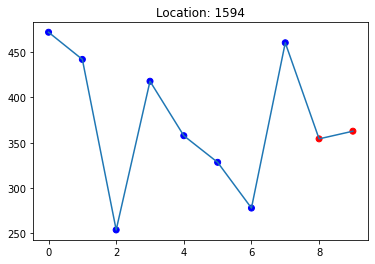

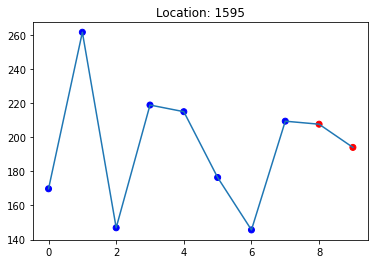

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


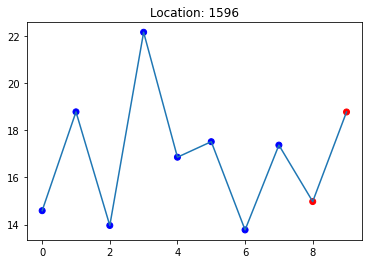

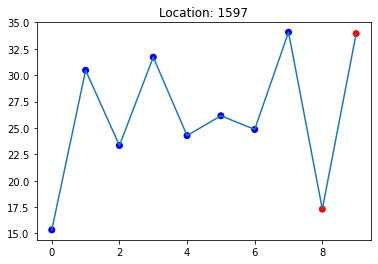

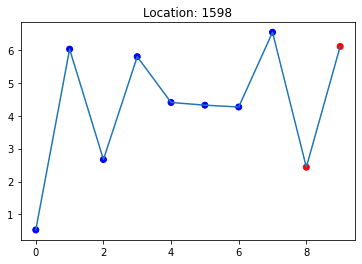

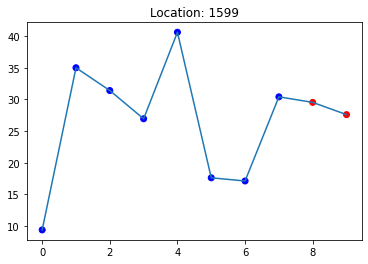

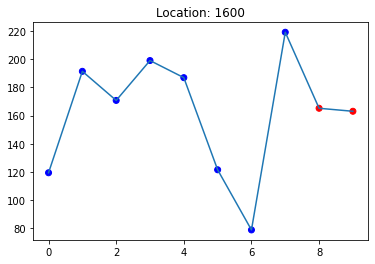

...

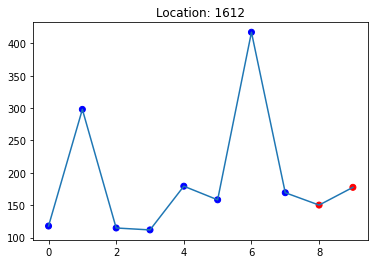

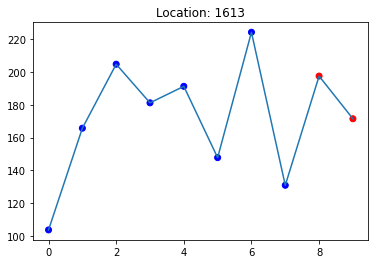

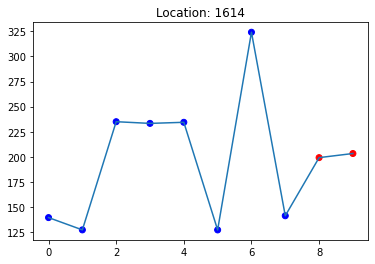

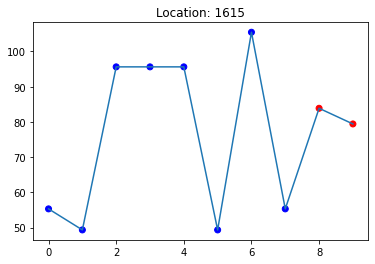

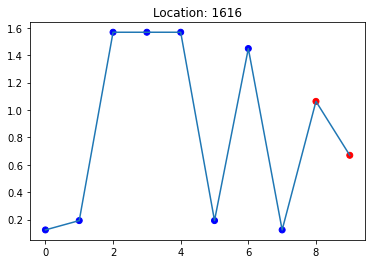

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


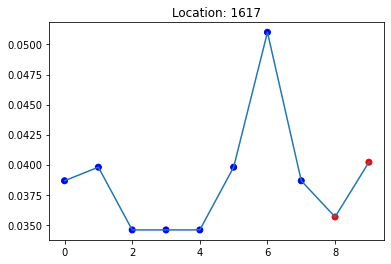

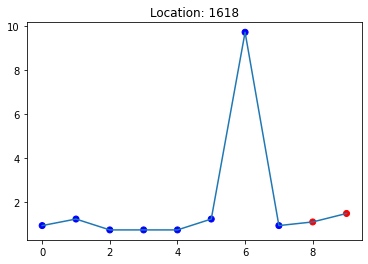

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


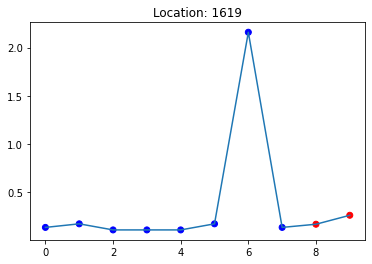

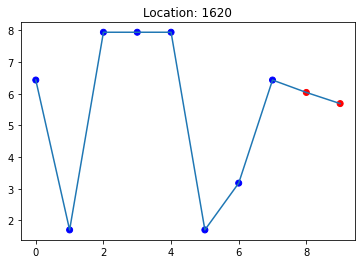

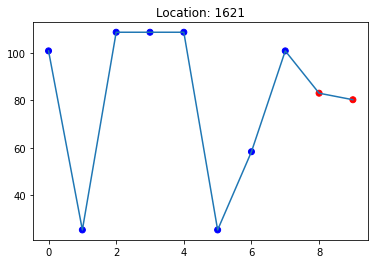

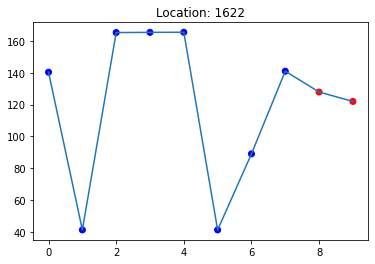

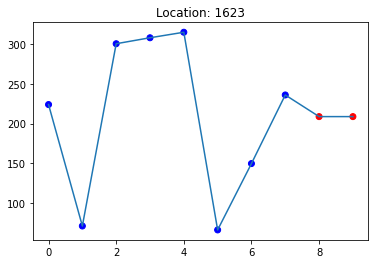

...

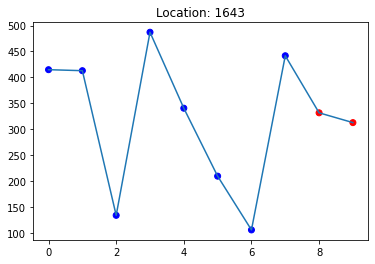

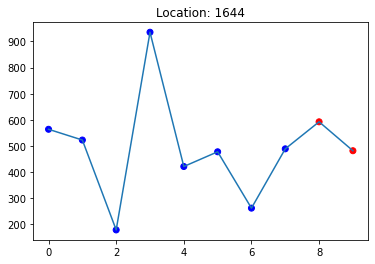

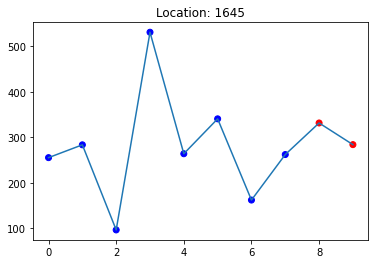

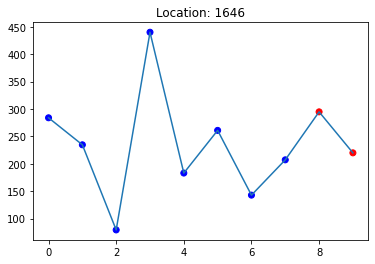

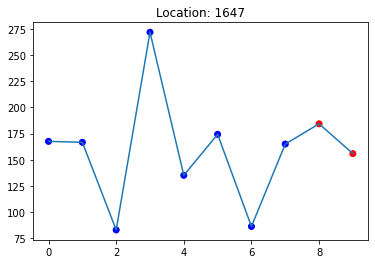

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


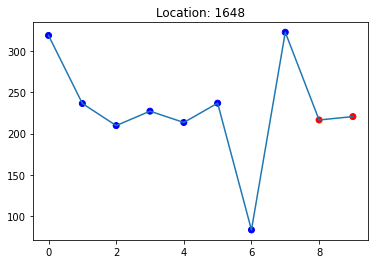

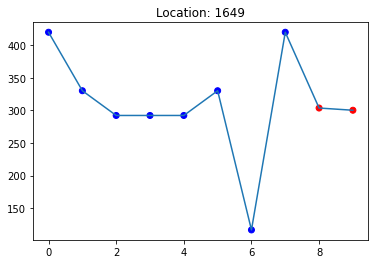

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


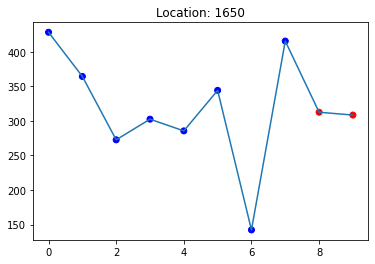

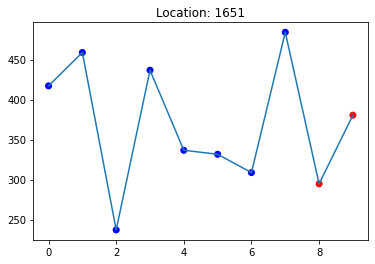

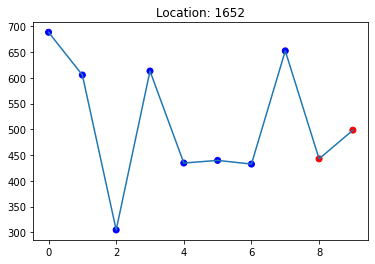

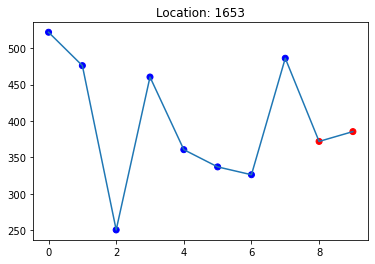

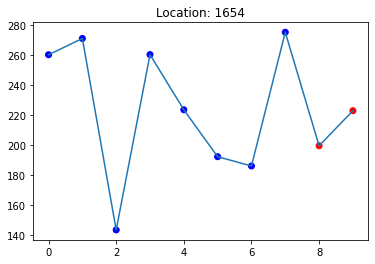

...

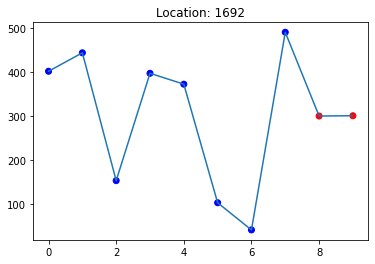

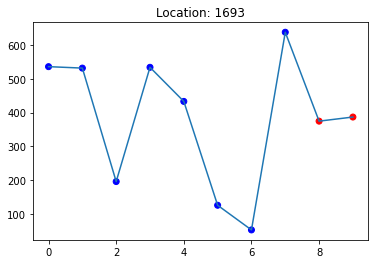

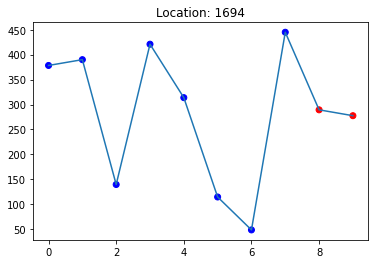

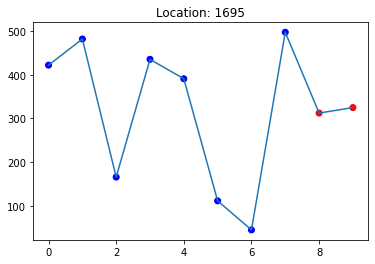

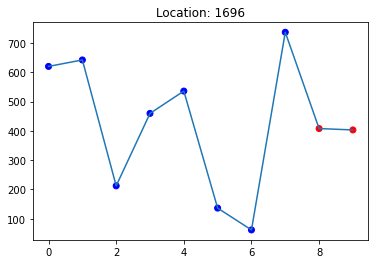

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


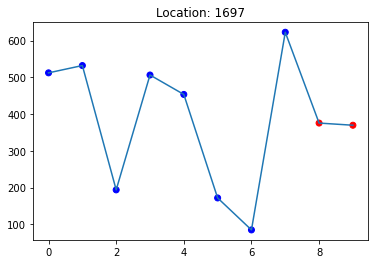

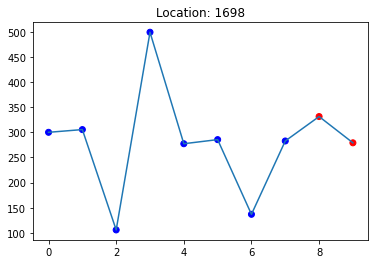

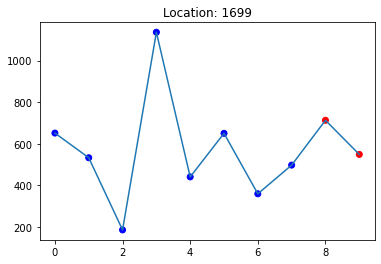

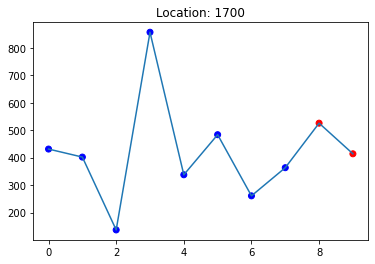

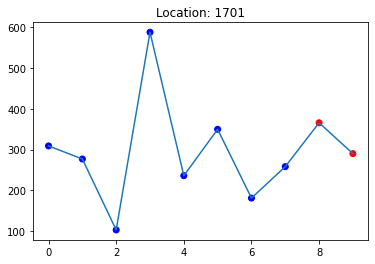

...

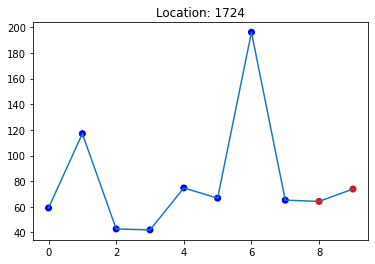

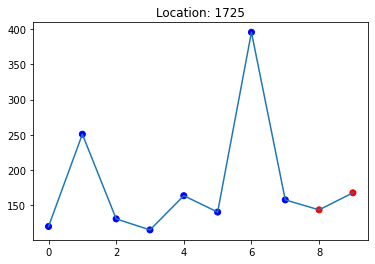

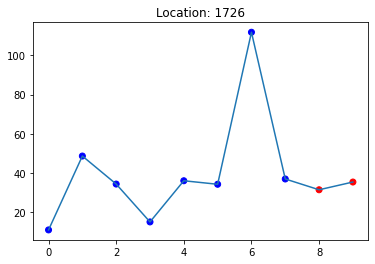

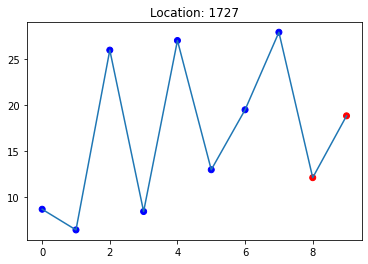

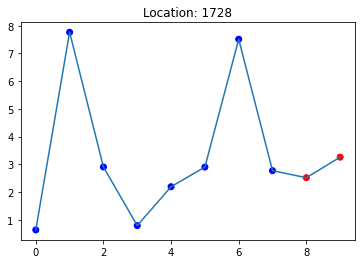

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


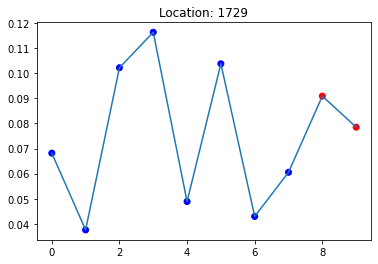

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


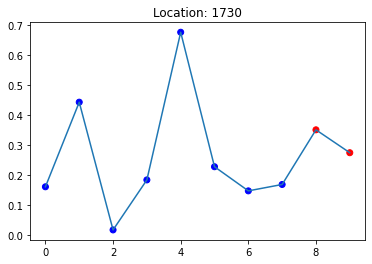

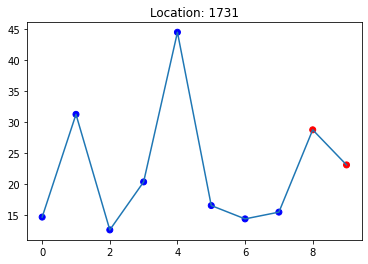

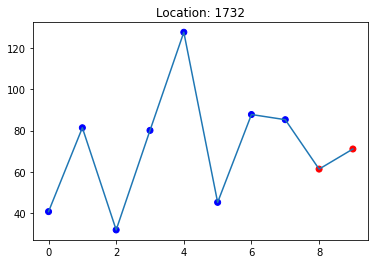

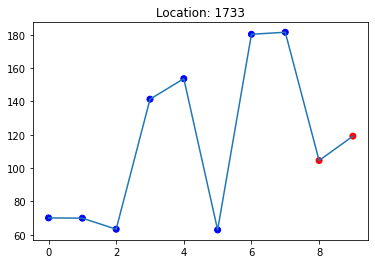

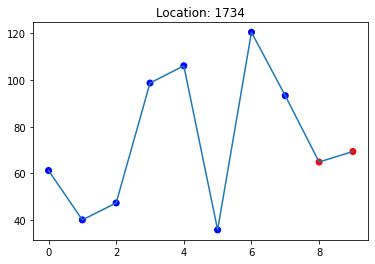

...

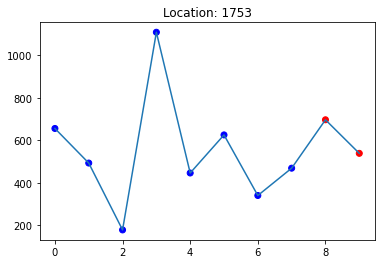

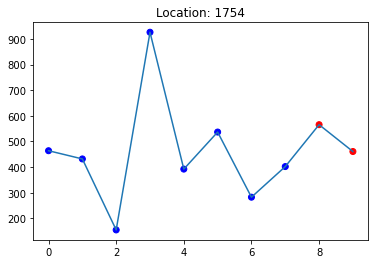

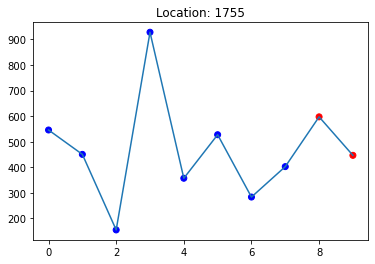

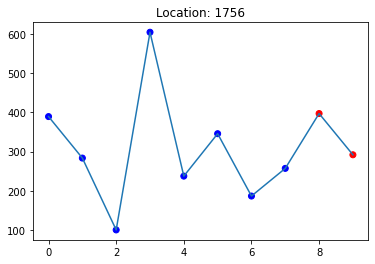

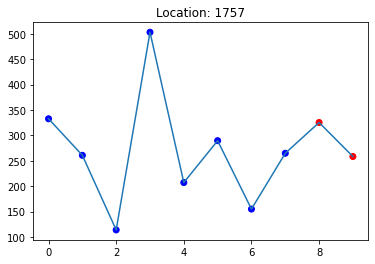

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


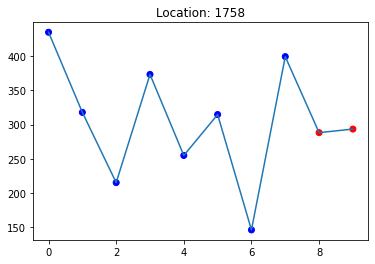

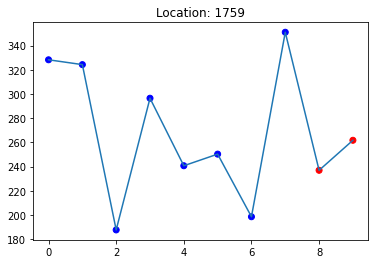

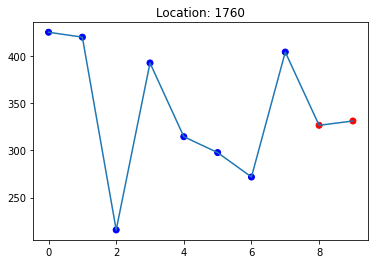

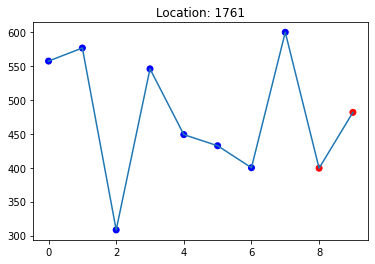

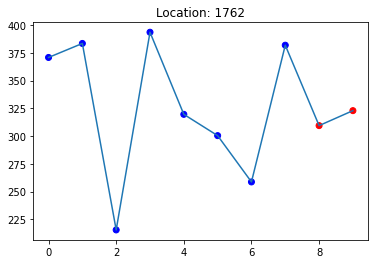

...

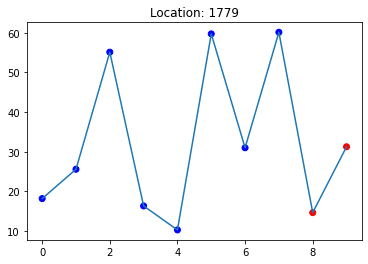

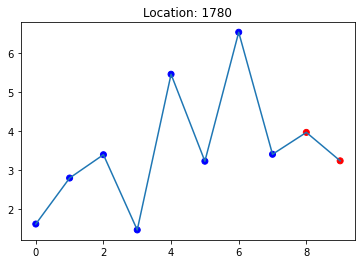

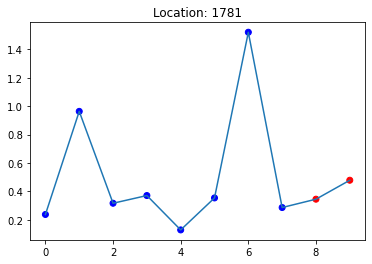

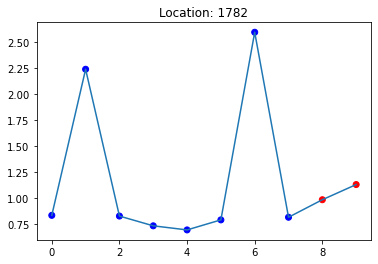

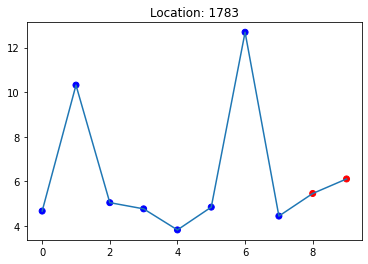

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


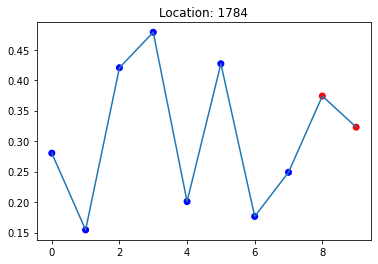

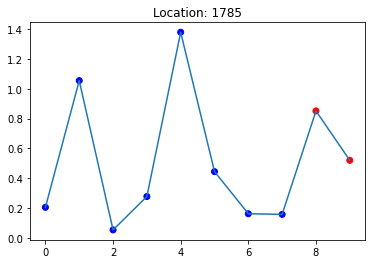

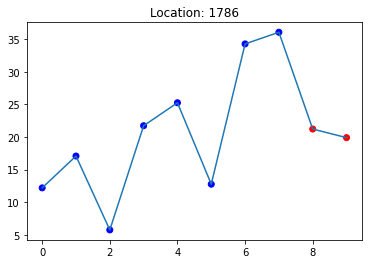

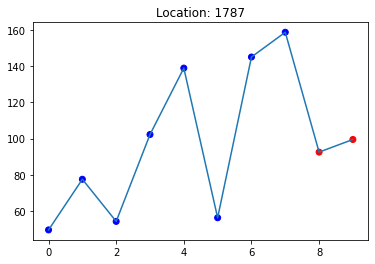

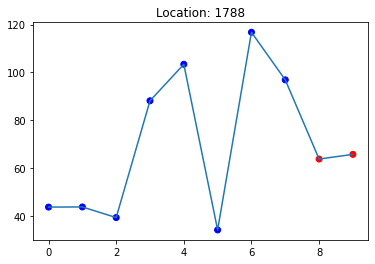

...

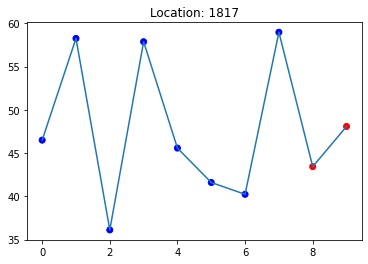

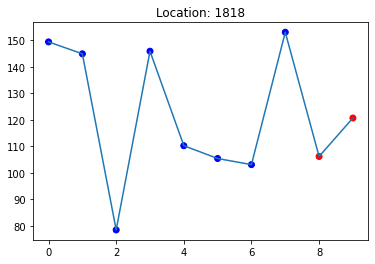

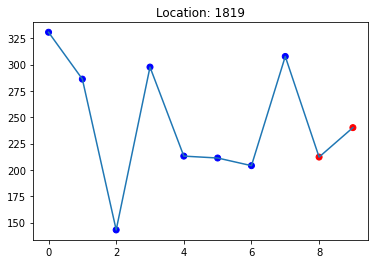

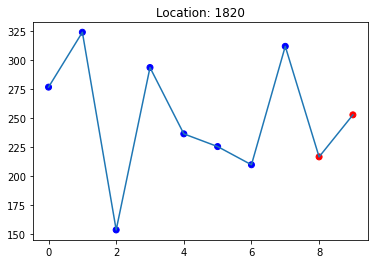

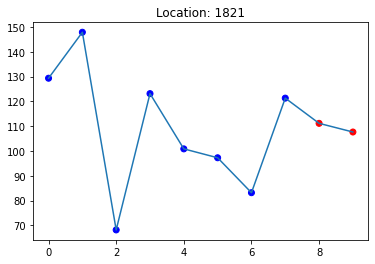

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


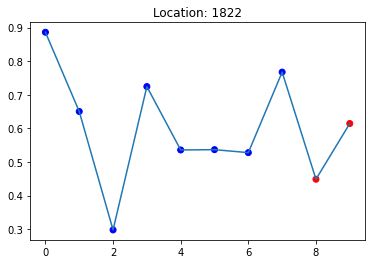

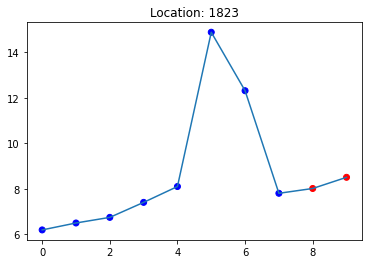

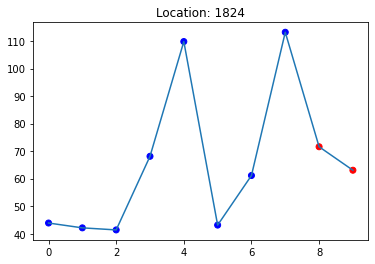

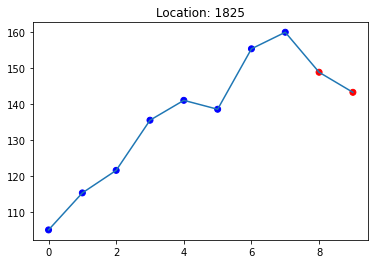

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


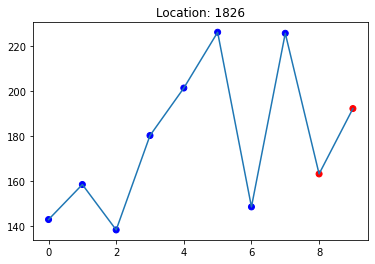

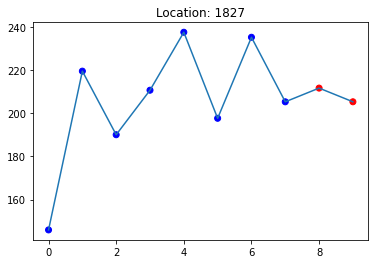

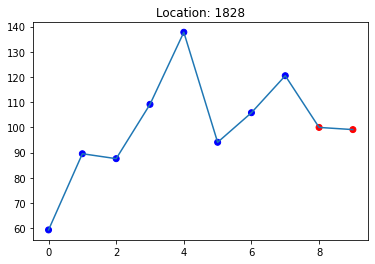

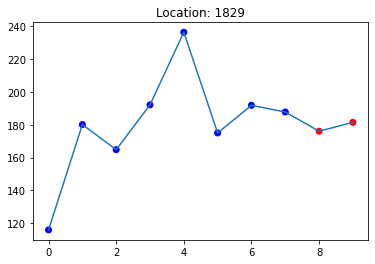

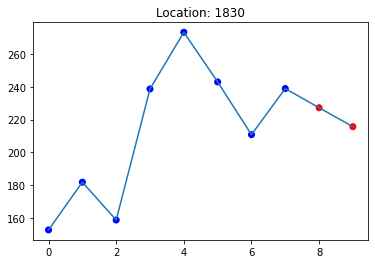

...

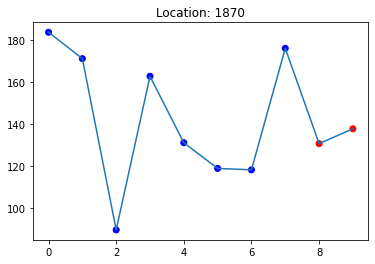

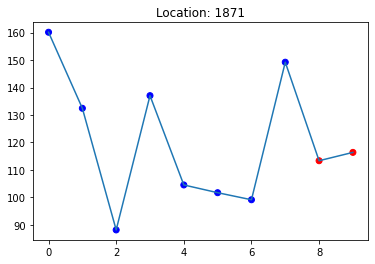

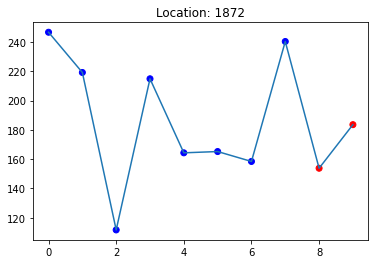

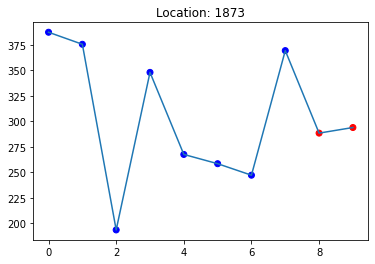

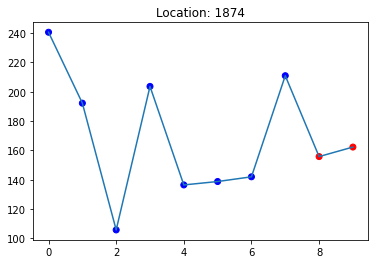

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


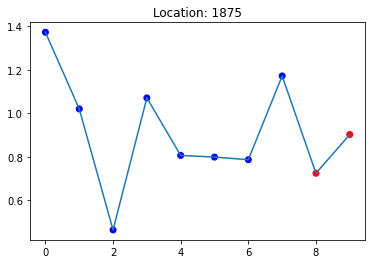

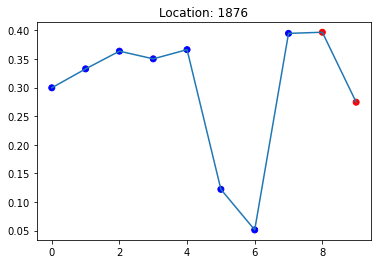

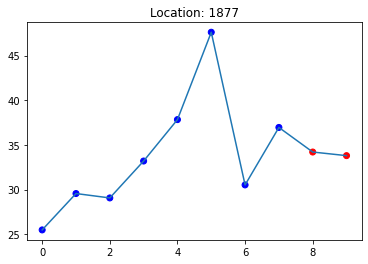

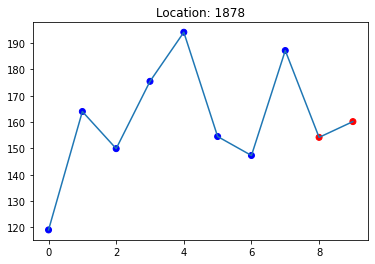

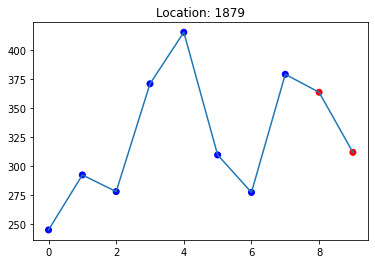

...

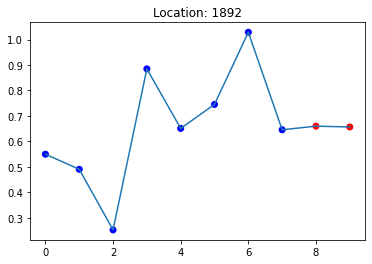

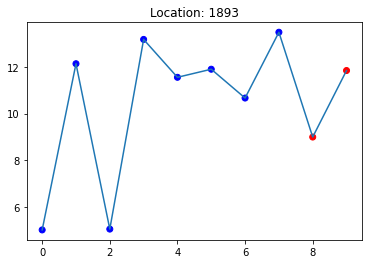

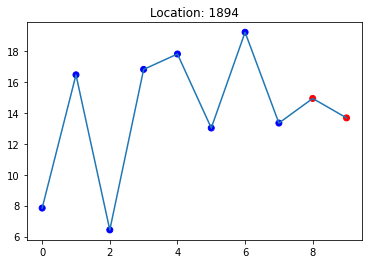

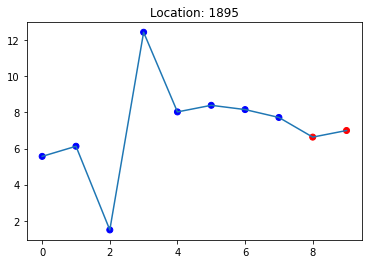

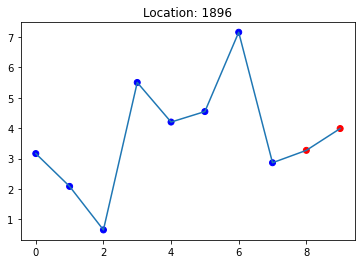

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


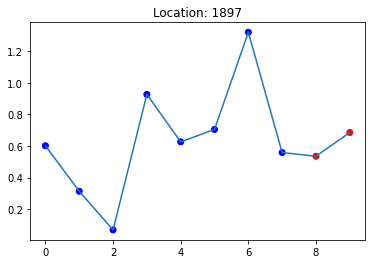

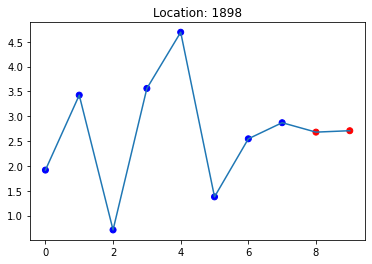

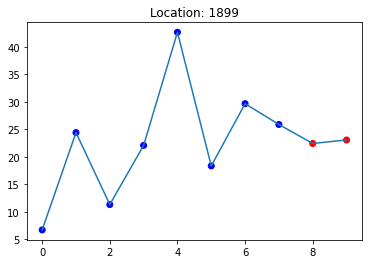

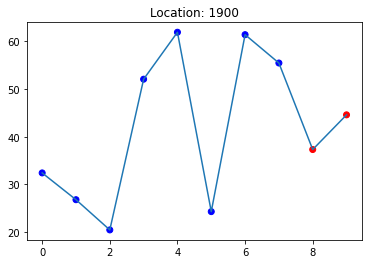

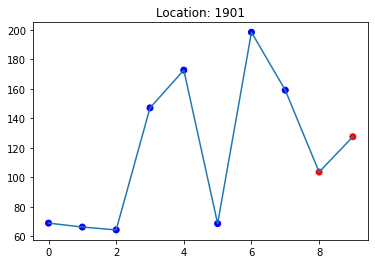

...

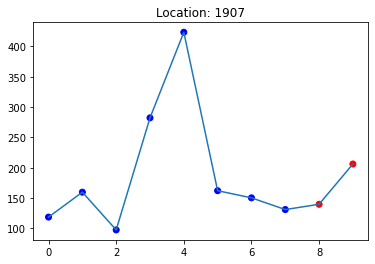

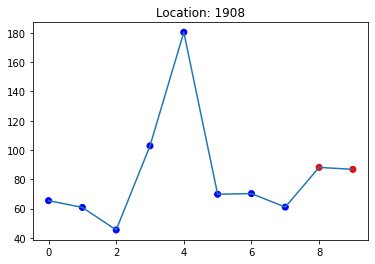

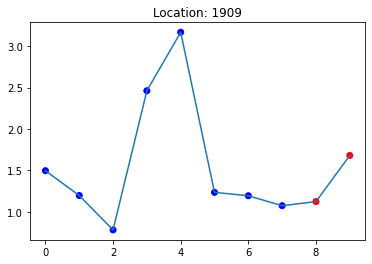

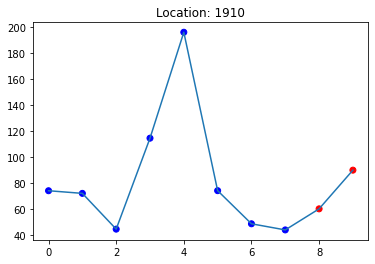

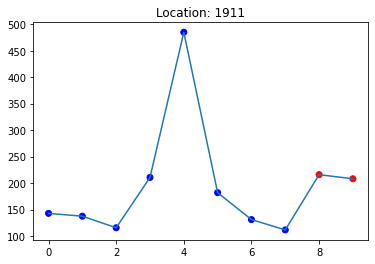

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


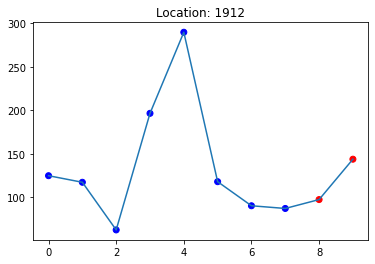

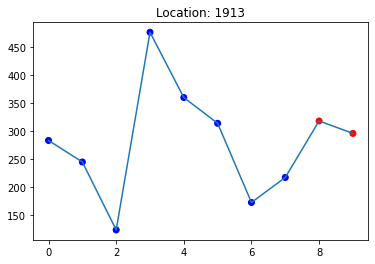

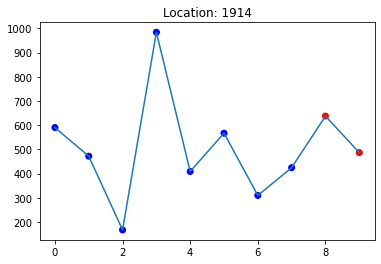

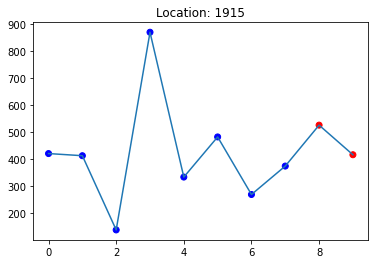

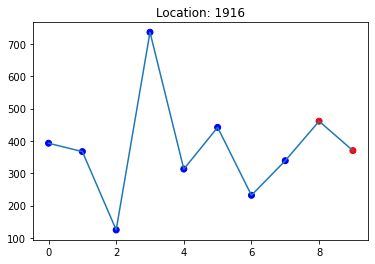

...

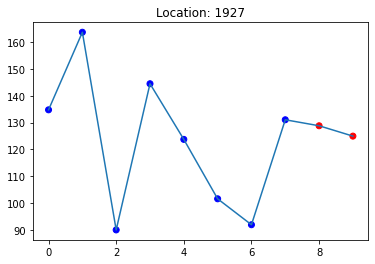

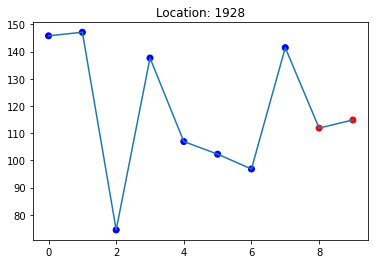

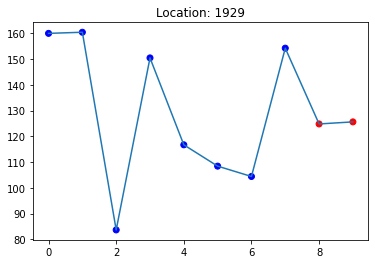

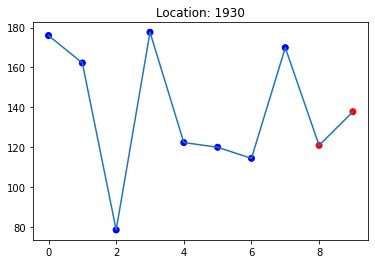

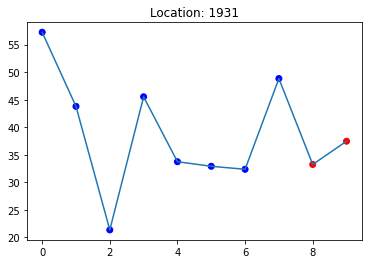

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


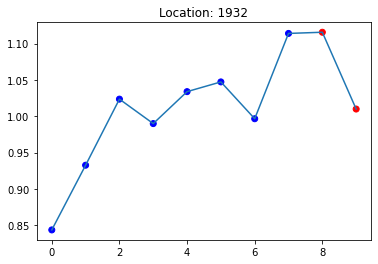

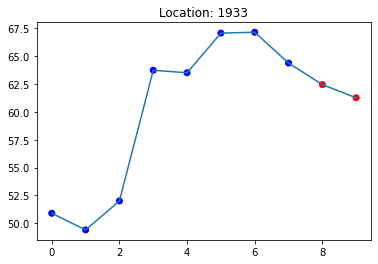

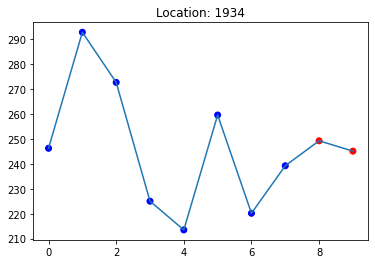

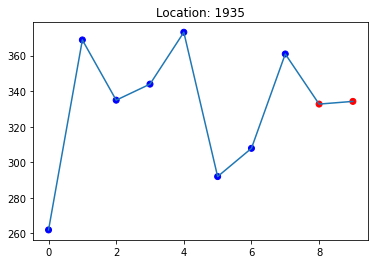

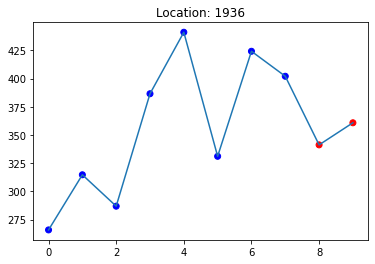

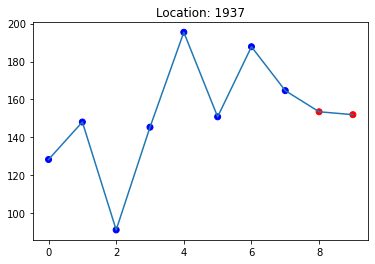

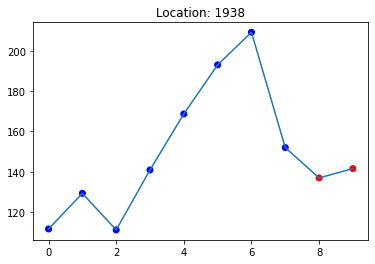

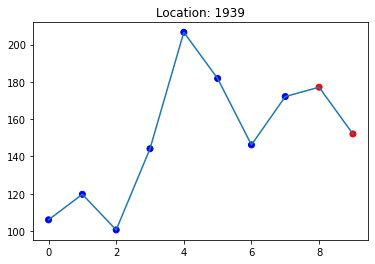

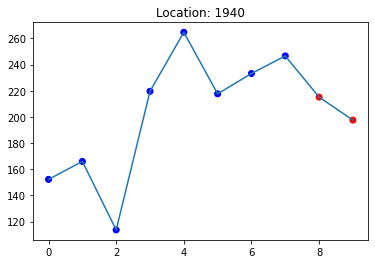

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


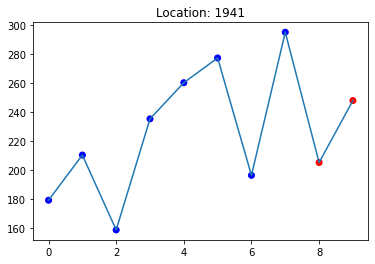

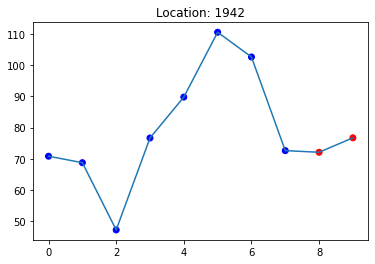

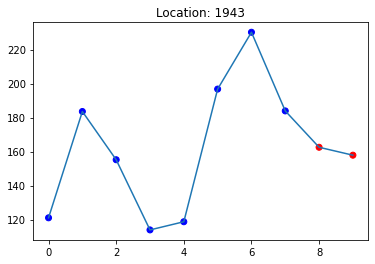

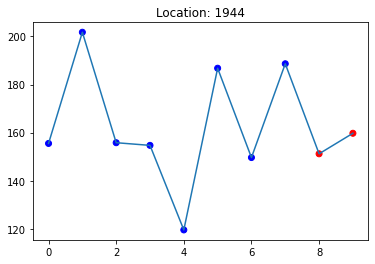

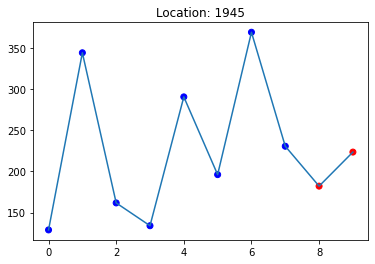

...

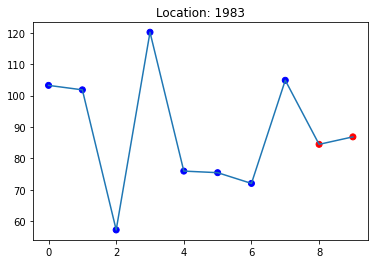

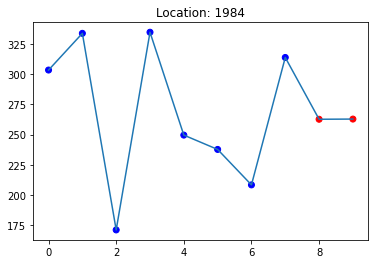

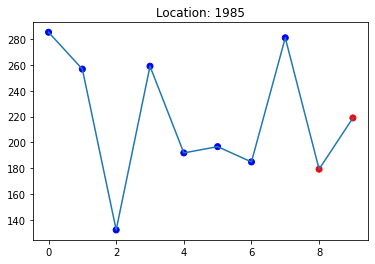

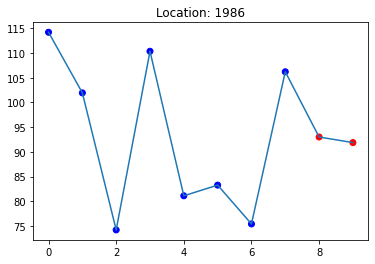

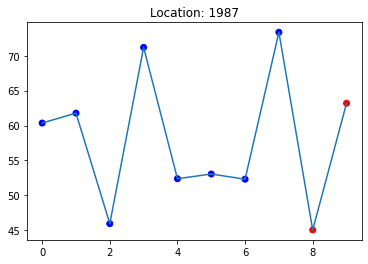

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


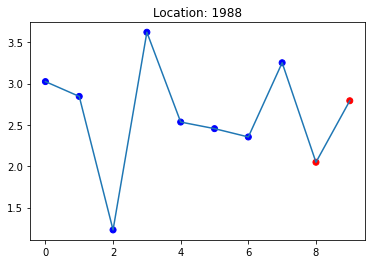

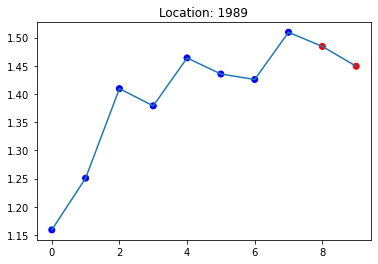

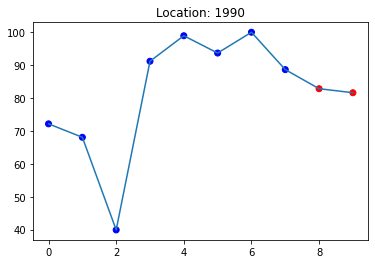

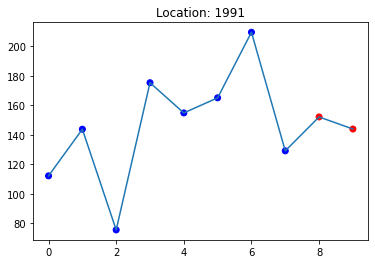

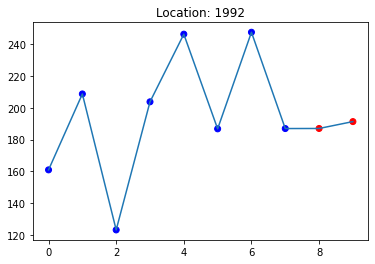

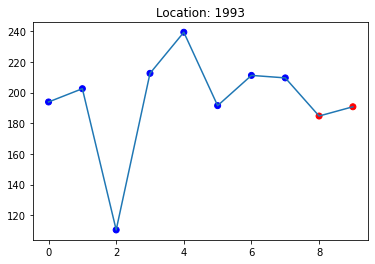

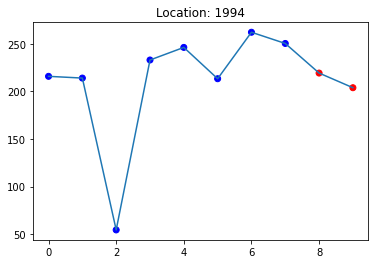

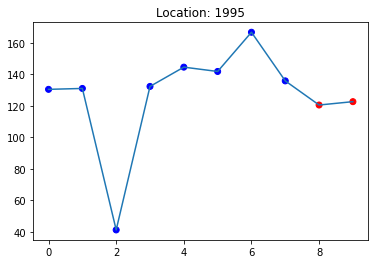

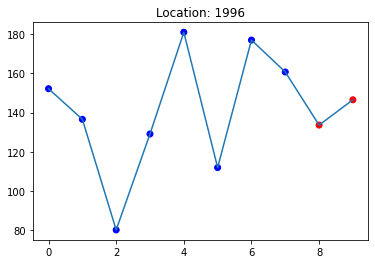

/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


/Users/arnabsaha/opt/anaconda3/lib/python3.8/site-packages/statsmodels/base/model.py:566: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [7]:
from statsmodels.tsa.arima.model import ARIMA
val_2018 = []
val_2019 = []
for loc_idx in biomass_hist_df.index.tolist():
    value = biomass_hist_df.loc[loc_idx, years].tolist()
    model=ARIMA(value,order=(1,0,1))
    model_fit=model.fit()
    output = model_fit.forecast(2)
    val_2018.append(output[0])
    val_2019.append(output[1])
    new_value = value+list(output)
    plt.title(f'Location: {loc_idx}')
    color = ['blue' if x < 8 else 'red' for x in range(len(new_value))]
    plt.plot(new_value)
    plt.scatter(range(len(new_value)), new_value, c=color)
    plt.show()

In [8]:
val_2018_mod = list(map(lambda x : abs(x), val_2018))
biomass_hist_df['2018'] = val_2018_mod
val_2019_mod = list(map(lambda x : abs(x), val_2019))
biomass_hist_df['2019'] = val_2019_mod
biomass_hist_df

,Latitude,Longitude,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,24.66818,71.33144,8.475744,8.868568,9.202181,6.023070,10.788374,6.647325,7.387925,5.180296,8.777787,6.884933
1,24.66818,71.41106,24.029778,28.551348,25.866415,21.634459,34.419411,27.361908,40.431847,42.126945,35.980930,34.142681
2,24.66818,71.49069,44.831635,66.111168,56.982258,53.003735,70.917908,42.517117,59.181629,73.203232,42.268495,67.365173
3,24.66818,71.57031,59.974419,80.821304,78.956543,63.160561,93.513924,70.203171,74.536720,101.067352,50.162314,91.238794
4,24.66818,71.64994,14.653370,19.327524,21.928144,17.899586,19.534035,19.165791,16.531315,26.086885,12.155526,24.458010
...,...,...,...,...,...,...,...,...,...,...,...,...
2413,20.15456,72.84432,5.199882,4.516778,4.321080,2.658953,5.113997,5.301668,6.419223,5.321604,4.981531,4.906012
2414,20.15456,72.92394,0.122287,0.126717,0.101494,0.111509,0.121749,0.122467,0.145785,0.120626,0.121395,0.121553
2415,20.15456,73.00357,0.039415,0.040843,0.032713,0.035941,0.039241,0.039473,0.046989,0.038879,0.039183,0.039183
2416,20.15456,73.08319,2.719220,1.370163,0.818687,1.205721,1.316443,1.324201,1.576338,1.304297,1.398251,1.373924


In [ ]:
# using the adfuller test to check the stationarity of the series
from statsmodels.tsa.stattools import adfuller
def adfuller_test(series):
    result=adfuller(series)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )

    if result[1] <= 0.05:
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data is stationary")
    else:
        print("weak evidence against null hypothesis,indicating it is non-stationary ")

In [ ]:
value = biomass_hist_df.loc[0, years].tolist()
adfuller_test(value)

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
import statsmodels.api as sm
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(value,lags=5,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(value,lags=2,ax=ax2)

In [ ]:
biomass_hist_df['2018'].sum()

In [ ]:
biomass_hist_df['2019'].sum()

In [ ]:
biomass_hist_df['2010'].sum()

In [ ]:
biomass_hist_df['2011'].sum()

In [ ]:
biomass_hist_df['2012'].sum()

In [ ]:
biomass_hist_df['2013'].sum()

In [ ]:
biomass_hist_df['2014'].sum()

In [ ]:
biomass_hist_df['2015'].sum()

In [ ]:
biomass_hist_df['2016'].sum()

In [ ]:
biomass_hist_df['2017'].sum()

In [ ]:
sample_sol_df = pd.read_csv('sample_submission.csv')

In [ ]:
sample_sol_df.to_csv('test_sol.csv')

In [10]:
plt.figure(figsize = (10,10))
plt.hist(biomass_hist_df['2019'], bins=100, density=False)
plt.title('Biomass distribution by percentage')
plt.show()

In [11]:
x = [val for val in biomass_hist_df['2019'] if val>10]

In [ ]:
len(x)

In [12]:
plt.figure(figsize = (10,10))
plt.hist(x, bins=100, density=False)
plt.title('Biomass distribution by percentage for greater than 10 unit')
plt.show()

In [ ]:
sum(x)

In [ ]:
plt.figure(figsize = (10,10))
plt.hist(df_2019_cleaned['2019'], bins=100, density=False)
plt.title('Biomass distribution by percentage')
plt.show()

In [ ]:
biomass_hist_df['2019'].sum()

In [ ]:
(sum(x) / biomass_hist_df['2019'].sum()) * 100

In [ ]:
(len(x)/biomass_hist_df['2019'].shape[0]) * 100

In [13]:
df_2019 = biomass_hist_df[['Latitude', 'Longitude', '2019']]
df_2019 = df_2019[df_2019['2019'] > 10].copy()
df_2019 = df_2019.sort_values(by='2019', ascending=False)

In [ ]:
df_2019

#### Preparing the final solution dataframe for submission
Divide the total solution into 5 parts and prepare each of the datafram. Merge all the dataframe at the end to prepare the final dataframe

In [46]:
# depot location df
depot_loc_dict = {
    'year' : [20182019] * 15,
    'data_type' : ['depot_location'] * 15,
    'source_index' : sorted(initial_centers),
    'destination_index' : [np.nan] * 15,
    'value' : [np.nan] * 15
}

depot_location_sol_df = pd.DataFrame(depot_loc_dict)

In [ ]:
depot_location_sol_df

In [47]:
# refinery location df
refinery_loc_dict = {
    'year' : [20182019] * 3,
    'data_type' : ['refinery_location'] * 3,
    'source_index' : sorted(initial_bioref_centers),
    'destination_index' : [np.nan] * 3,
    'value' : [np.nan] * 3
}

refinery_location_sol_df = pd.DataFrame(refinery_loc_dict)

In [ ]:
refinery_location_sol_df

In [48]:
# biomass forecase 2018 dataframe
#val_2018_mod = list(map(lambda x : abs(x), val_2018))
biomass_pred_2018_dict = {
    'year' : [2018] * len(val_2018),
    'data_type' : ['biomass_forecast'] * len(val_2018),
    'source_index' : biomass_hist_df.index.tolist(),
    'destination_index' : [np.nan] * len(val_2018),
    'value' : val_2018_mod
}
biomass_prep_2018_df = pd.DataFrame(biomass_pred_2018_dict)

In [ ]:
biomass_prep_2018_df

##### Biomass Demand Supply 2018

In [53]:
#index_lst_2019 = df_2019.index.tolist()
df_2018 = biomass_hist_df[['Latitude', 'Longitude', '2018']]
df_2018 = df_2018[df_2018['2018'] > 10].copy()
df_2018 = df_2018.sort_values(by='2018', ascending=False)
df_2018

,Latitude,Longitude,2018
858,22.97557,70.69444,838.008609
921,22.89497,70.69444,824.590629
1805,21.68597,71.01294,792.625222
1973,21.44416,71.09256,781.614292
1974,21.44416,71.17219,768.726652
...,...,...,...
331,23.70098,71.33144,10.456657
1026,22.81437,74.11832,10.319231
317,23.70098,68.70381,10.204062
1299,22.41137,73.64057,10.098874


In [54]:
upper_limit=20000
df_2018, cluster_dist_dict_2018, total_dist = assigning_cluster_id(upper_limit, dist_mat_df, df_2018, initial_centers, year='2018')

In [55]:
df_2018_clean = df_2018.dropna(subset=['cluster_id'])
#df_2018_clean.loc[:,'cluster_id'] = df_2018_clean['cluster_id'].astype(int)

In [56]:
df_2018_clean['2018'].sum()

299981.98890783184

In [ ]:
cluster_dist_dict_2018

In [83]:
# biomass demand supply 2018 dataframe

df_2018_clean['cluster_id'] = df_2018_clean['cluster_id'].astype('int')
source_2018 = df_2018_clean.index.tolist()
destination_2018 = list(map(lambda x : initial_centers[x], df_2018_clean['cluster_id']))
value_2018 = [biomass_hist_df.at[idx, '2018'] for idx in source_2018]
# source_2018 = source_idx_lst
# destination_2018 = destination_idx_lst
# value_2018 = value_lst
biomass_demand_suppy_2018_dict = {
    'year' : [2018] * len(source_2018),
    'data_type' : ['biomass_demand_supply'] * len(source_2018),
    'source_index' : source_2018,
    'destination_index' : destination_2018,
    'value' : value_2018
}
biomass_demand_supply_2018_df = pd.DataFrame(biomass_demand_suppy_2018_dict)

<ipython-input-83-66af379f27d0>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2018_clean['cluster_id'] = df_2018_clean['cluster_id'].astype('int')


In [ ]:
df_2018_clean['2018'].sum()

In [ ]:
biomass_demand_supply_2018_df #.groupby('destination_index').sum()

##### Pellet Demand Supply 2018

In [59]:
depot_df_2018 = df_2018.loc[initial_centers, ['Longitude','Latitude']].copy()
quant_value = [cluster_dist_dict_2018[x] for x in sorted(cluster_dist_dict_2018.keys())]
depot_df_2018['2018'] = quant_value
depot_df_2018 = depot_df_2018.sort_values(by='2018', ascending=False)

In [60]:
depot_df_2018

,Longitude,Latitude,2018
983,70.69444,22.81437,19999.991005
990,71.25181,22.81437,19999.795914
2099,73.16282,21.28296,19999.795536
500,72.92394,23.45918,19999.721021
491,72.20732,23.45918,19999.635969
2026,70.93331,21.36356,19999.440593
1606,73.16282,22.00837,19999.337606
1753,71.17219,21.76657,19999.059709
1740,70.13706,21.76657,19998.881605
1470,71.72956,22.16957,19998.670690


In [61]:
upper_limit = 100000
depot_df_2018, bioref_dist_dict_2018, total_dist = assigning_cluster_id(upper_limit, dist_mat_df, depot_df_2018, initial_bioref_centers, year='2018', process_flag = 'refinery')

In [ ]:
bioref_dist_dict_2018

In [62]:
# This is not properly formed yet for 2018
# pellet demand supply 2018 dataframe
pellet_source_loc_2018 = depot_df_2018.index.tolist()
pellet_destination_loc_2018 = list(map(lambda x : initial_bioref_centers[x], depot_df_2018['cluster_id']))
pellet_amount_2018 = [cluster_dist_dict_2018[initial_centers.index(idx)] for idx in pellet_source_loc_2018]
pellet_demand_suppy_2018_dict = {
    'year' : [2018] * len(pellet_source_loc_2018),
    'data_type' : ['pellet_demand_supply'] * len(pellet_source_loc_2018),
    'source_index' : pellet_source_loc_2018,
    'destination_index' : pellet_destination_loc_2018,
    'value' : pellet_amount_2018
}
pellet_demand_supply_2018_df = pd.DataFrame(pellet_demand_suppy_2018_dict)

In [ ]:
pellet_demand_supply_2018_df#.groupby('destination_index').sum()

In [49]:
# biomass forecase 2019 dataframe
#val_2019_mod = list(map(lambda x : abs(x), val_2019))
biomass_pred_2019_dict = {
    'year' : [2019] * len(val_2019),
    'data_type' : ['biomass_forecast'] * len(val_2019),
    'source_index' : biomass_hist_df.index.tolist(),
    'destination_index' : [np.nan] * len(val_2019),
    'value' : val_2019_mod
}
biomass_prep_2019_df = pd.DataFrame(biomass_pred_2019_dict)

In [84]:
# biomass demand supply 2019 dataframe
# df_2019_cleaned['cluster_id'] = df_2019_cleaned['cluster_id'].astype('int')
df_2019_cleaned['cluster_id'] = df_2019_cleaned['cluster_id'].astype('int')
source_2019 = df_2019_cleaned.index.tolist()
destination_2019 = list(map(lambda x : initial_centers[x], df_2019_cleaned['cluster_id']))
value_2019 = [biomass_hist_df.at[idx, '2019'] for idx in source_2019]
# source_2019 = source_idx_lst
# destination_2019 = destination_idx_lst
# value_2019 = value_lst
biomass_demand_suppy_2019_dict = {
    'year' : [2019] * len(source_2019),
    'data_type' : ['biomass_demand_supply'] * len(source_2019),
    'source_index' : source_2019,
    'destination_index' : destination_2019,
    'value' : value_2019
}
biomass_demand_supply_2019_df = pd.DataFrame(biomass_demand_suppy_2019_dict)

<ipython-input-84-266758841bc0>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2019_cleaned['cluster_id'] = df_2019_cleaned['cluster_id'].astype('int')


In [52]:
# pellet demand supply 2019 dataframe
pellet_source_loc_2019 = depot_df.index.tolist()
pellet_destination_loc_2019 = list(map(lambda x : initial_bioref_centers[x], depot_df['cluster_id']))
pellet_amount_2019 = [cluster_dist_dict[initial_centers.index(idx)] for idx in pellet_source_loc_2019]
pellet_demand_suppy_2019_dict = {
    'year' : [2019] * len(pellet_source_loc_2019),
    'data_type' : ['pellet_demand_supply'] * len(pellet_source_loc_2019),
    'source_index' : pellet_source_loc_2019,
    'destination_index' : pellet_destination_loc_2019,
    'value' : pellet_amount_2019
}
pellet_demand_supply_2019_df = pd.DataFrame(pellet_demand_suppy_2019_dict)

In [85]:
# concatenate all the dataframes together
df_lst = [depot_location_sol_df, refinery_location_sol_df, biomass_prep_2018_df, biomass_demand_supply_2018_df,\
         pellet_demand_supply_2018_df, biomass_prep_2019_df, biomass_demand_supply_2019_df,\
          pellet_demand_supply_2019_df]
final_df = pd.concat(df_lst, ignore_index=True)

In [86]:
# Save the solution 
final_df.to_csv('eleventh_solution.csv')

#### Solving the Traveling Salesman Problem

In [ ]:
cluster_10_2019_df = df_2019_cleaned[df_2019_cleaned['cluster_id']==0]
cluster_10_2019_df

In [ ]:
cluster_10_2019_df.shape

In [ ]:
all_points = cluster_10_2019_df.index.tolist()
start_pos = initial_centers[0]
all_points.remove(start_pos)
pts_covered = []
total_dist = 0
while len(all_points) > 0:
    dist_lst = [dist_mat_df.at[start_pos, str(pt)] for pt in all_points]
    min_dist = min(dist_lst)
    total_dist += min_dist
    pts_covered.append(start_pos)
    start_pos = all_points[dist_lst.index(min_dist)]
    all_points.remove(start_pos)

In [ ]:
len(pts_covered)

In [ ]:
total_dist

#### Final solution for depot 2019

In [57]:
year = '2018'
cluster_lst = df_2018_clean.cluster_id.unique().tolist()
cluster_lst_mod = list(map(lambda x : int(x), cluster_lst))
total_dist_all_cluster = 0
source_idx_lst = []
destination_idx_lst = []
value_lst = []
for cluster_idx in cluster_lst_mod:
    biomass_amount = 0
    cluster_df = df_2018_clean[df_2018_clean['cluster_id'] == cluster_idx]
    # Applying the traveling salesman problem
    all_points = cluster_df.index.tolist()
    start_pos = initial_centers[cluster_idx]
    all_points.remove(start_pos)
    pts_covered = []
    total_dist = 0
    while len(all_points) > 0:
        dist_lst = [dist_mat_df.at[start_pos, str(pt)] for pt in all_points]
        min_dist = min(dist_lst)
        total_dist += min_dist
        pts_covered.append(start_pos)
        start_pos = all_points[dist_lst.index(min_dist)]
        all_points.remove(start_pos)
    print(f'The total distance covered for cluster {cluster_idx} is {total_dist}')
    total_dist_all_cluster += total_dist
    # Preparing the final list
    pts_covered.reverse()
    source_idx_lst.append(start_pos)
    biomass_amount += biomass_hist_df.at[start_pos,year]
    for pos in pts_covered:
        destination_idx_lst.append(pos)
        source_idx_lst.append(pos)
        value_lst.append(biomass_amount)
        biomass_amount += biomass_hist_df.at[pos,year]
    destination_idx_lst.append(initial_centers[cluster_idx])
    value_lst.append(biomass_hist_df.at[initial_centers[cluster_idx],year])
print(f'The distance to cover all the points is {total_dist_all_cluster}')

The total distance covered for cluster 0 is 2094.3667
The total distance covered for cluster 1 is 1481.3373999999997
The total distance covered for cluster 2 is 1180.9149999999997
The total distance covered for cluster 3 is 2294.306400000001
The total distance covered for cluster 4 is 3038.331400000001
The total distance covered for cluster 5 is 2327.160200000001
The total distance covered for cluster 6 is 1899.2955999999995
The total distance covered for cluster 7 is 2355.5341999999987
The total distance covered for cluster 8 is 1667.2163
The total distance covered for cluster 9 is 1469.3592000000003
The total distance covered for cluster 10 is 1939.7857999999997
The total distance covered for cluster 11 is 1130.9779999999998
The total distance covered for cluster 12 is 2466.0063000000005
The total distance covered for cluster 13 is 528.7635
The total distance covered for cluster 14 is 1374.6412
The distance to cover all the points is 27247.997200000005


In [ ]:
start_pos

In [ ]:
cluster_idx

In [ ]:
df_2018_clean[df_2018_clean.index == 1037]

In [ ]:
df_2018[df_2018.index == 1037]

In [73]:
initial_centers

[990,
 491,
 1470,
 2099,
 1392,
 500,
 1740,
 1126,
 983,
 1606,
 1169,
 2035,
 175,
 1753,
 2026]

In [67]:
depot_2018 = biomass_demand_supply_2018_df.destination_index.tolist()
for ele in depot_2018:
    if ele > 2417:
        print(ele)

In [81]:
df_2019_cleaned['cluster_id'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14])

In [80]:
df_2019_cleaned['cluster_id'] = df_2019_cleaned['cluster_id'].astype('int')
destination_2019 = list(map(lambda x : mod_centers[x], df_2019_cleaned['cluster_id']))

<ipython-input-80-871f33ea2996>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2019_cleaned['cluster_id'] = df_2019_cleaned['cluster_id'].astype('int')


In [79]:
mod_centers

[990,
 491,
 1470,
 2099,
 1392,
 500,
 1740,
 1126,
 983,
 1606,
 1169,
 2035,
 175,
 1753,
 2026]